# Individual distance calculation

In [269]:
import os, sys, getopt
import numpy as np
import nibabel as nib
from nibabel import gifti
import networkx as nx
import gdist
from surfdist.utils import surf_keep_cortex, translate_src

In [2]:
# location of marsAtlas template:
cdir = '../topography/data/'
# location of BV database:
bvdir = '../../02_data/'
# location of output directory:
directory = '.'

In [5]:
def graphNeighbors(vertices, triangles):
    '''
    read cortical surface into graph format using networkx
    and extract list of neighbors for each vertex
    '''

    G1=nx.Graph()
    G1.add_nodes_from(range(len(vertices)))
    G1.add_edges_from(triangles[:,[0,1]])
    G1.add_edges_from(triangles[:,[0,2]])
    G1.add_edges_from(triangles[:,[1,2]])

    neighbors = []
    for x in xrange(len(vertices)):
        neighbors.append(list(G1[x]))

    return G1, neighbors

def getMarsGraph(hemi):
    '''
    read marsAtlas into graph where nodes are parcel labels and
    edges represent spatially adjacent parcels.
    '''

    G2 = nx.Graph()
    marsRaw = gifti.giftiio.read(cdir + 'hiphop138-Template/hiphop138_' + hemi + 'white_parcels_marsAtlas.gii')
    marsT = np.array(marsRaw.darrays[0].data, dtype=np.float64)
    G2.add_nodes_from(marsT)
    
    surf_img_T = gifti.giftiio.read(cdir + 'hiphop138-Template/hiphop138_' + hemi + 'white.gii')
    verticesT = np.array(surf_img_T.darrays[0].data, dtype=np.float64) 
    trianglesT = np.array(surf_img_T.darrays[1].data, dtype=np.int32) 

    G2.add_edges_from(marsT[trianglesT[:,[0,1]]])
    G2.add_edges_from(marsT[trianglesT[:,[0,2]]])
    G2.add_edges_from(marsT[trianglesT[:,[1,2]]])

    return G2

def getModelsGraph(hemi):
    '''
    read marsAtlas into graph where nodes are parcel labels and
    edges represent spatially adjacent parcels.
    '''
    import sys
    sys.path.append('/Applications/brainvisa/python/')
    from soma import aims

    G2 = nx.Graph()
    marsRaw = aims.read('Sub0009_%swhite_parcels_model.gii.tex' % hemi)
    marsT = np.squeeze(np.asarray(marsraw, dtype=np.float64))
    G2.add_nodes_from(marsT)
    
    surf_img_T = aims.read('Sub0009_%swhite.mesh' % hemi)
    verticesT = np.array(surf_img_T.darrays[0].data, dtype=np.float64) 
    trianglesT = np.array(surf_img_T.darrays[1].data, dtype=np.int32) 

    G2.add_edges_from(marsT[trianglesT[:,[0,1]]])
    G2.add_edges_from(marsT[trianglesT[:,[0,2]]])
    G2.add_edges_from(marsT[trianglesT[:,[1,2]]])

    return G2

In [133]:
print sys.path
sys.path.remove('/Applications/brainvisa-4.5/python/aims/')

['/Applications/brainvisa/python/soma/', '/Applications/brainvisa/python/soma/', '/Applications/brainvisa/python/soma/', '/Applications/brainvisa/python/soma/', '/Applications/brainvisa/python/', '/Applications/brainvisa/python/soma/', '/Applications/brainvisa/python/', '/Applications/brainvisa/python/soma/', '/Applications/brainvisa/python/aims/', '', '/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/hcp_corr-0.0.1-py2.7.egg', '/Applications/miniconda3/envs/topography/lib/python27.zip', '/Applications/miniconda3/envs/topography/lib/python2.7', '/Applications/miniconda3/envs/topography/lib/python2.7/plat-darwin', '/Applications/miniconda3/envs/topography/lib/python2.7/plat-mac', '/Applications/miniconda3/envs/topography/lib/python2.7/plat-mac/lib-scriptpackages', '/Applications/miniconda3/envs/topography/lib/python2.7/lib-tk', '/Applications/miniconda3/envs/topography/lib/python2.7/lib-old', '/Applications/miniconda3/envs/topography/lib/python2.7/lib-dynload', '/Use

ValueError: list.remove(x): x not in list

In [6]:
Gx = getModelsGraph('L')

ImportError: dlopen(/Applications/brainvisa/python/soma/aims/aimssip.so, 2): no suitable image found.  Did find:
	/Applications/brainvisa/python/soma/aims/aimssip.so: mach-o, but wrong architecture

In [4]:
#import brewer2mpl
#cmap = brewer2mpl.get_map('Paired', 'qualitative', 12).mpl_colors
cmap = 'jet'

In [5]:
marsLnorm = marsL.copy()
marsLnorm[np.where(marsLnorm == 255.0)[0]] = 0
marsLnorm = marsLnorm / marsLnorm.max()
marsLnorm = marsLnorm - marsLnorm.mean()

mars_ids_Lnorm = mars_ids_L.copy()
mars_ids_Lnorm[np.where(mars_ids_Lnorm == 255.0)[0]] = 0
mars_ids_Lnorm = mars_ids_Lnorm / marsLnorm.max()
mars_ids_Lnorm = mars_ids_Lnorm - marsLnorm.mean()

NameError: name 'marsL' is not defined

In [6]:
plot_surf_stat_map(coords=verticesL, faces=trianglesL, stat_map=marsLnorm,
                       elev=180, azim=180, figsize=(15,10),
                       cmap=cmap,
                       threshold=None, 
                       bg_map=sulcL, bg_on_stat=True,
                       alpha='auto', symmetric_cbar=False, 
                       mask=cortL, lenient=True, label=True)

plot_surf_stat_map(coords=verticesL, faces=trianglesL, stat_map=marsLnorm,
                       elev=180, azim=0, figsize=(15,10),
                       cmap=cmap,
                       threshold=None, 
                       bg_map=sulcL, bg_on_stat=True,
                       alpha='auto', symmetric_cbar=False, 
                       mask=cortL, lenient=True, label=True)

NameError: name 'plot_surf_stat_map' is not defined

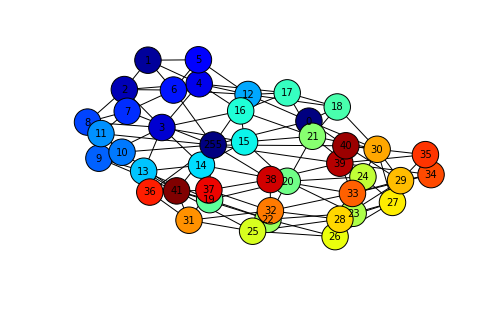

In [16]:
hemi = 'L'
# get graph of which parcels in marsAtlas are adjacent. 
# Nodes are parcel labels, edges represent spatial adjacency
G = getMarsGraph(hemi)
G_labels = dict(zip(G.nodes(),[int(y) for y in G.nodes()]))
H = nx.relabel_nodes(G, G_labels)
pos = nx.spring_layout(H)
nx.draw(H, pos, cmap=plt.get_cmap('jet'), node_color=mars_ids_Lnorm, node_size=700, 
        with_labels=True, font_size=10)
plt.show()

In [7]:
subject = 'Sub0100'

'''
Function to run full distance analysis on an individual hemisphere.
hemi: should be 'L' or 'R'
'''

# get marsAtlas and surface from individual hemisphere:
marsraw = gifti.giftiio.read(bvdir + subject + '/t1mri/default_acquisition/default_analysis/segmentation/mesh/surface_analysis/' + subject + '_' + hemi + 'white_parcels_marsAtlas.gii')
mars = np.array(marsraw.darrays[0].data, dtype=np.float64)

surf_img = gifti.giftiio.read(bvdir + subject + '/t1mri/default_acquisition/default_analysis/segmentation/mesh/' + subject + '_' + hemi + 'white.gii') 
vertices = np.array(surf_img.darrays[1].data, dtype=np.float64) 
triangles = np.array(surf_img.darrays[0].data, dtype=np.int32) 
if len(vertices) > len(triangles):
    vertices = np.array(surf_img.darrays[0].data, dtype=np.float64) 
    triangles = np.array(surf_img.darrays[1].data, dtype=np.int32) 

cortex = np.where(mars != 0)[0] 
# also possible with: nib.freesurfer.io.read_label()#....lh or rh cortex...)

# Create graph from individual surface and get neighbors of each vertex:
GS, neighborsS = graphNeighbors(vertices, triangles)

NameError: name 'hemi' is not defined

In [18]:
# Create graph Gv, where nodes are from the individual surface as well as 
# marsAtlas parcel labels, and edges connect each surface vertex to the 
# parcel labels it is adjacent to. This will be used to find the borders:
Gv=nx.Graph()
Gv.add_nodes_from(range(len(vertices)))
for i in xrange(len(vertices)):
    for j in np.unique(mars[neighborsS[i]]):
        Gv.add_edge(i,j)

In [21]:
# Create the list of point pairs for calculating geodesic distance:
distlist = []
edgelist = []
fulllist = []
check = []

for e in G.edges():

    # for each pair of neighboring parcels in the marsAtlas template:
    y = e[0]
    x = e[1]

    if x != y:

        # find set of vertices on the individual surface that are along 
        # the edge shared by the neighboring two parcels-of-interest:
        # (This is how the marsAtlas is brought to the individual-level, 
        # and how the distlist remains in the same order across subjects)
        matched = set(Gv[y]) & set(Gv[x])
        # sort and add to edgelist:
        edgelist.append(list(np.sort((y,x))))

        # If edge is less than 20 vertices total, 
        # do not include in calculation:
        if len(matched) > 20:       
            # extract edge vertices from individual surface mesh:
            H = GS.subgraph(matched)
            # find the vertices constituting the largest continuous
            # connected patch of the mesh: (to ensure there aren't stray vertices)
            subclust = sorted(nx.connected_components(H), key=len, reverse=True)
            # extract largest patch of continuous vertices as a graph:
            I = GS.subgraph(subclust[0])
            fulllist.append(subclust[0])
            # find end-points of that patch:
            J = nx.spectral_ordering(I)
            # add those end nodes to distlist:
            distlist.append(np.array((J[0], J[-1])))            
            # distlist now contains the two nodes furtherest away from each
            # other on the individual brain that share the same two neighboring 
            # parcel labels
        else:
            # However, if the edges along parcels are shorter than 20 nodes 
            # maintain position in list as zeros to facilitate interindividual 
            # comparison later:
            distlist.append(np.array((0,0)))
            fulllist.append([0])

In [23]:
## Exact geodesic distance calculation on the individual surface:

# Remove medial wall from individual surface:
surf = []
surf.append(vertices)
surf.append(triangles)
vert, tri = surf_keep_cortex(surf, cortex)

# Compute distance for each node pair from distlist:
distvals = np.zeros(len(distlist))
for n,x in enumerate(distlist):
    # skip if node values are both equal to zero (place holder above)
    if x[0] + x[1] != 0:
        # translate vertex position from original surface to vertex location
        # in surface without medial wall (which is used here to avoid paths
        # traversing medial wall in distance calculation)
        src_new = translate_src(x[0], cortex)
        trg_new = translate_src(x[1], cortex)
        if len(src_new) + len(trg_new) == 2:
            distvals[n] = gdist.compute_gdist(vert, tri,
                                      source_indices=src_new, 
                                      target_indices=trg_new)

KeyboardInterrupt: 

In [ ]:
# Individual surface:
mars1 = mars.copy()
mars1[np.where(mars1 == 255.0)[0]] = 0
mars1 = mars1 / mars1.max()
mars1 = mars1 - mars1.mean()

plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=mars1,
                       elev=180, azim=180, figsize=(15,10),
                       cmap=cmap,
                       bg_on_stat=False,
                       threshold=None, 
                       alpha='auto', symmetric_cbar=False, 
                       mask=cortex, lenient=True, label=True)

plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=mars1,
                       elev=180, azim=0, figsize=(15,10),
                       cmap=cmap,
                       bg_on_stat=False,                   
                       threshold=None, 
                       alpha='auto', symmetric_cbar=False, 
                       mask=cortex, lenient=True, label=True)

In [32]:
print distlist[25]
print edgelist[25]

[55244 34741]
[5.0, 12.0]


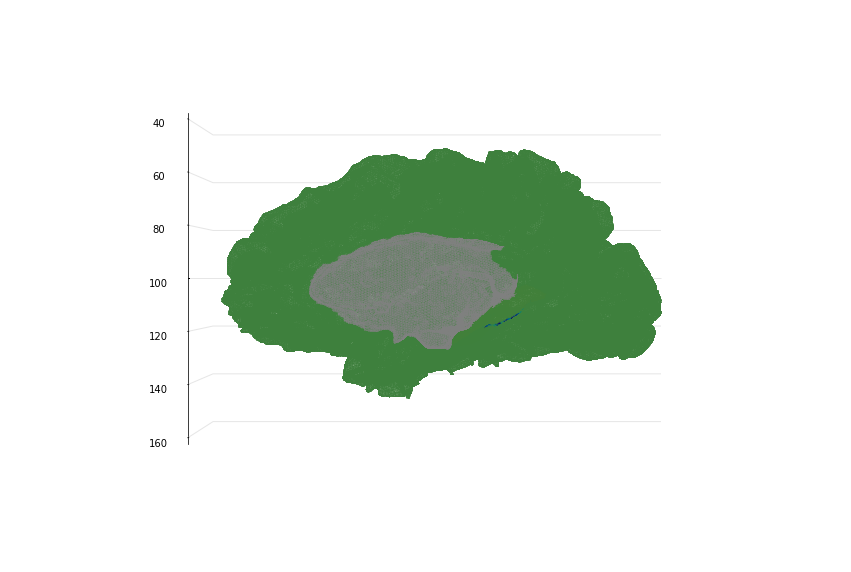

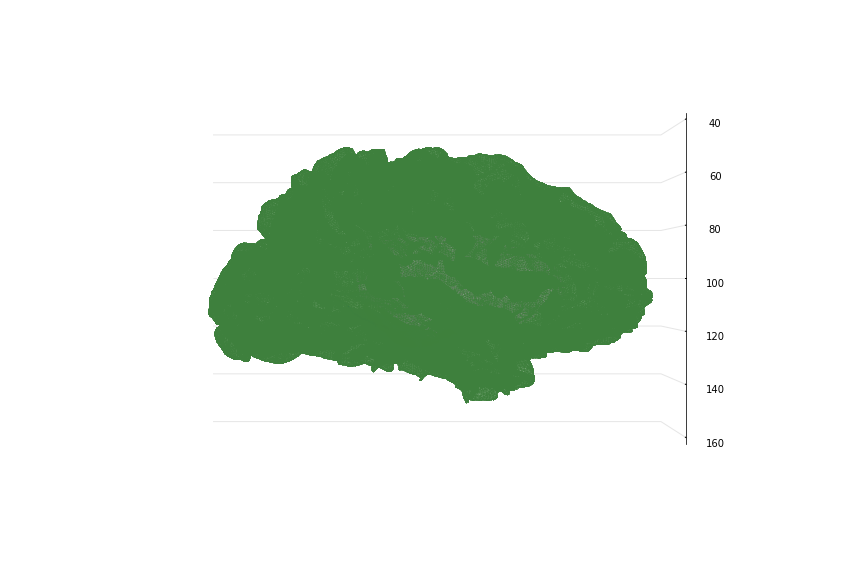

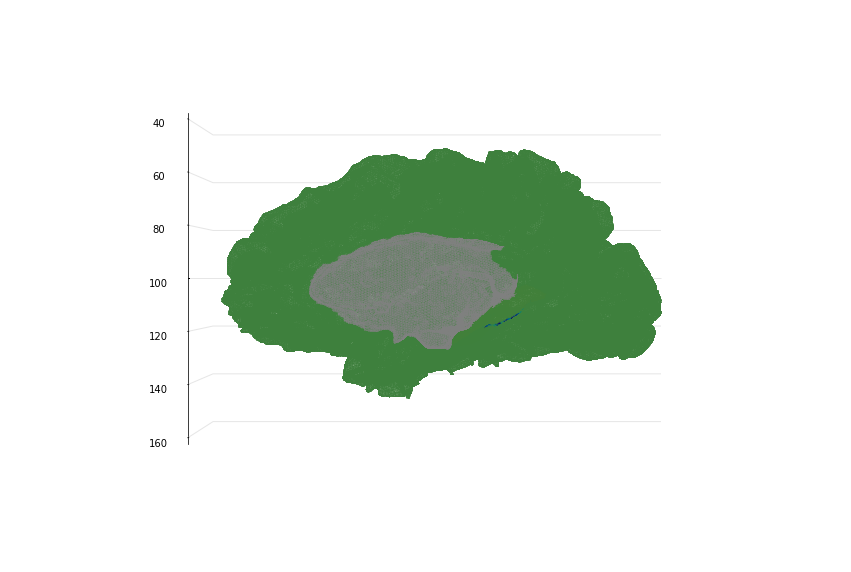

In [43]:
m = np.zeros(mars1.copy().shape)
for n,i in enumerate(edgelist[25]):
    m[np.where(mars == i)[0]] = (n+1)/2
for i in fulllist[25]:
    m[i] = m.min() - 1

plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=m,
                       elev=180, azim=180, figsize=(15,10),
                       cmap=cmap,
                       bg_on_stat=False,
                       threshold=None, 
                       alpha='auto', symmetric_cbar=False, 
                       mask=cortex, lenient=True, label=True)

plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=m,
                       elev=180, azim=0, figsize=(15,10),
                       cmap=cmap,
                       bg_on_stat=False,                   
                       threshold=None, 
                       alpha='auto', symmetric_cbar=False, 
                       mask=cortex, lenient=True, label=True)

In [28]:
elist = np.flatten(edgelist[25], Gv[edgelist[25][0]], Gv[edgelist[25][1]])
#J = Gv.subgraph(elist)
#J.add_edges_from(Gv.edges([edgelist[25][0]]))
#J.add_edges_from(Gv.edges([edgelist[25][1]]))
#pos = nx.spring_layout(J)
#nx.draw(J,pos)
np.shape(elist)

AttributeError: 'module' object has no attribute 'flatten'

In [ ]:
# Save results to .npz format
subname = subject
filename = str(directory + subname + '.' + hemi + '.distvals')
np.savez(filename, distvals=distvals, edgelist=edgelist, distlist=distlist)

# example of how to load output:
# distvals = np.load('test.distvals.npz')['distvals']

In [ ]:
# runDist(subject, hemi)

# Group-level stats

In [270]:
%matplotlib inline
import os
import pandas as pd
from pandas import DataFrame
import statsmodels.formula.api as sm
import scipy, scipy.stats as ss
import matplotlib.pyplot as plt
import numpy as np
import nibabel as nib
from nibabel import gifti
import shutil
import networkx as nx
import seaborn as sns

In [271]:
'''
Functions for plotting surfaces with pure python code.
Reduced version of nilearn surface plotting:
https://github.com/juhuntenburg/nilearn/tree/enh/surface_plotting

Helper function for symmetric colormap is copied from nilearn.
'''

def plot_surf_stat_map(coords, faces, stat_map=None,
                       elev=0, azim=0,
                       cmap='coolwarm',
                       threshold=None, bg_map=None,
                       bg_on_stat=False,
                       alpha='auto',
                       darkness=1,
                       vmax=None, symmetric_cbar="auto",
                       figsize=None,
                       labels=None, label_cpal=None,
                       mask=None, mask_lenient=None,
                       **kwargs):

    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.tri as tri
    from mpl_toolkits.mplot3d import Axes3D
    # import seaborn as sns

    # load mesh and derive axes limits
    faces = np.array(faces, dtype=int)
    limits = [coords.min(), coords.max()]

    # set alpha if in auto mode
    if alpha == 'auto':
        if bg_map is None:
            alpha = .5
        else:
            alpha = 1

    # if cmap is given as string, translate to matplotlib cmap
    if type(cmap) == str:
        cmap = plt.cm.get_cmap(cmap)

    # initiate figure and 3d axes
    if figsize is not None:
        fig = plt.figure(figsize=figsize)
    else:
        fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d', xlim=limits, ylim=limits)
    ax.view_init(elev=elev, azim=azim)
    ax.set_axis_off()

    # plot mesh without data
    p3dcollec = ax.plot_trisurf(coords[:, 0], coords[:, 1], coords[:, 2],
                                triangles=faces, linewidth=0.,
                                antialiased=False,
                                color='white')

    # where mask is indices of nodes to include:
    if mask is not None:    
        cmask = np.zeros(len(coords))
        cmask[mask] = 1
        cutoff = 2 # include triangles in cortex only if ALL nodes in mask
        if mask_lenient: # include triangles in cortex if ANY are in mask
            cutoff = 0
        fmask = np.where(cmask[faces].sum(axis=1) > cutoff)[0]

    # If depth_map and/or stat_map are provided, map these onto the surface
    # set_facecolors function of Poly3DCollection is used as passing the
    # facecolors argument to plot_trisurf does not seem to work
    if bg_map is not None or stat_map is not None:

        face_colors = np.ones((faces.shape[0], 4))
        face_colors[:, :3] = .5*face_colors[:, :3]

        if bg_map is not None:
            bg_data = bg_map
            if bg_data.shape[0] != coords.shape[0]:
                raise ValueError('The bg_map does not have the same number '
                                 'of vertices as the mesh.')
            bg_faces = np.mean(bg_data[faces], axis=1)
            bg_faces = bg_faces - bg_faces.min()
            bg_faces = bg_faces / bg_faces.max()
            bg_faces *= darkness
            face_colors = plt.cm.gray_r(bg_faces)

        # modify alpha values of background
        face_colors[:, 3] = alpha*face_colors[:, 3]

        if stat_map is not None:
            stat_map_data = stat_map
            stat_map_faces = np.max(stat_map_data[faces], axis=1)

            # Call _get_plot_stat_map_params to derive symmetric vmin and vmax
            # And colorbar limits depending on symmetric_cbar settings
            cbar_vmin, cbar_vmax, vmin, vmax = \
                _get_plot_stat_map_params(stat_map_faces, vmax,
                                          symmetric_cbar, kwargs)

            if threshold is not None:
                kept_indices = np.where(abs(stat_map_faces) >= threshold)[0]
                stat_map_faces = stat_map_faces - vmin
                stat_map_faces = stat_map_faces / (vmax-vmin)
                if bg_on_stat:
                    face_colors[kept_indices] = cmap(stat_map_faces[kept_indices]) * face_colors[kept_indices]
                else:
                    face_colors[kept_indices] = cmap(stat_map_faces[kept_indices])
            else:
                stat_map_faces = stat_map_faces - vmin
                stat_map_faces = stat_map_faces / (vmax-vmin)
                if bg_on_stat:
                    if mask is not None:
                        face_colors[fmask] = cmap(stat_map_faces)[fmask] * face_colors[fmask]
                    else:
                        face_colors = cmap(stat_map_faces) * face_colors
                else:
                    if mask is not None:
                        face_colors[fmask] = cmap(stat_map_faces)[fmask] * face_colors[fmask]
                    else:
                        face_colors = cmap(stat_map_faces)
        '''
        if labels is not None:
            
            labels requires a tuple of label/s, each a list/array of node indices
            ----------------------------------------------------------------------
            color palette for labels
            if label_cpal is None, outlines will be black
            if it's a color palette name, a different color for each label will be generated
            if it's a list of rgb or color names, these will be used
            valid color names from http://xkcd.com/color/rgb/
            
            if label_cpal is not None:
                if type(label_cpal) == str:
                    cpal = sns.color_palette(label_cpal, len(labels))
                if type(label_cpal) == list:
                    if len(label_cpal) < len(labels):
                        raise ValueError('There are not enough colors in the color list.')
                    try:
                        cpal = sns.color_palette(label_cpal)
                    except:
                        cpal = sns.xkcd_palette(label_cpal)

            for n_label, label in enumerate(labels):
                for n_face, face in enumerate(faces):
                    count = len(set(face).intersection(set(label)))
                    if (count > 0) & (count < 3):
                        if label_cpal is None:
                            face_colors[n_face,0:3] = sns.xkcd_palette(["black"])[0]
                        else:
                            face_colors[n_face,0:3] = cpal[n_label]
        '''
        p3dcollec.set_facecolors(face_colors)

    return fig


def _get_plot_stat_map_params(stat_map_data, vmax, symmetric_cbar, kwargs,
    force_min_stat_map_value=None):
    import numpy as np
    """ Internal function for setting value limits for plot_stat_map and
    plot_glass_brain.
    The limits for the colormap will always be set to range from -vmax to vmax.
    The limits for the colorbar depend on the symmetric_cbar argument, please
    refer to docstring of plot_stat_map.
    """
    # make sure that the color range is symmetrical
    if vmax is None or symmetric_cbar in ['auto', False]:
        # Avoid dealing with masked_array:
        if hasattr(stat_map_data, '_mask'):
            stat_map_data = np.asarray(
                    stat_map_data[np.logical_not(stat_map_data._mask)])
        stat_map_max = np.nanmax(stat_map_data)
        if force_min_stat_map_value == None:
            stat_map_min = np.nanmin(stat_map_data)
        else:
            stat_map_min = force_min_stat_map_value
    if symmetric_cbar == 'auto':
        symmetric_cbar = stat_map_min < 0 and stat_map_max > 0
    if vmax is None:
        vmax = max(-stat_map_min, stat_map_max)
    if 'vmin' in kwargs:
        raise ValueError('this function does not accept a "vmin" '
            'argument, as it uses a symmetrical range '
            'defined via the vmax argument. To threshold '
            'the map, use the "threshold" argument')
    vmin = -vmax
    if not symmetric_cbar:
        negative_range = stat_map_max <= 0
        positive_range = stat_map_min >= 0
        if positive_range:
            cbar_vmin = 0
            cbar_vmax = None
        elif negative_range:
            cbar_vmax = 0
            cbar_vmin = None
        else:
            cbar_vmin = stat_map_min
            cbar_vmax = stat_map_max
    else:
        cbar_vmin, cbar_vmax = None, None
    return cbar_vmin, cbar_vmax, vmin, vmax

'''
def plot_surf_label(coords, faces,
                    labels=None,
                    elev=0, azim=0,
                    cpal='bright',
                    threshold=None,
                    bg_map=None,
                    bg_on_labels=False,
                    alpha='auto',
                    darkness=1, 
                    figsize=None,
                    **kwargs):


    - labels requires a tuple of label/s, each a list/array of node indices
    - cpal takes either the name of a seaborn color palette or matplotlib color map,
      or a list of rgb values or color names from http://xkcd.com/color/rgb/


    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.tri as tri
    from mpl_toolkits.mplot3d import Axes3D
    # import seaborn as sns

    # load mesh and derive axes limits
    faces = np.array(faces, dtype=int)
    limits = [coords.min(), coords.max()]

    # set alpha if in auto mode
    if alpha == 'auto':
        if bg_map is None:
            alpha = .5
        else:
            alpha = 1

    # if cap is given as string, translate to seaborn color palette
    if type(cpal) == str:
        cpal = sns.color_palette(cpal, len(labels))
    if type(cpal) == list:
        if len(cpal) < len(labels):
            raise ValueError('There are not enough colors in the color list.')
        try:
            cpal = sns.color_palette(cpal)
        except:
            cpal = sns.xkcd_palette(cpal)

    # initiate figure and 3d axes
    if figsize is not None:
        fig = plt.figure(figsize=figsize)
    else:
        fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d', xlim=limits, ylim=limits)
    ax.view_init(elev=elev, azim=azim)
    ax.set_axis_off()

    # plot mesh without data
    p3dcollec = ax.plot_trisurf(coords[:, 0], coords[:, 1], coords[:, 2],
                                triangles=faces, linewidth=0.,
                                antialiased=False,
                                color='white')

    if bg_map is not None or labels is not None:

        face_colors = np.ones((faces.shape[0], 4))
        face_colors[:, :3] = .5*face_colors[:, :3]

        if bg_map is not None:
            bg_data = bg_map
            if bg_data.shape[0] != coords.shape[0]:
                raise ValueError('The bg_map does not have the same number '
                                 'of vertices as the mesh.')
            bg_faces = np.mean(bg_data[faces], axis=1)
            bg_faces = bg_faces - bg_faces.min()
            bg_faces = bg_faces / bg_faces.max()
            bg_faces *= darkness
            face_colors = plt.cm.gray_r(bg_faces)

        # modify alpha values of background
        face_colors[:, 3] = alpha*face_colors[:, 3]

        # color the labels, either overriding or overlaying bg_map
        if labels is not None:
            for n_label,label in enumerate(labels):
                for n_face, face in enumerate(faces):
                    count = len(set(face).intersection(set(label)))
                    if count > 1:
                        if bg_on_labels:
                            face_colors[n_face,0:3] = cpal[n_label] * face_colors[n_face,0:3]
                        else:
                            face_colors[n_face,0:3] = cpal[n_label]

        p3dcollec.set_facecolors(face_colors)

    return fig
'''

def crop_img(fig, margin=10):
    # takes fig, returns image
    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.image as mpimg
    import os

    fig.savefig('./tempimage', bbox_inches='tight', orientation='landscape')
    plt.close(fig)
    img = mpimg.imread('./tempimage.png')
    os.remove('./tempimage.png')

    kept = {'rows':[], 'cols':[]}
    for row in range(img.shape[0]):
        if len(set(np.ndarray.flatten(img[row,:,:]))) > 3:
            kept['rows'].append(row)
    for col in range(img.shape[1]):
        if len(set(np.ndarray.flatten(img[:,col,:]))) > 3:
            kept['cols'].append(col)

    if margin:
        return img[min(kept['rows'])-margin:max(kept['rows'])+margin,
                   min(kept['cols'])-margin:max(kept['cols'])+margin]
    else:
        return img[kept['rows']][:,kept['cols']]

In [272]:
# Load cortical surfaces and template spaces for subsequent visualization

template = np.load('template_paths.npz')
pathsL = template['pathsL']
pathsR = template['pathsR']
maskL = template['maskL']
maskR = template['maskR']
distlistL = template['distlistL']
distlistR = template['distlistR']

marsLraw = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Lwhite_parcels_marsAtlas.gii')
marsRraw = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Rwhite_parcels_marsAtlas.gii')
marsL = np.array(marsLraw.darrays[0].data, dtype=np.float64)
marsR = np.array(marsRraw.darrays[0].data, dtype=np.float64)
mars_ids_L = np.unique(marsL)
mars_ids_R = np.unique(marsR)

latL = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Lwhite_lat.gii').darrays[0].data
lonL = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Lwhite_lon.gii').darrays[0].data
latR = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Rwhite_lat.gii').darrays[0].data
lonR = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Rwhite_lon.gii').darrays[0].data

surf_img_L = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop_Linflated.gii')
#surf_img_L = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Lwhite.gii')
verticesL = np.array(surf_img_L.darrays[0].data, dtype=np.float64) 
trianglesL = np.array(surf_img_L.darrays[1].data, dtype=np.int32) 
sulcL = nib.freesurfer.io.read_morph_data('../topography/data/hiphop138-Template/lh.sulc')
cortL = np.where(marsL != 0)[0]

surf_img_R = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop_Rinflated.gii')
#surf_img_R = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Rwhite.gii')
verticesR = np.array(surf_img_R.darrays[0].data, dtype=np.float64) 
trianglesR = np.array(surf_img_R.darrays[1].data, dtype=np.int32) 
sulcR = nib.freesurfer.io.read_morph_data('../topography/data/hiphop138-Template/rh.sulc')
cortR = np.where(marsR != 0)[0]

/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/ipykernel/__main__.py:11: DeprecationWarning: giftiio.read function deprecated. Use nibabel.load() instead.

* deprecated from version: 2.1
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 4.0
/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/ipykernel/__main__.py:12: DeprecationWarning: giftiio.read function deprecated. Use nibabel.load() instead.

* deprecated from version: 2.1
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 4.0
/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/ipykernel/__main__.py:18: DeprecationWarning: giftiio.read function deprecated. Use nibabel.load() instead.

* deprecated from version: 2.1
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 4.0
/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/ipykernel/__main__.py:19: DeprecationWarning: gif

In [273]:
template = np.load('template_paths.npz')
template['pathsL']

array([ array([48640, 16389, 16391, 17936, 24085, 17433, 24602, 45086, 45087,
       15906, 15907, 33328, 33329, 33330, 33332, 33333, 33334, 48187,
       48195, 34389, 18522, 18106, 18014, 18015, 46688, 45666, 46691,
       47718, 24764, 25707, 17516, 24687, 25200, 17012, 24181, 17014,
       33912, 48407, 16013, 15515, 17776, 33736, 18617, 18618, 25787,
       18108, 24765, 33909, 25280, 33910, 17608, 45259, 45261, 45262,
       24277, 17123, 23796, 33525, 33528, 15622, 15623, 15624, 48402,
       48403, 24853, 48406,  2839, 48408, 48410, 48411, 48412, 48413,
       48414, 48417, 18722, 48419, 18725, 18311, 34093, 25907, 16188,
       16701, 16703, 17225, 47447, 47449, 23898, 23899, 15714, 45422,
       24432, 24433, 25470, 33154, 33156, 18309, 18823, 17333, 17334,
       23993, 17850, 17851, 17852, 25026, 24517, 25544, 25545, 34252,
       18411, 18412, 46573, 46576, 46072]),
       array([36873, 18448, 18449, 19474, 19475, 17967, 27145, 26680, 26682,
       19005, 19007, 49223, 492

In [274]:
# functions to determine the orientation of line segments as latitude or longitude 

def testOrient(lat, lon, distlist, verbose=False):

    latlon = []
    for dl in distlist:
        
        if dl[0] + dl[1] != 0:
            latd = abs(lat[dl[0]] - lat[dl[1]]) 
            lond = abs(lon[dl[0]] - lon[dl[1]])
            
        else:
            latd = 0
            lond = 0
        latlon.append((latd , lond % 180))
        
    latlon = np.array(latlon)
    
    if verbose:
        print np.max(latlon.T[0]), np.min(np.array(latlon).T[0])
        print np.max(latlon.T[1]), np.min(np.array(latlon).T[1])

    return latlon

def getOrient(latlon, distlist, verbose=False):
    latOr = latlon[:,0] / latlon[:,1]
    latOr[np.where(latlon[:,1] == 0)] = 10
    lonOr = latlon[:,1] / latlon[:,0]
    lonOr[np.where(latlon[:,0] == 0)] = 10
    #latOr = latOr[np.isfinite(latOr)]
    #lonOr = lonOr[np.isfinite(lonOr)]

    sulcOrient = np.zeros(len(distlistL))
    sulcOrient[np.where(latOr > 1)[0]] = 1.
    sulcOrient[np.where(lonOr > 1)[0]] = -1.
    sulcOrient[np.isinf(lonOr)] = 0.

    if verbose:
        print len(np.where(latOr > 1)[0])
        print len(np.where(lonOr > 1)[0])
        print latOr[np.where(latOr > 1)[0]]
        print lonOr[np.where(lonOr > 1)[0]]

        print sulcOrient
    
    return sulcOrient


latlonL = testOrient(latL, lonL, distlistL, verbose=True)
sulcOrientL = getOrient(latlonL, distlistL, verbose=False)
latlonR = testOrient(latR, lonR, distlistR, verbose=True)
sulcOrientR = getOrient(latlonR, distlistR, verbose=False)

47.4212341309 0.0
179.791748047 0.0
46.6494064331 0.0
179.807281494 0.0


In [275]:
# Functions related to visualizing the results

def graphNeighbors(vertices, triangles):
    G1=nx.Graph()
    G1.add_nodes_from(range(len(vertices)))
    G1.add_edges_from(triangles[:,[0,1]])
    G1.add_edges_from(triangles[:,[0,2]])
    G1.add_edges_from(triangles[:,[1,2]])

    neighbors = []
    for x in xrange(len(vertices)):
        neighbors.append(list(G1[x]))

    return G1, neighbors

def loadstats(stats, path, vertices1, triangles1):
    GS, neighborsr = graphNeighbors(vertices1, triangles1)
    res = np.zeros(len(vertices1))
    maskNew = []
    for n,i in enumerate(stats):
        if i != 0:
            # res[np.where(path == n)[0]] = i
            res[path[n]] = i
        
            if np.sum(path[n]) != 0:
                maskNew.append(path[n])

                for x1 in path[n]:
                    for y1 in neighborsr[x1]:
                        maskNew.append(y1)

    maskNew = np.unique(np.hstack(maskNew))
    
    return res, maskNew

def vizstats(vertices, triangles, sulc, mask, stats):
    
    cmap = 'jet'
    
    plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                       elev=180, azim=180, figsize=(15,10),
                       cmap=cmap,
                       threshold=None, 
                       bg_map=sulc, bg_on_stat=True,
                       alpha='auto', symmetric_cbar=False, 
                       mask=mask, lenient=True, label=True)
    plt.savefig('fig_1.png', bbox_inches='tight')    
    
    plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                       elev=180, azim=0, figsize=(15,10),
                       cmap=cmap,
                       threshold=None, 
                       bg_map=sulc, bg_on_stat=True,
                       alpha='auto', symmetric_cbar=False, 
                       mask=mask, lenient=True, label=True)
    plt.savefig('fig_2.png', bbox_inches='tight')    
        
    plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                       elev=90, azim=180, figsize=(15,10),
                       cmap=cmap,
                       threshold=None, 
                       bg_map=sulc, bg_on_stat=True,
                       alpha='auto', symmetric_cbar=False, 
                       mask=mask, lenient=True, label=True)
    plt.savefig('fig_3.png', bbox_inches='tight')      
    
    plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                       elev=270, azim=180, figsize=(15,10),
                       cmap=cmap,
                       threshold=None, 
                       bg_map=sulc, bg_on_stat=True,
                       alpha='auto', symmetric_cbar=False, 
                       mask=mask, lenient=True, label=True)
    plt.savefig('fig_4.png', bbox_inches='tight')    
    

In [276]:
# Function for loading the data:
'''
def load_data(hemi):
    dfX = [] #DataFrame()
    orig = pd.read_csv('morphometry_df3_without_outliners.csv')

    subj_files_list=os.listdir('distance_dir/')
    for s in orig['subject']:
        filename = str('distance_dir/' + s + '.' + hemi + '.distvals.npz')
        if os.path.exists(filename):
            dfnew = []
            try:
                if np.mean(np.load(filename)['distvals']) > 26:
                    #dfnew.append(s)
                    dfnew.append(np.array(orig[orig['subject'] == str(s)]['volume']))
                    dfnew.append(np.array(orig[orig['subject'] == str(s)]['total_area']))

                    dfnew.append(np.load(filename)['distvals'])
                    dfX.append(np.hstack(dfnew))
            except:
                print ""
    dfX = np.array(dfX)
    print 'data size: ' + str(np.shape(np.array(dfX)))
    return dfX

# 
'''

        
def runStats(dfY, verbose=False):
    
    # plt.hist(np.mean(dfY[:,2:],axis=0))
    # plt.show()
    if verbose: 
        print len(np.where(np.mean(dfY[:,2:],axis=0) > 10)[0])

    # remove very short connections:
    dfY[:,np.where(np.mean(dfY,axis=0) < 3)[0]] = 0

    # plt.hist(np.mean(dfY[:,2:],axis=0))
    # plt.show()

    if verbose:
        f, axes = plt.subplots(1, 1, figsize=(30,20))
        f.suptitle('distribution of the normalized area of distances')
        axes.boxplot(dfY[:,2:],vert=False)
        axes.grid(True)
        plt.show()

    f_ratio = []
    p_value = []

    volume = dfY[:,0]
    volume = volume - np.mean(volume)
    xStdv = np.std(volume)
    
    surf_area = dfY[:,1]
    surf_area = surf_area - np.mean(surf_area)
    xStds = np.std(surf_area)
    
    incldAll = np.where((np.abs(volume) < (xStdv * 2.5)) & (np.abs(surf_area) < (xStds * 2.5)))[0]

    volume = volume[incldAll].copy()
    surf_area = surf_area[incldAll].copy()
    dfZ = dfY[incldAll,:]

    mean_dist = []
    effect_size = []
    newparcels = []
    for x in xrange(2,np.shape(dfY)[1]):
        if np.mean(dfZ[:,x]) != 0:
            parcel = dfZ[:,x] - np.mean(dfZ[:,x])
            xStd = np.std(parcel)
            # remove subjects greater than 2 std from mean:
            incld = np.where(np.abs(parcel) < (xStd * 2.5))[0]
            parcel1 = (parcel[incld] - np.mean(parcel[incld])) / np.std(parcel[incld])
            volume1 = (volume[incld] - np.mean(volume[incld])) / np.std(volume[incld])
            surf_area1 = (surf_area[incld] - np.mean(surf_area[incld])) / np.std(surf_area[incld])
            
            newparcels.append(np.array(parcel1))
            
            if verbose:
                print('number included: ' + str(len(incld)))
            res0 = sm.ols(formula="total_area ~ 1 + volume ", 
                          data={'volume':volume1,'total_area':surf_area1}).fit()
            resids = np.asarray(res0.resid)
            
            res1 = sm.ols(formula="parcel ~ 1 + volume + total_area", 
                          data={'volume':volume1,'total_area':resids, 'parcel':parcel1}).fit() 
            res2 = sm.ols(formula="parcel ~ 1 + volume", 
                          data={'volume':volume1, 'parcel':parcel1}).fit()

            F = (res2.ssr - res1.ssr) / (res1.ssr / res1.df_resid)
            
            vec = np.vstack((res2.resid, res1.resid))            
            ss_total = np.sum((vec - np.mean(vec)) **2)
            grand_mean = np.mean(vec)
            ss_btwn = 0
            for a in [0,1]:
                ss_btwn += ( len(vec[:,a]) * ( np.mean(vec[:,a]) - grand_mean) **2)

            effect_size.append(ss_btwn / ss_total)
            mean_dist.append(np.mean(dfZ[:,x]))

            f_ratio.append(F) #ssr sum of the squared residuals
            p_value.append(1-ss.f.cdf(F, 1, res1.df_resid)) #Cumulative density function.
        else:
            f_ratio.append(0)
            p_value.append(1)
            effect_size.append(0)
            mean_dist.append(0)

    thresh = 0.001 / (len(f_ratio))
    print 'p-value threshold: ' + str(thresh)
    f_ratio_a = np.array(f_ratio)
    mask = np.where(np.array(p_value) > thresh)[0]
    print '# above threshold: ' + str(len(f_ratio_a) - len(mask))

    # f_ratio_a[np.where(np.isnan(f_ratio_a))[0]] = 0
    f_ratio_m = f_ratio_a.copy()
    f_ratio_m[mask] = 0
    
    if verbose:
        print f_ratio_a
    
        f, axes = plt.subplots(1, 1, figsize=(30,20))
        f.suptitle('distribution of the normalized area of distances')
        axes.boxplot(newparcels,vert=False)
        axes.grid(True)
        plt.show()

    p_value_conv = np.log10(p_value) * -1
    p_value_conv[mask] = 0
    
    return f_ratio_a, f_ratio_m, p_value, p_value_conv, effect_size, mean_dist

def printRes(f_r, sulcOri):
    Res = sulcOri[np.where(f_r != 0)[0]]
    print 'longitude: ' + str(len(np.where(Res == 1)[0])) # lon
    print 'latitude: ' + str(len(np.where(Res == -1)[0])) # lat
    print 'other: ' + str(len(np.where(Res == 0)[0]))
    
#def cohens_d():
#    cohens_d = (mean(c0) - mean(c1)) / (sqrt((stdev(c0) ** 2 + stdev(c1) ** 2) / 2))
#    return

In [277]:
#### Visualize ####
def load4visuFratio(f_ratio):
    # load mars atlas templates
    # Also try running with 'model' at some point in near future...
    marsL = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Lwhite_parcels_marsAtlas.gii')
    marsR = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Rwhite_parcels_marsAtlas.gii')

    # associate brain regions with f_ratio value
    res_surf_L = np.array(np.zeros(len(marsL.darrays[0].data)), dtype=np.float64)
    res_surf_R = np.array(np.zeros(len(marsR.darrays[0].data)), dtype=np.float64)

    mars_ids_L = np.unique(marsL.darrays[0].data)
    #print mars_ids_L
    mars_ids_R = np.unique(marsR.darrays[0].data)
    #print mars_ids_R
    
    for i,n in enumerate(mars_ids_L):
        
        #print n
        #print f_ratio[i]
        
        res_surf_L[np.where(marsL.darrays[0].data == n)[0]] = f_ratio[i]

    for i,n in enumerate(mars_ids_R):

        #print n
        #print f_ratio[i + len(mars_ids_L)]
        
        res_surf_R[np.where(marsR.darrays[0].data == n)[0]] = f_ratio[i + len(mars_ids_L)]

    # load white meshes
    # Left
    # surf_img_L = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Lwhite.gii')
    surf_img_L = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop_Linflated.gii')
    verticesL = np.array(surf_img_L.darrays[0].data, dtype=np.float64)
    trianglesL = np.array(surf_img_L.darrays[1].data, dtype=np.int32)
    sulcL = nib.freesurfer.io.read_morph_data('../topography/data/hiphop138-Template/lh.sulc')

    # Right
    # surf_img_R = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop138_Rwhite.gii')
    surf_img_R = gifti.giftiio.read('../topography/data/hiphop138-Template/hiphop_Rinflated.gii')
    verticesR = np.array(surf_img_R.darrays[0].data, dtype=np.float64)
    trianglesR = np.array(surf_img_R.darrays[1].data, dtype=np.int32)
    sulcR = nib.freesurfer.io.read_morph_data('../topography/data/hiphop138-Template/rh.sulc')
    
    return res_surf_L, res_surf_R, verticesL, trianglesL, verticesR, trianglesR, sulcL, sulcR

# res_surf_L, res_surf_R, verticesL, trianglesL, verticesR, trianglesR, sulcL, sulcR = load4visuFratio(f_ratio)

In [278]:
def load_data():
    #### Read csv files and get data frame ####
    # Paths #
    parcel_area_dir="./distance_dir_new/"
    
    df = pd.read_csv('distance_dir_new/surfarea.csv', delimiter='\t', index_col=0)
    
    # Get the list of subject files #
    subj_files_list_all = os.listdir(parcel_area_dir)
    subj_files_list = [i[:7] for i in subj_files_list_all if i[:3] == 'Sub']
    subj_files_list = np.unique(subj_files_list)

    subj_list_i =[]
    for fil in subj_files_list:   
        '''
        if model == 'model':
            f = ('./distance_dir_new/%s.%s.model.distvals.npz' % (fil, hemi))
        else: 
            f = ('./distance_dir_new/%s.%s.distvals.npz' % (fil, hemi))
        '''
        if os.path.isfile('./distance_dir_new/%s.L.distvals.npz' % fil) & os.path.isfile('./distance_dir_new/%s.R.distvals.npz' % fil):
            subj_list_i.append(fil)

    subj_list = subj_list_i
    # print "number of subjects: " + str(len(subj_list))

    '''
    # Get a Data Frame #
    if hemi == 'L':
        side = 'left'
    if hemi == 'R':
        side = 'right'
    '''
    dfX = DataFrame()
    for subj in subj_list:
        #if os.path.isfile('volumes/%s_%s.csv' % (subj, hemi)):
        '''
        if model == 'model':
            f = ('./distance_dir_new/%s.%s.model.distvals.npz' % (subj, hemi))
        else: 
            f = ('./distance_dir_new/%s.%s.distvals.npz' % (subj, hemi))
        '''
        if os.path.isfile('parcels_new/%s_%s_parcels_mars.csv' % (subj, 'R')) & os.path.isfile('parcels_new/%s_%s_parcels_mars.csv' % (subj, 'L')):
            try: 
                '''
                dfX[subj] = np.hstack((pd.read_csv(('volumes/%s_%s.csv' % (subj, hemi)), delimiter=' ', index_col=0, header=None).loc['Volume:'][1].tolist(), 
                               pd.read_csv(('volumes/%s_%s.csv' % (subj, hemi)), delimiter=' ', index_col=0, header=None).loc['Area:'][1].tolist(), 
                               df.loc[subj][(df.loc[subj].side == side)].area.tolist(), 
                               (pd.read_csv(('parcels_new/%s_%s_parcels_mars.csv' % (subj, 'L')), delimiter=',', index_col=0, header=0)['total_area'] 
                                    + pd.read_csv(('parcels_new/%s_%s_parcels_mars.csv' % (subj, 'R')), delimiter=',', index_col=0, header=0)['total_area']).tolist(), 
                               pd.read_csv('vols/%s.txt' % subj, header=None)[0].tolist(),
                               np.load((f))['distvals'].tolist()))
                '''
                dfX[subj] = np.hstack((
                                pd.read_csv('vols/%s.txt' % subj, header=None)[0].tolist(),
                                (pd.read_csv(('parcels_new/%s_%s_parcels_mars.csv' % (subj, 'L')), delimiter=',', index_col=0, header=0)['total_area'] 
                                    + pd.read_csv(('parcels_new/%s_%s_parcels_mars.csv' % (subj, 'R')), delimiter=',', index_col=0, header=0)['total_area']).tolist(), 
                                np.squeeze(np.asarray(pd.read_csv(('parcels_new/%s_%s_parcels_mars.csv' % (subj, 'L')), delimiter=',', index_col=0, header=0))).tolist(),
                                np.squeeze(np.asarray(pd.read_csv(('parcels_new/%s_%s_parcels_mars.csv' % (subj, 'R')), delimiter=',', index_col=0, header=0))).tolist(),
                                np.load(('./distance_dir_new/%s.%s.distvals.npz' % (subj, 'L')))['distvals'].tolist(),
                                np.load(('./distance_dir_new/%s.%s.distvals.npz' % (subj, 'R')))['distvals'].tolist()
                    ))
            except:
                pass # print subj
    dfX = dfX.T.rename(columns = {0:'icv', 1:'surfarea'})
    return dfX
    
def remove_outliers(data, m=2):
    fitted = sm.ols(formula='surfarea ~ icv', data=data).fit()
    return np.abs(fitted.resid) < (m * np.std(fitted.resid))

def remove_outliers_mean(data, m=2):
    return np.where(np.abs(data - np.mean(data)) < (m * np.std(data)))[0]

(862,)
n = 862
slope = 0.963482805451
r^2 = 0.801697279717
(862,)
(862,)


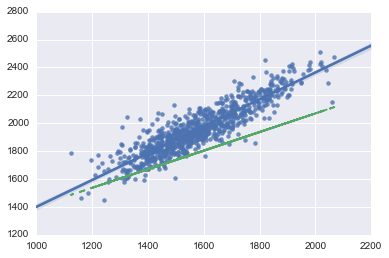

In [279]:
dfB = load_data()

#dfB = dfB.ix[np.where(dfB.total_area/100 > 1400)[0]]

fitted = sm.ols(formula='surfarea ~ icv', data={'surfarea': np.array(dfB.surfarea, dtype=np.float) / 100.0,
                                               'icv': np.array(dfB.icv, dtype=np.float) / 1000.0}).fit()
idx = np.where(np.abs(fitted.resid) < (2.5 * np.std(fitted.resid)))[0]

print np.shape(idx)

dfB = dfB.ix[idx].copy()

x = np.array(dfB.icv, dtype=np.float) / 1000.0
y = np.array(dfB.surfarea, dtype=np.float) / 100.0
f = plt.figure()
sns.regplot(x,y)
slope, intercept= np.polyfit(x,y,1)

print('n = ' + str(len(x)))
print('slope = ' + str(slope))
print('r^2 = ' + str(np.corrcoef(x,y)[0][1]**2))

# Plot the best fit line over the actual values
abline_values = np.squeeze([2./3. * i + intercept + 300 for i in x])
print np.shape(abline_values)
print np.shape(x)
plt.plot(x, abline_values, '--')
plt.show()
f.savefig('scatter_vol_surfarea.svg')

0.0628691969506


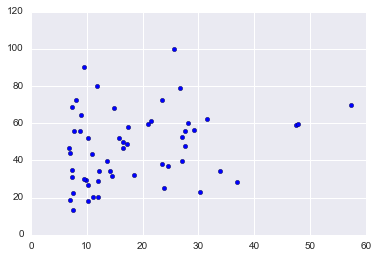

In [346]:
# Right distances

# Calculate f-ratio
f_ratio = []
p_value = []
len_check = []
dist = []

df = dfB.T[(np.shape(dfB)[1]-123):np.shape(dfB)[1]].T

for i in df.columns:

    if np.mean(np.array(df[i], dtype=np.float)) > 10.0:

        d = np.array(df[i], dtype=np.float)
        idx = np.where(np.abs(d - np.mean(d)) < (2.5 * np.std(d)))[0]
        len_check.append(len(idx))
        dx = np.array(df[i].ix[idx], dtype=np.float)
        dist.append(np.mean(dx))
                    
        res1 = sm.ols(formula="parcel ~ 1 + volume + total_area", 
                  data={'volume':np.array(dfB.ix[idx].icv, dtype=np.float),'total_area':np.array(dfB[48].ix[idx], dtype=np.float), 'parcel':dx}).fit() 
        res2 = sm.ols(formula="parcel ~ 1 + volume", 
                  data={'volume':np.array(dfB.ix[idx].icv, dtype=np.float), 'parcel':dx}).fit()

        F = (res2.ssr - res1.ssr) / (res1.ssr / res1.df_resid)

        f_ratio.append(F)
        p_value.append(1-ss.f.cdf(F, 1, res1.df_resid))

    else:
        f_ratio.append(0.)
        p_value.append(1.)
        len_check.append(0)
        dist.append(0.0)
                    
f_ratio = np.nan_to_num(f_ratio)
p_value = np.nan_to_num(p_value)

# Threshold:
dist_right = np.array(dist)
f_ratio_right = f_ratio.copy()
r, p = pearsonr(f_ratio[np.where(p_value < 0.01)[0]],dist_right[np.where(p_value < 0.01)[0]])
print p
plt.scatter(f_ratio[np.where(p_value < 0.01)[0]],dist_right[np.where(p_value < 0.01)[0]])

f_ratio[np.where(p_value > 0.0001)[0]] = 0.

# Visualize:
resR, maskNewR = loadstats(f_ratio, pathsR, verticesR, trianglesR)
# img = vizstats(verticesR, trianglesR, sulcR, maskNewR, resR)

0.107347803233


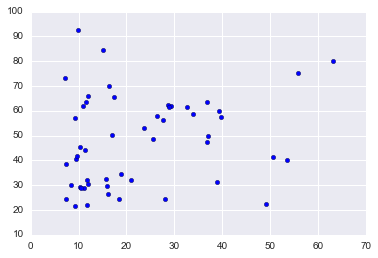

In [347]:
# Left distances

# Calculate f-ratio
f_ratio = []
p_value = []
dist = []
len_check = []

df = dfB.T[(np.shape(dfB)[1]-123-123):np.shape(dfB)[1]-123].T

for i in df.columns:

    if np.mean(np.array(df[i], dtype=np.float)) > 10.0:

        d = np.array(df[i], dtype=np.float)
        idx = np.where(np.abs(d - np.mean(d)) < (2.5 * np.std(d)))[0]
        len_check.append(len(idx))
        dx = np.array(df[i].ix[idx], dtype=np.float)
        dist.append(np.squeeze(np.mean(dx)))
        res1 = sm.ols(formula="parcel ~ 1 + volume + total_area", 
                  data={'volume':np.array(dfB.ix[idx].icv, dtype=np.float),
                        'total_area':np.array(dfB[3].ix[idx], dtype=np.float), 
                        'parcel':dx}).fit() 
        res2 = sm.ols(formula="parcel ~ 1 + volume", 
                  data={'volume':np.array(dfB.ix[idx].icv, dtype=np.float), 
                        'parcel':dx}).fit()

        F = (res2.ssr - res1.ssr) / (res1.ssr / res1.df_resid)

        f_ratio.append(F)
        p_value.append(1-ss.f.cdf(F, 1, res1.df_resid))

    else:
        f_ratio.append(0.)
        p_value.append(1.)
        len_check.append(0)
        dist.append(0.0)
                       
f_ratio = np.nan_to_num(f_ratio)
p_value = np.nan_to_num(p_value)

# Threshold:
dist_left = np.array(dist)
f_ratio_left = f_ratio.copy()
r, p = pearsonr(f_ratio[np.where(p_value < 0.01)[0]],dist_left[np.where(p_value < 0.01)[0]])
print p
plt.scatter(f_ratio[np.where(p_value < 0.01)[0]],dist_left[np.where(p_value < 0.01)[0]])

f_ratio[np.where(p_value > 0.0001)[0]] = 0.
# Visualize:
resL, maskNewL = loadstats(f_ratio, pathsL, verticesL, trianglesL)
# img = vizstats(verticesL, trianglesL, sulcL, maskNewL, resL)

In [311]:
# Parcels: 

# Calculate f-ratio
f_ratio = []
p_value = []
len_check = []
area = []

df = dfB[np.concatenate((range(4,4+43), range(49,49+43)))]

for i in df.columns:

    d = np.array(df[i], dtype=np.float)
    idx = np.where(np.abs(d - np.mean(d)) < (2.5 * np.std(d)))[0]
    len_check.append(len(idx))
    dx = np.array(df[i].ix[idx], dtype=np.float)
    area.append(np.sum(dx))

    if i <=46:
        res1 = sm.ols(formula="parcel ~ 1 + volume + total_area", 
              data={'volume':np.array(dfB.ix[idx].icv, dtype=np.float),'total_area':np.array(dfB[3].ix[idx], dtype=np.float), 'parcel':dx}).fit()
    else: 
        res1 = sm.ols(formula="parcel ~ 1 + volume + total_area", 
              data={'volume':np.array(dfB.ix[idx].icv, dtype=np.float),'total_area':np.array(dfB[48].ix[idx], dtype=np.float), 'parcel':dx}).fit()
        
    #res1 = sm.ols(formula="parcel ~ 1 + volume + total_area", 
    #          data={'volume':np.array(dfB.ix[idx].icv, dtype=np.float),'total_area':np.array(dfB.ix[idx].surfarea, dtype=np.float), 'parcel':dx}).fit() 
    res2 = sm.ols(formula="parcel ~ 1 + volume", 
              data={'volume':np.array(dfB.ix[idx].icv, dtype=np.float), 'parcel':dx}).fit()

    F = (res2.ssr - res1.ssr) / (res1.ssr / res1.df_resid)

    f_ratio.append(F)
    p_value.append(1-ss.f.cdf(F, 1, res1.df_resid))

                       
f_ratio = np.nan_to_num(f_ratio)
p_value = np.nan_to_num(p_value)

# zero medial wall and insula
f_ratio[[0,42,43,85]] = 0.0
p_value[[0,42,43,85]] = 1.0

# Threshold:
f_ratio[np.where(p_value > 0.0001)[0]] = 0.

# Visualize:
res_surf_L, res_surf_R, verticesL, trianglesL, verticesR, trianglesR, sulcL, sulcR = load4visuFratio(f_ratio)

/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/ipykernel/__main__.py:5: DeprecationWarning: giftiio.read function deprecated. Use nibabel.load() instead.

* deprecated from version: 2.1
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 4.0
/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/ipykernel/__main__.py:6: DeprecationWarning: giftiio.read function deprecated. Use nibabel.load() instead.

* deprecated from version: 2.1
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 4.0
/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/ipykernel/__main__.py:34: DeprecationWarning: giftiio.read function deprecated. Use nibabel.load() instead.

* deprecated from version: 2.1
* Will raise <class 'nibabel.deprecator.ExpiredDeprecationError'> as of version: 4.0
/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/ipykernel/__main__.py:41: DeprecationWarning: gifti

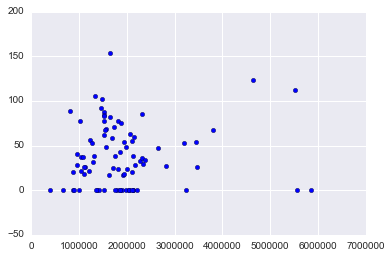

In [297]:
plt.scatter(area, f_ratio)

In [ ]:
results_R = res_surf_R.copy() * -1
results_R[np.where(resR != 0)[0]] = resR[np.where(resR != 0)[0]] / np.max(resR[np.where(resR != 0)[0]]) * np.max(res_surf_R)
# vizstats(verticesR, trianglesR, sulcR, np.where(results_R != 0)[0], results_R)

vertices = verticesR
triangles = trianglesR
sulc = sulcR
mask = np.where(results_R != 0)[0]
stats = results_R
cmap = 'jet'
    
f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=180, azim=180, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()
f.savefig('fig_1.png', bbox_inches='tight')    
f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=180, azim=0, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()                   
f.savefig('fig_2.png', bbox_inches='tight')    

f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=90, azim=180, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()                   
f.savefig('fig_3.png', bbox_inches='tight')      

f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=270, azim=180, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()
f.savefig('fig_4.png', bbox_inches='tight') 

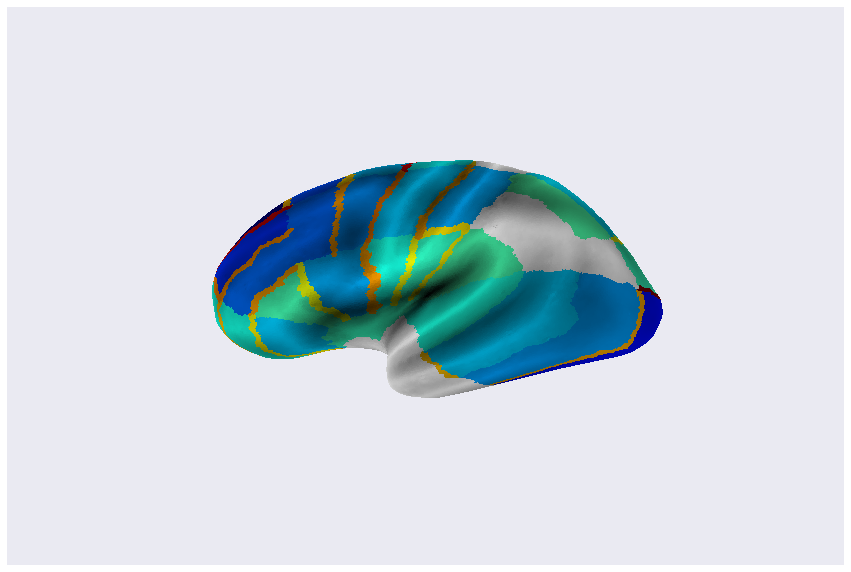

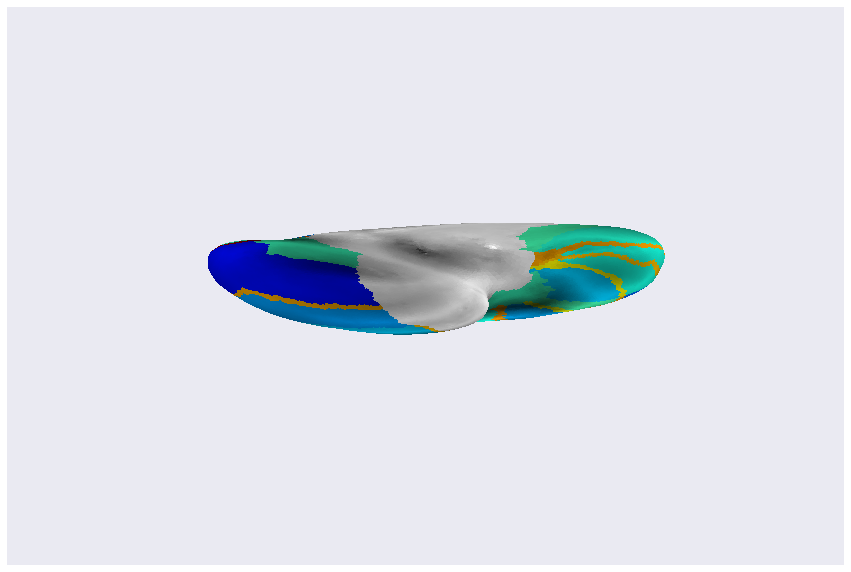

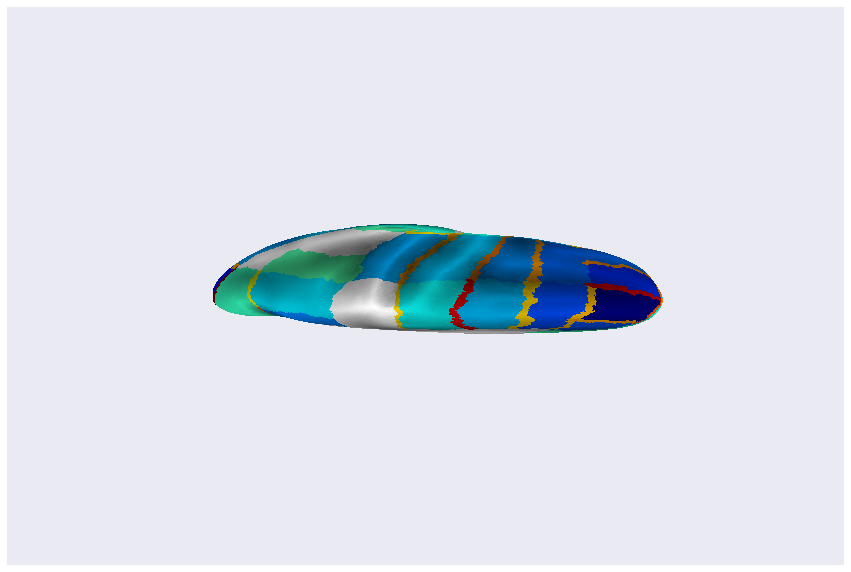

In [17]:
f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=180, azim=0, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()                   
f.savefig('fig_2.png', bbox_inches='tight')    

f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=90, azim=180, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()                   
f.savefig('fig_3.png', bbox_inches='tight')      

f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=270, azim=180, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()
f.savefig('fig_4.png', bbox_inches='tight')    

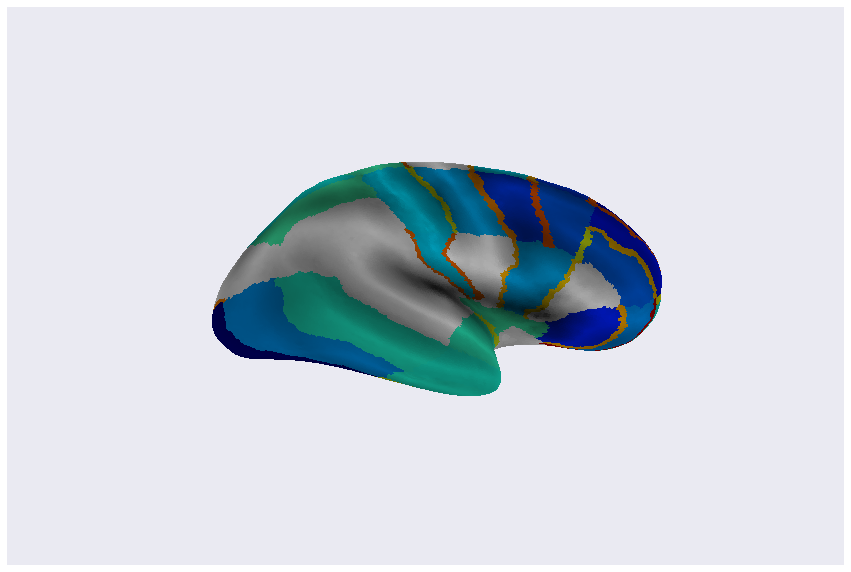

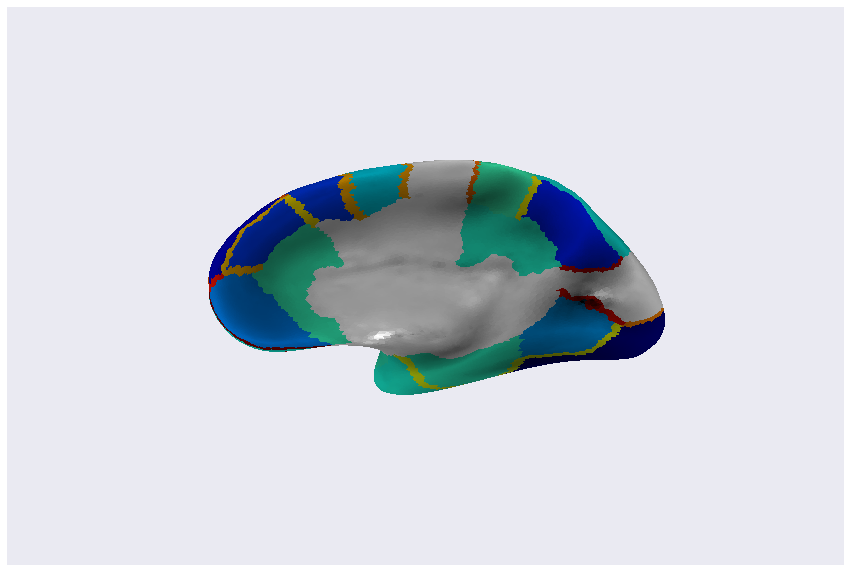

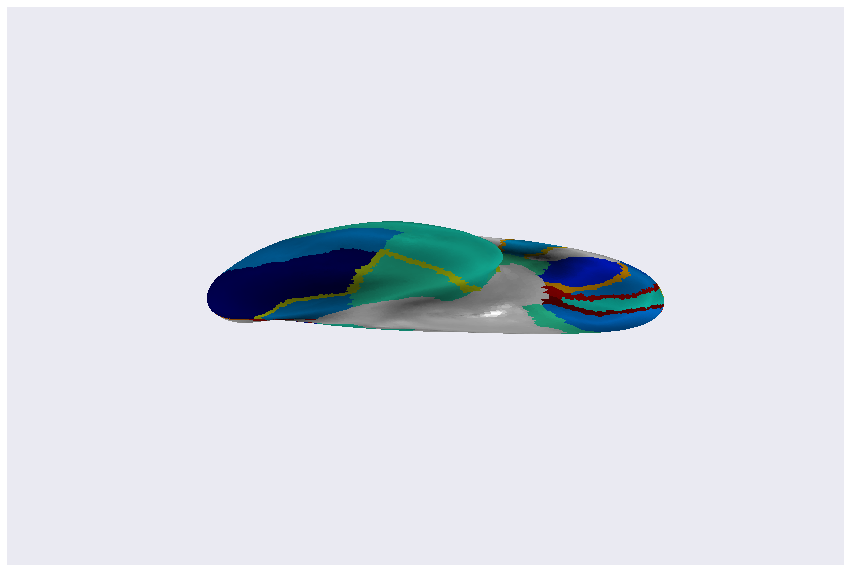

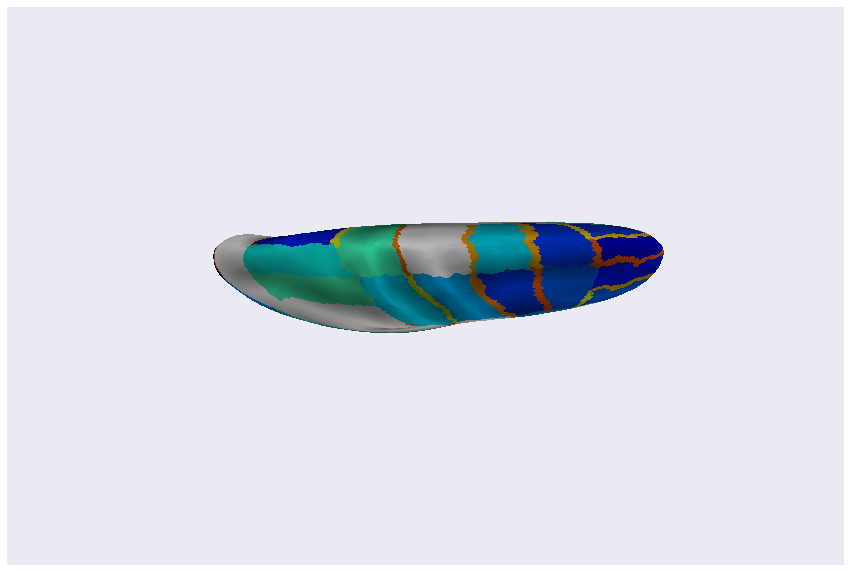

In [18]:
results_L = res_surf_L.copy() * -1
results_L[np.where(resL != 0)[0]] = resL[np.where(resL != 0)[0]] / np.max(resL[np.where(resL != 0)[0]]) * np.max(res_surf_L)
# vizstats(verticesL, trianglesL, sulcL, np.where(results_L != 0)[0], results_L)

vertices = verticesL
triangles = trianglesL
sulc = sulcL
mask = np.where(results_L != 0)[0]
stats = results_L
cmap = 'jet'

f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=180, azim=180, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()
f.savefig('fig_1.png', bbox_inches='tight')    
f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=180, azim=0, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()                   
f.savefig('fig_2.png', bbox_inches='tight')    

f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=90, azim=180, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()                   
f.savefig('fig_3.png', bbox_inches='tight')      

f = plot_surf_stat_map(coords=vertices, faces=triangles, stat_map=stats,
                   elev=270, azim=180, figsize=(15,10),
                   cmap=cmap,
                   threshold=None, 
                   bg_map=sulc, bg_on_stat=True,
                   alpha='auto', symmetric_cbar=False, 
                   mask=mask, lenient=True, label=True)
plt.show()
f.savefig('fig_4.png', bbox_inches='tight') 

In [166]:
res = resL * resR
img = vizstats(verticesL, trianglesL, sulcL, maskNewL, res)

ValueError: operands could not be broadcast together with shapes (54138,) (54837,) 

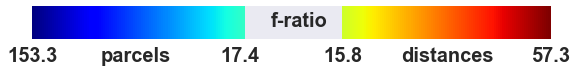

In [904]:
from matplotlib import pyplot
import matplotlib as mpl
mpl.rcParams['svg.fonttype'] = 'none'

# Make a figure and axes with dimensions as desired.
fig = pyplot.figure(figsize=(8, 3))
ax1 = fig.add_axes([0.05, 0.80, 0.9, 0.15])

cmap = mpl.cm.jet
my_cmap = cm.get_cmap('jet')
my_cmap._init()
# np.shape(my_cmap._lut)[0]
my_cmap._lut[105:153,:] = np.zeros((abs(105-153),4))
norm = mpl.colors.Normalize(vmin=-10, vmax=10)

cb1 = mpl.colorbar.ColorbarBase(ax1, cmap=my_cmap, norm=norm,                
                                orientation='horizontal', ticks=[-10, -6, -2, 2, 6, 10])

neg_max = np.max(res_surf_L) 
neg_min = np.min(res_surf_L[np.nonzero(res_surf_L)]) 
pos_min = np.min(resL[np.nonzero(resL)])
pos_max = np.max(resL)

neg_max = np.max(res_surf_R) 
neg_min = np.min(res_surf_R[np.nonzero(res_surf_R)]) 
pos_min = np.min(resR[np.nonzero(resR)])
pos_max = np.max(resR)

cb1.ax.set_xticklabels(
    ['%.1f' % neg_max, 'parcels', '%.1f' % neg_min, '%.1f' % pos_min, 'distances', '%.1f' % pos_max], 
    fontsize=20)
ax1.text(0.46,0.40,'f-ratio', fontsize=20)
pyplot.show()
fig.savefig('colorbar_right.svg')


In [157]:
import xml.etree.ElementTree as ET
import numpy as np
import pandas as pd
from colormap import rgb2hex

In [158]:
side = 'right'
tree = ET.parse('/Users/dmargulies/Downloads/hiphop_template_%s.svg' % side)
root = tree.getroot()
SVG_NS = "http://www.w3.org/2000/svg"
path_style = "stroke-width:4;stroke-opacity:1.0;stroke:"

In [159]:
f_ratio = f_ratio_right.copy()
print len(f_ratio)
sig = np.where(f_ratio != 0)[0]
print len(sig)
cmap = plt.cm.get_cmap('jet')
col = cmap((f_ratio[sig] / np.max(f_ratio[sig]) + 1)/2)
print sig

123
27
[  5   8   9  10  18  22  23  26  28  29  31  34  37  40  54  60  61  78
  79  95 107 108 111 113 115 118 120]


In [160]:
for node in root.findall('.//{%s}line' % SVG_NS):
    matching = [n for n, s in enumerate(sig) if node.attrib['id'] == ('path' + str(s) + '_')]
    if len(matching) > 0:
        a = tuple(list(col[matching[0]]))
        node.attrib['style'] = path_style + rgb2hex(a[0],a[1],a[2],a[3]) + ';'        
tree.write('fig_hiphop_%s.svg' % side)  

In [116]:
for node in root.findall('.//{%s}line' % SVG_NS):
    matching = []            
    if 'fill' in node.keys():            
        matching = [n for n, s in enumerate(sp) if 
                    node.attrib['fill'] == (str(s))]# + '_ECO') or
    if len(matching) > 0:
        a = tuple(list(col[matching[0]]))
        node.attrib['style'] = path_style + rgb2hex(a[0],a[1],a[2],a[3]) + ';'
        node.attrib['fill'] = ""
tree.write('./economo/fig_%s.svg' % side)

IOError: [Errno 2] No such file or directory: './economo/fig_left.svg'

In [ ]:
['style'] = path_style
path_style = "stroke:#000000;stroke-width:0;stroke-opacity:0;fill-opacity:1;fill:"
SVG_NS = "http://www.w3.org/2000/svg"
             
def parse_xml(data):  
    '''
    data = input vector as numpy array with 48 values corresponding to the economo areas
    '''
    #for side in ['lateral', 'medial']:
    tree = ET.parse('economo/EconomoTemplate/Economo_%s.svg' % side)
    root = tree.getroot()
    sp = list(pd.read_csv('economo/EconomoTemplate/Economo_regionnames.txt', header=-1)[0])    

    cmap = plt.cm.get_cmap('jet')   
    # mean PB1 and PB2:
    order1 = np.concatenate((data[0:17],[np.mean(data[17:19])], data[19::]))
    setR = float(np.max(np.abs(order1)))
    order2 = order1 + setR # - np.min(order1)
    order3 = order2 / (2 * setR) #(np.max(order2)-np.min(order2))
    # print np.max(order3), np.min(order3)        
    col = cmap(order3)

    for node in root.findall('.//{%s}path' % SVG_NS):
        matching = []            
        if 'fill' in node.keys():            
            matching = [n for n, s in enumerate(sp) if 
                        node.attrib['fill'] == (str(s))]# + '_ECO') or
        if len(matching) > 0:
            a = tuple(list(col[matching[0]]))
            node.attrib['style'] = path_style + rgb2hex(a[0],a[1],a[2],a[3]) + ';'
            node.attrib['fill'] = ""
    tree.write('./economo/fig_%s.svg' % side)

In [833]:
print (np.shape(my_cmap._lut)[0]/2)-20
print (np.shape(my_cmap._lut)[0]/2)+20

109
149


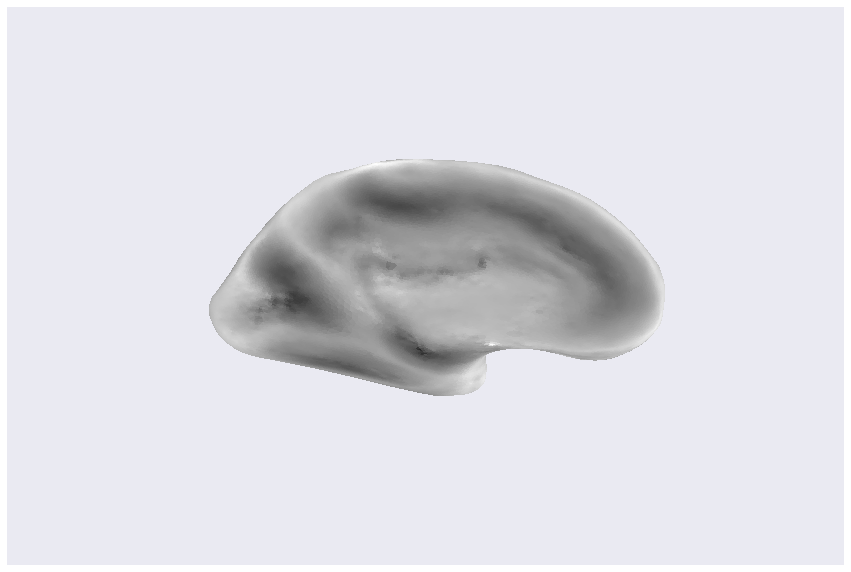

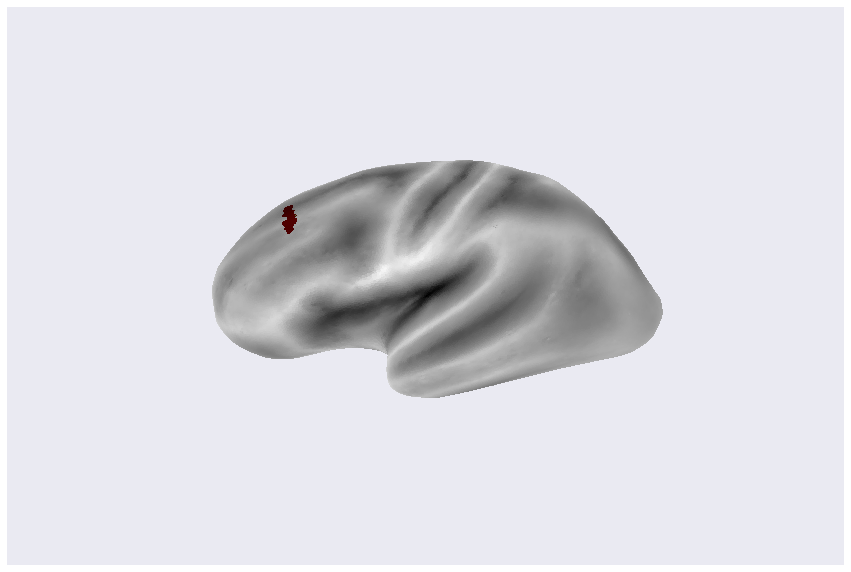

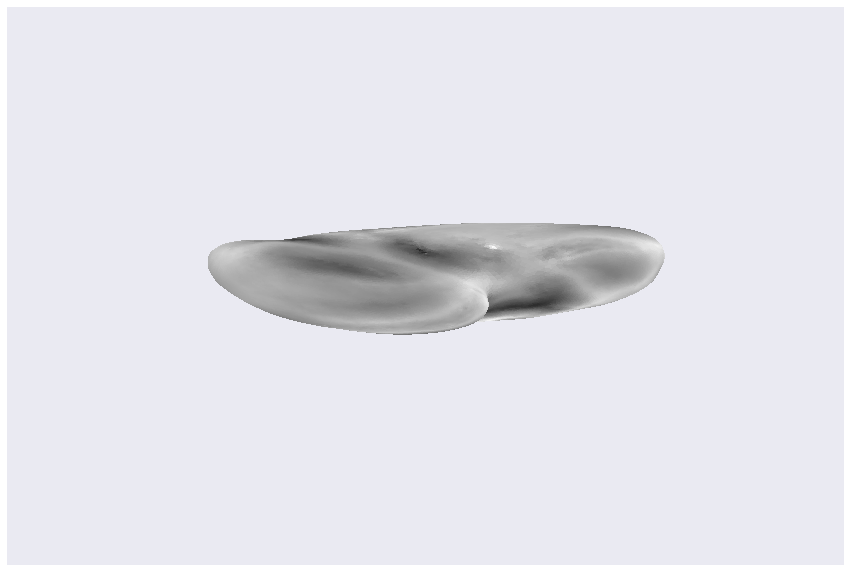

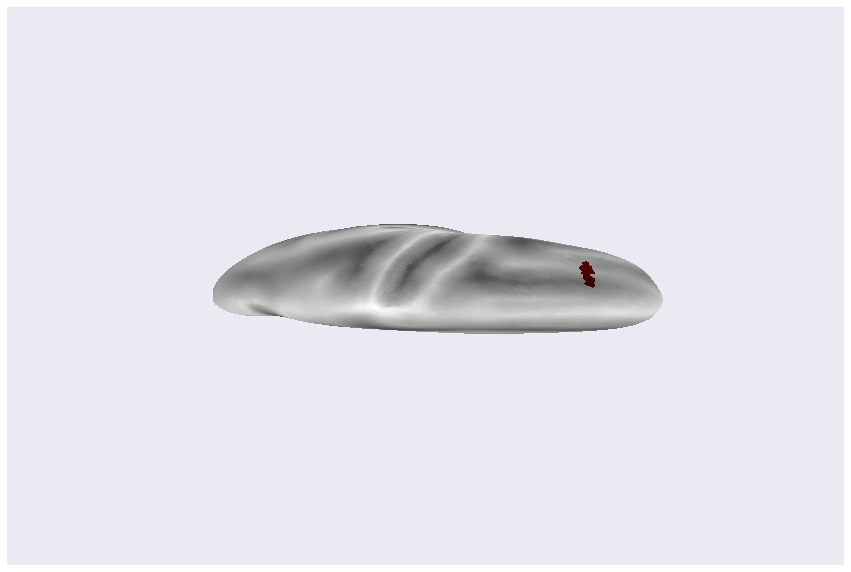

In [245]:
# Visualize paths: 
cols = xrange(123)
# cols = np.zeros(123)
# cols[2] = 1
resR, maskNewR = loadstats(cols, pathsR, verticesR, trianglesR)
img = vizstats(verticesR, trianglesR, sulcR, maskNewR, resR)

In [ ]:
# exponent 

number of subjects: 539


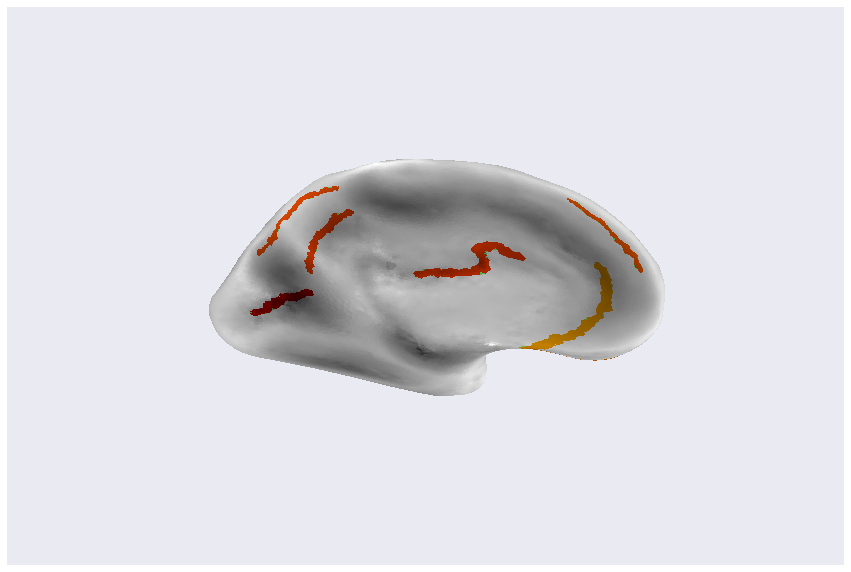

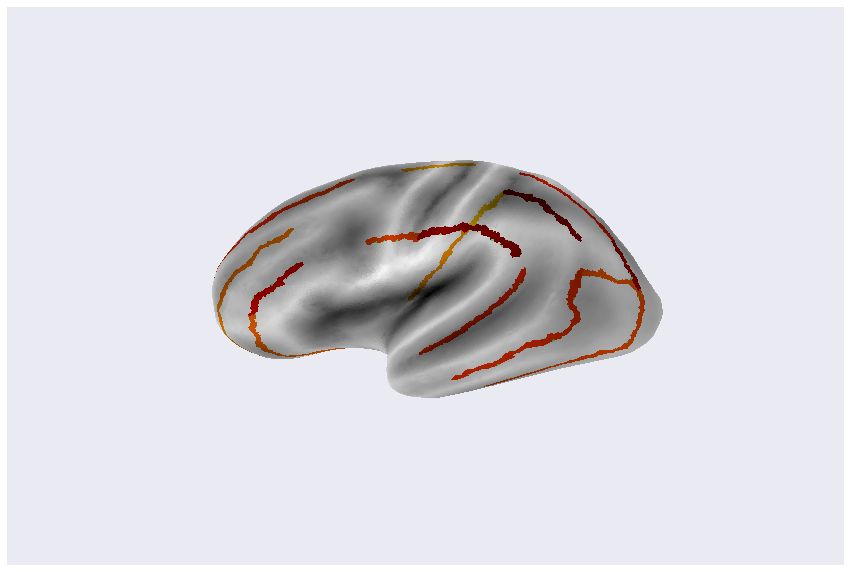

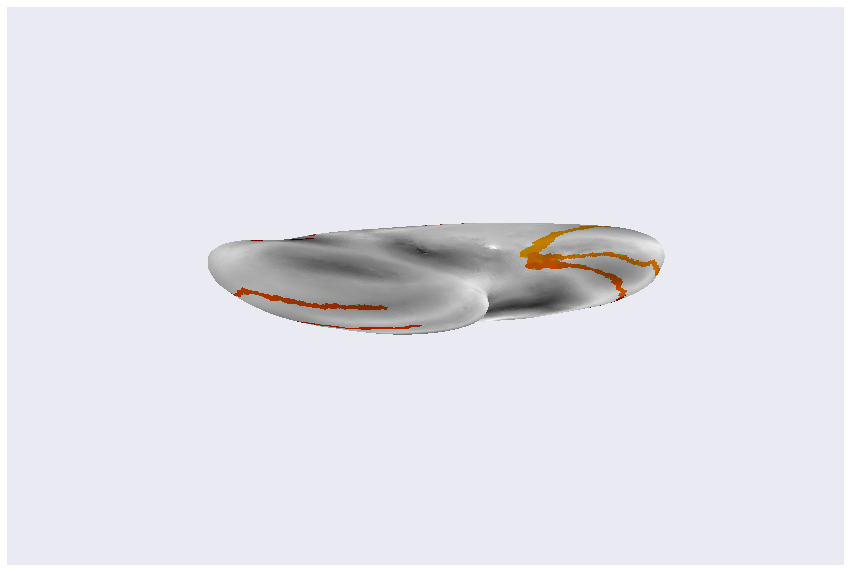

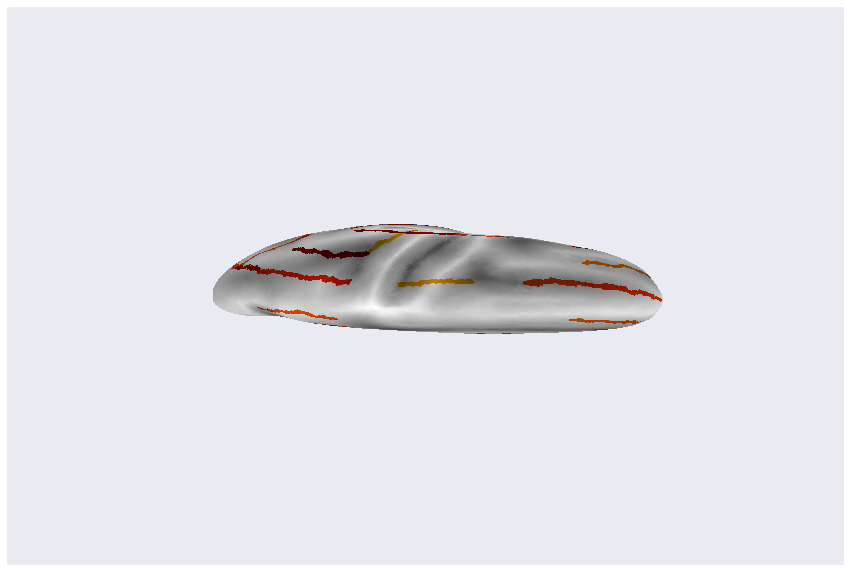

In [79]:
#dfR = load_data('R')
#dfR = dfR.ix[np.where(dfR.surfarea/100 > 700)[0]]
#dfR = dfR.ix[np.where(dfR.volume/1000 < 630)[0]]

v = []
for i in xrange(2,np.shape(dfR)[1]):   
    
    res = sm.ols(formula="parcel ~ 1 + volume", 
                          data={'volume':np.array(np.log(dfR.volume)), 'parcel':np.array(np.log(dfR[i]))}).fit()
    if np.isfinite(res.params['volume']):
        v.append(res.params['volume'])
    else:
        v.append(0)
#plt.hist(v)
#plt.show()

resR, maskNewR = loadstats(v, pathsR, verticesR, trianglesR)
vizstats(verticesR, trianglesR, sulcR, maskNewR, resR)

number of subjects: 539


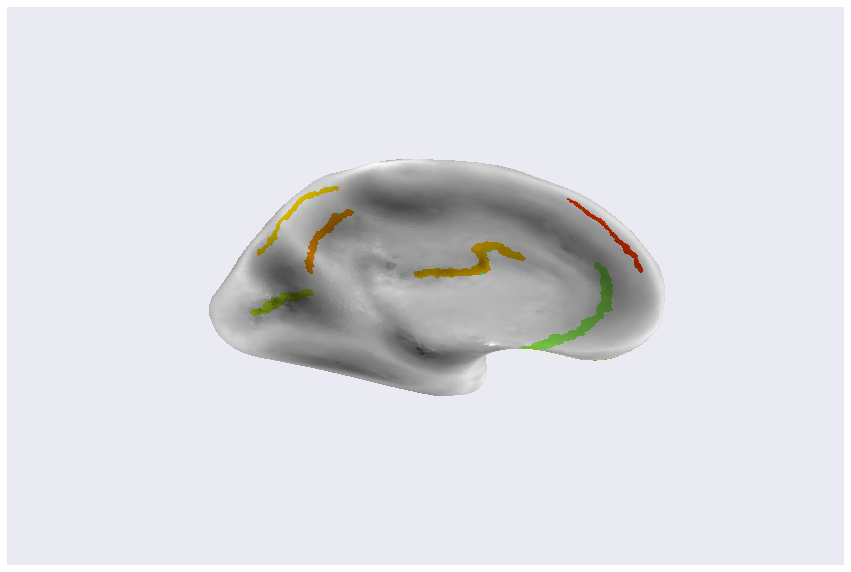

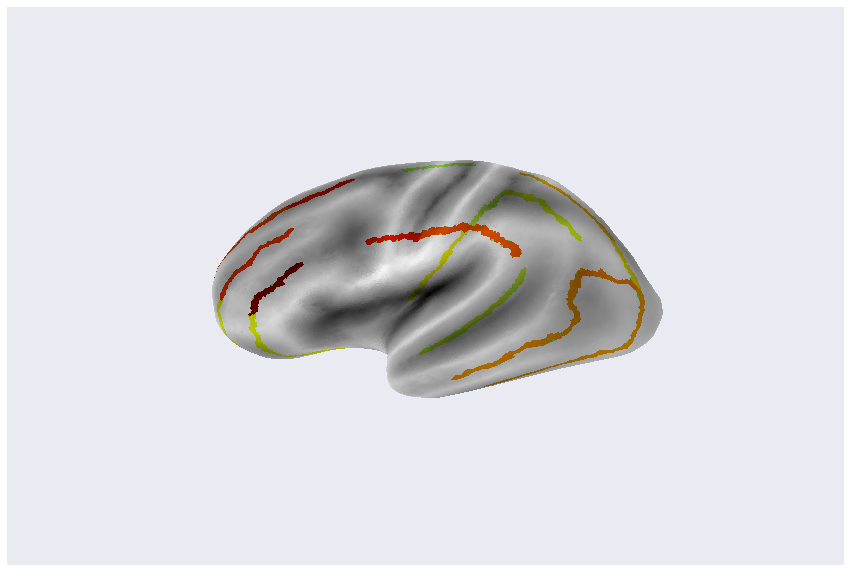

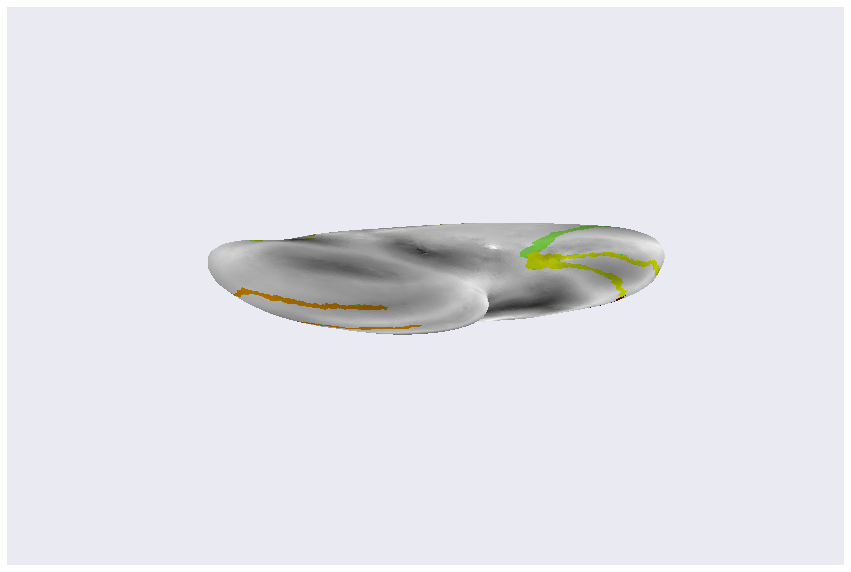

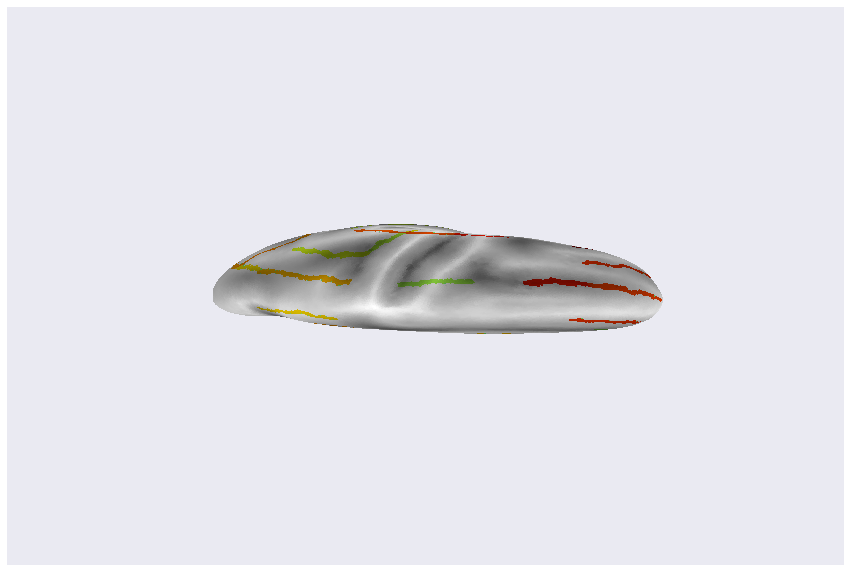

In [80]:
dfR = load_data('R')
dfR = dfR.ix[np.where(dfR.surfarea/100 > 700)[0]]
dfR = dfR.ix[np.where(dfR.volume/1000 < 630)[0]]

res0 = sm.ols(formula="total_area ~ 1 + volume ", 
                          data={'volume':np.array(np.log(dfR.volume)),'total_area':np.array(np.log(dfR.surfarea))}).fit()
resids = np.asarray(res0.resid)
    
v = []
for i in xrange(2,np.shape(dfR)[1]):   
    
    res = sm.ols(formula="parcel ~ 1 + surfarea_resids", 
                          data={'surfarea_resids':resids, 'parcel':np.array(np.log(dfR[i]))}).fit()
    if np.isfinite(res.params['surfarea_resids']):
        v.append(res.params['surfarea_resids'])
    else:
        v.append(0)

resR, maskNewR = loadstats(v, pathsR, verticesR, trianglesR)
vizstats(verticesR, trianglesR, sulcR, maskNewR, resR)

number of subjects: 539


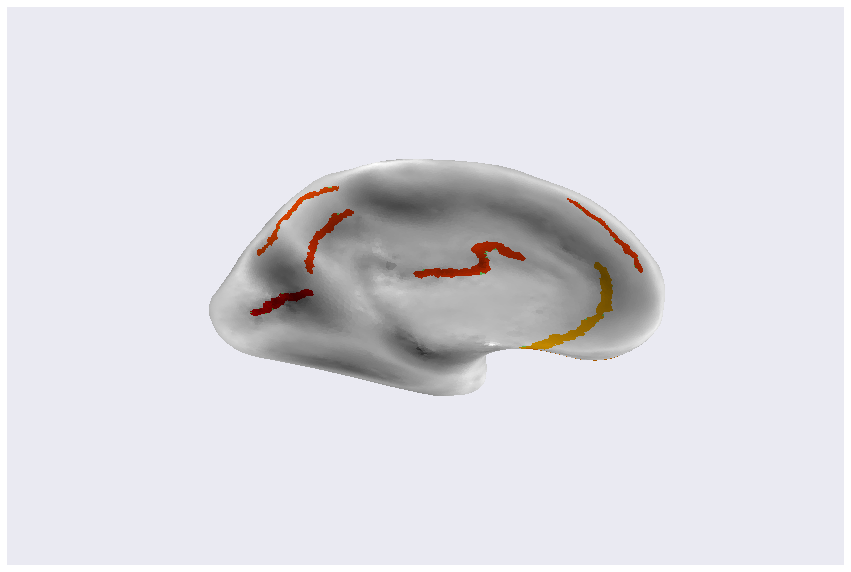

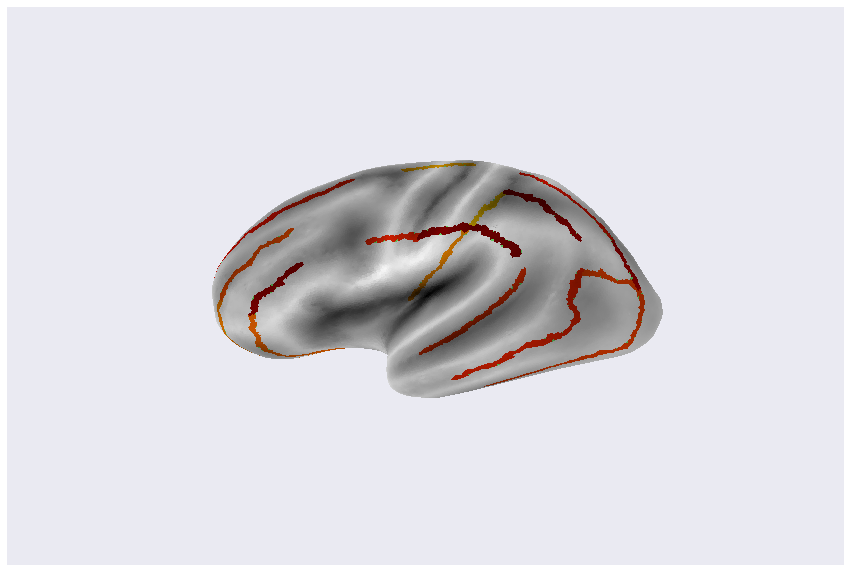

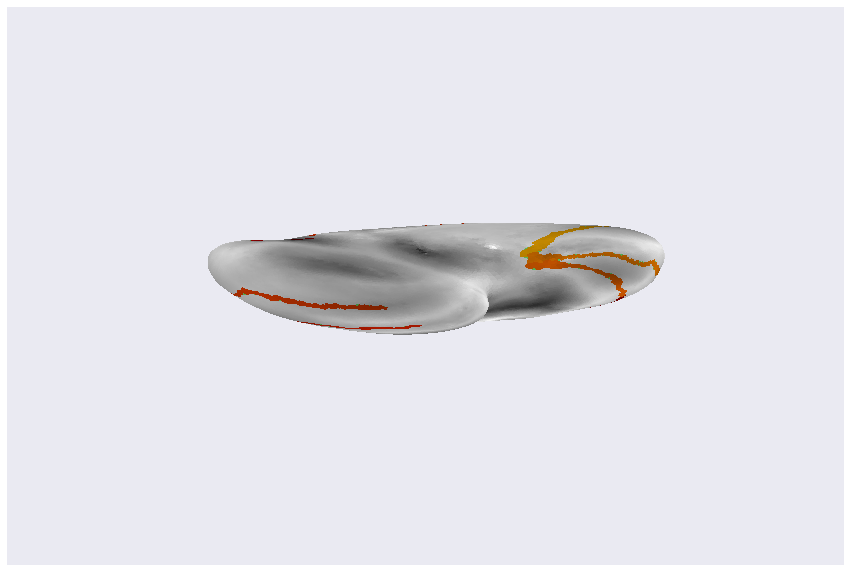

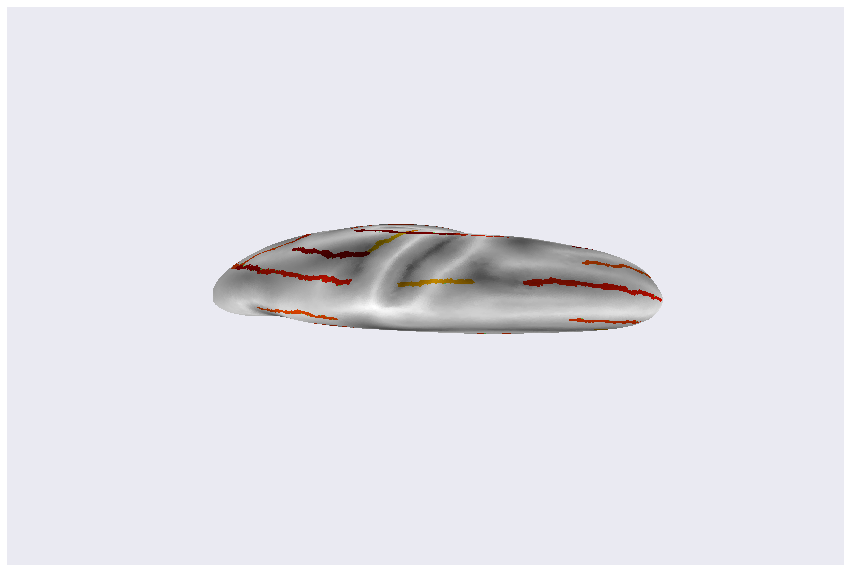

In [77]:
dfR = load_data('R')
dfR = dfR.ix[np.where(dfR.surfarea/100 > 700)[0]]
dfR = dfR.ix[np.where(dfR.volume/1000 < 630)[0]]


v = []
for i in xrange(2,np.shape(dfR)[1]):    
    res = sm.ols(formula="parcel ~ 1 + surfarea", 
                          data={'surfarea':np.array(np.log(dfR.surfarea)), 'parcel':np.array(np.log(dfR[i]))}).fit()
    if np.isfinite(res.params['surfarea']):
        v.append(res.params['surfarea'])
    else:
        v.append(0)
#plt.hist(v)
#plt.show()

resR, maskNewR = loadstats(v, pathsR, verticesR, trianglesR)
vizstats(verticesR, trianglesR, sulcR, maskNewR, resR)

In [14]:
#mean_dist_R = np.array(mean_dist_R)
f = f_ratio_a_R[np.where(mean_dist_R > 20)[0]]
m = mean_dist_R[np.where(mean_dist_R > 20)[0]]
# spearman:
#print scipy.stats(f,m)
print scipy.stats.pearsonr(f_ratio_a_R,mean_dist_R)
#plt.scatter(f,m)
#plt.show()

(0.56205444856538345, 1.3398811691468114e-11)


/Applications/miniconda3/envs/topography/lib/python2.7/site-packages/ipykernel/__main__.py:3: DeprecationWarning: converting an array with ndim > 0 to an index will result in an error in the future
  app.launch_new_instance()


In [13]:
f = f_ratio_a_R[np.where(p_value_conv_R > 0)[0]]
#m = mean_dist_R[np.where(p_value_conv_R > 0)[0]]
#print mean_dist_R

Exception AttributeError: "'NpzFile' object has no attribute 'zip'" in <bound method NpzFile.__del__ of <numpy.lib.npyio.NpzFile object at 0x110332e10>> ignored


data size: (931, 125)
(3,)
[ inf  inf  inf]
p-value threshold: 8.13008130081e-06
# above threshold: 29
longitude: 18
latitude: 11
other: 0


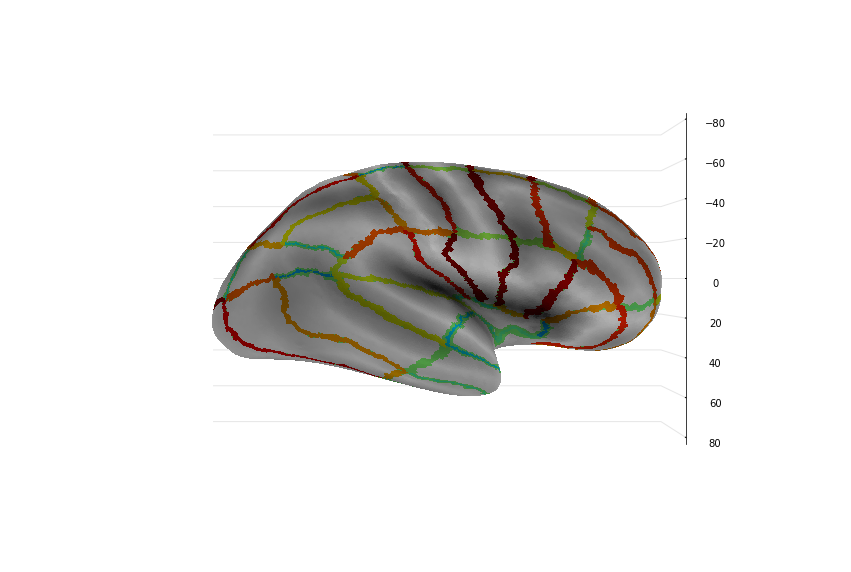

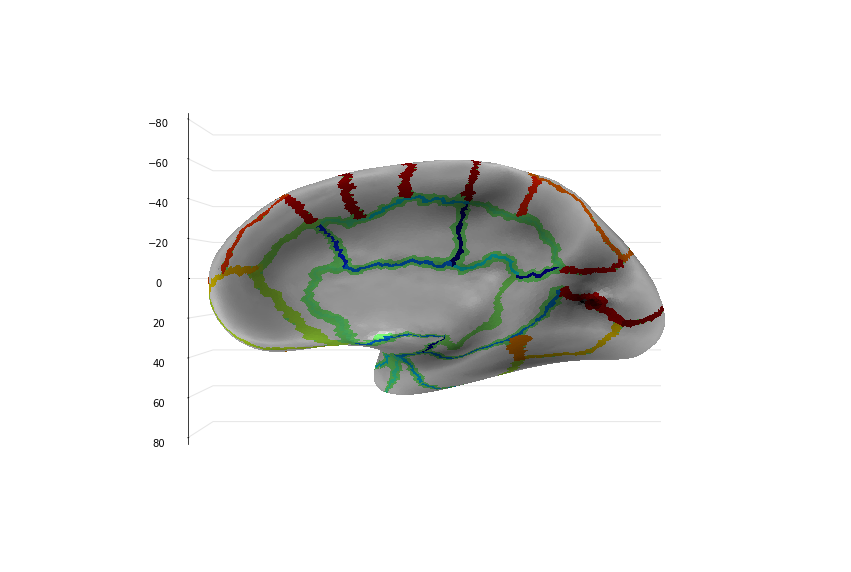

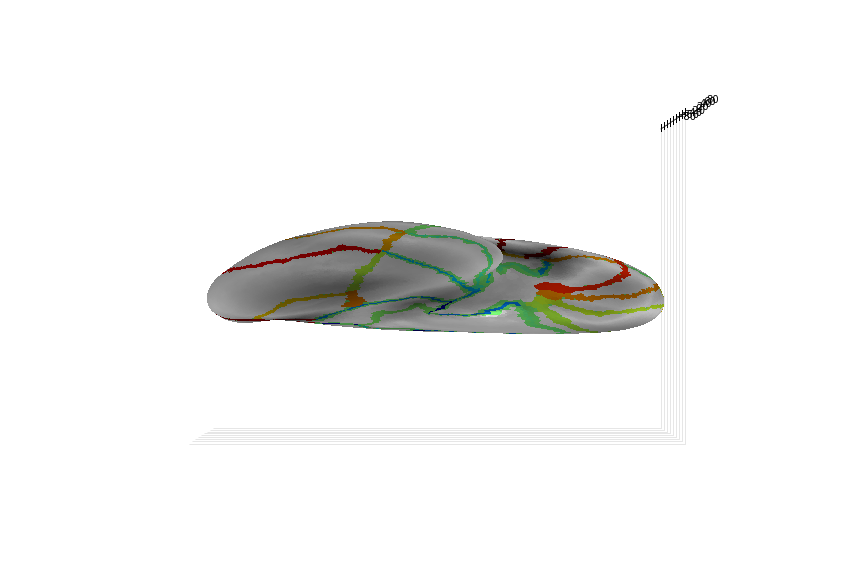

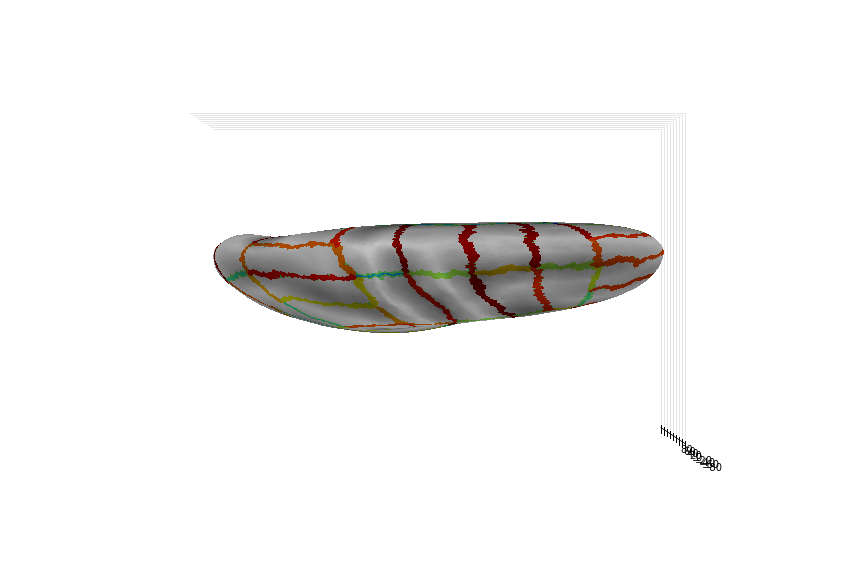

In [15]:
dfL = load_data('L')
mark = list(np.where(np.isinf(dfL))[0])
print np.shape(dfL[mark,np.where(np.isinf(dfL[mark,:]))[1]])
print dfL[mark,np.where(np.isinf(dfL[mark,:]))[1]]
dfL[mark,np.where(np.isinf(dfL[mark,:]))[1]] = 0
f_ratio_a_L, f_ratio_m_L, p_value_L, p_value_conv_L, effect_size_L, mean_dist_L  = runStats(dfL)

# print p_value_L
s_ratio_a_L = np.argsort(np.argsort(f_ratio_a_L)) - np.mean(np.argsort(f_ratio_a_L))
# s_ratio_a_L[np.where(p_value_conv_L == 0)[0]] = np.max(s_ratio_a_L) * -1

resL, maskNewL = loadstats(s_ratio_a_L, pathsL, verticesL, trianglesL)
vizstats(verticesL, trianglesL, sulcL, maskNewL, resL)
printRes(f_ratio_m_L, sulcOrientL)

In [ ]:
# print distributions and scatterplots for each segment...

In [ ]:
# check for correlation between signiciance and length of sulcus
# perhaps correct for sulcal length?

In [17]:
printRes(f_ratio_m_L, sulcOrientL)
printRes(f_ratio_m_R, sulcOrientR)

longitude: 18
latitude: 11
other: 0
longitude: 17
latitude: 9
other: 0
ERROR! Session/line number was not unique in database. History logging moved to new session 630


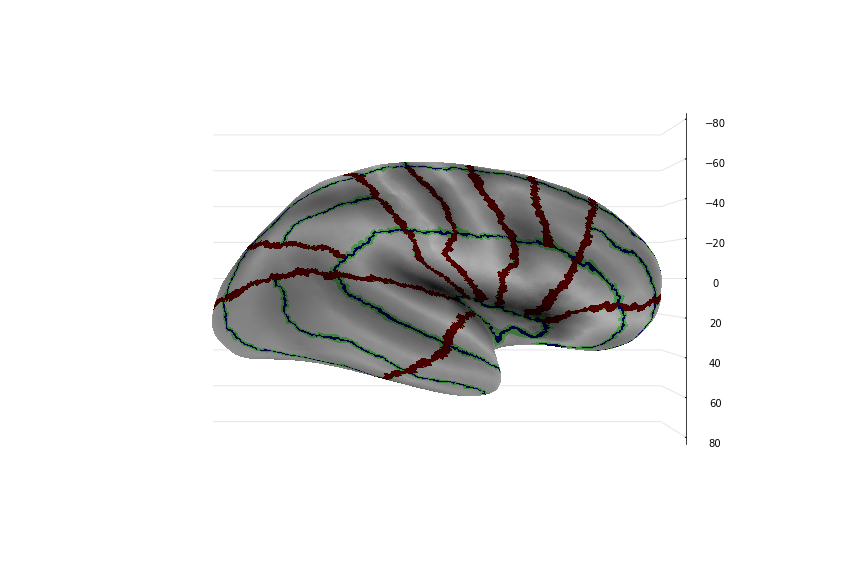

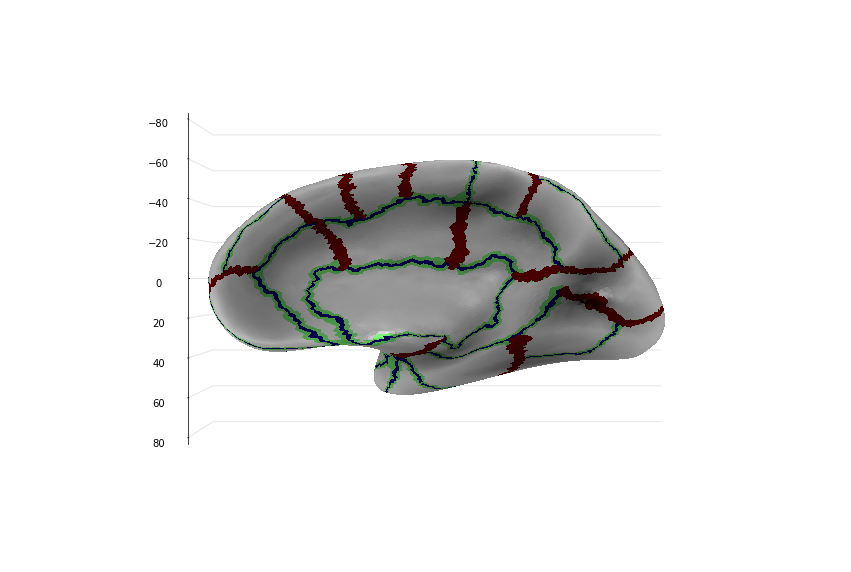

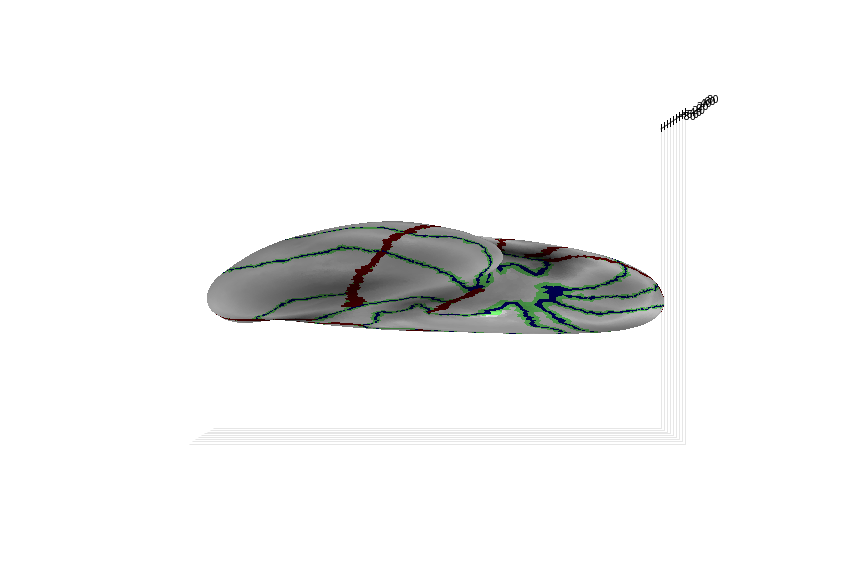

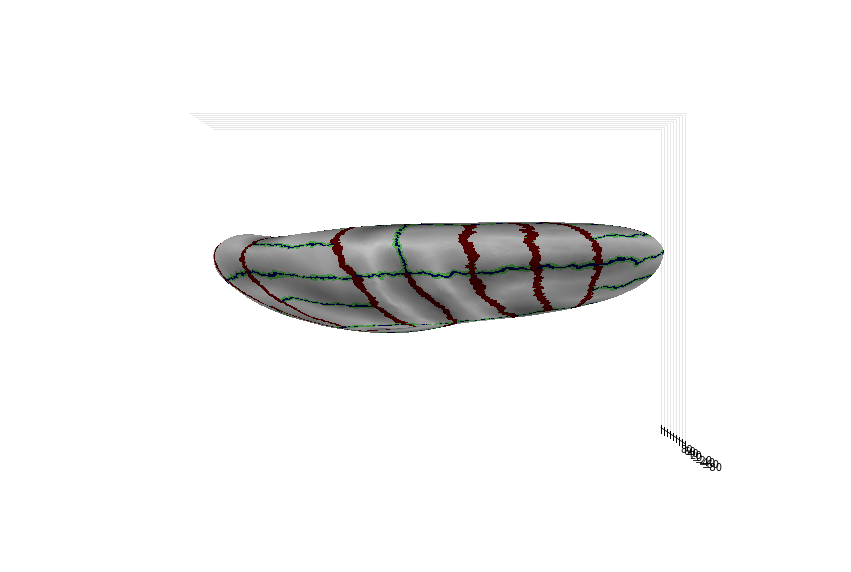

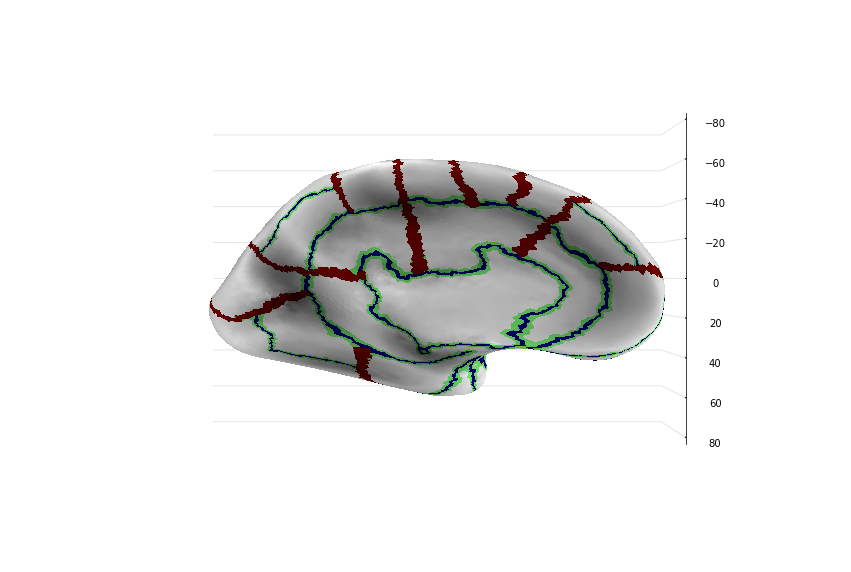

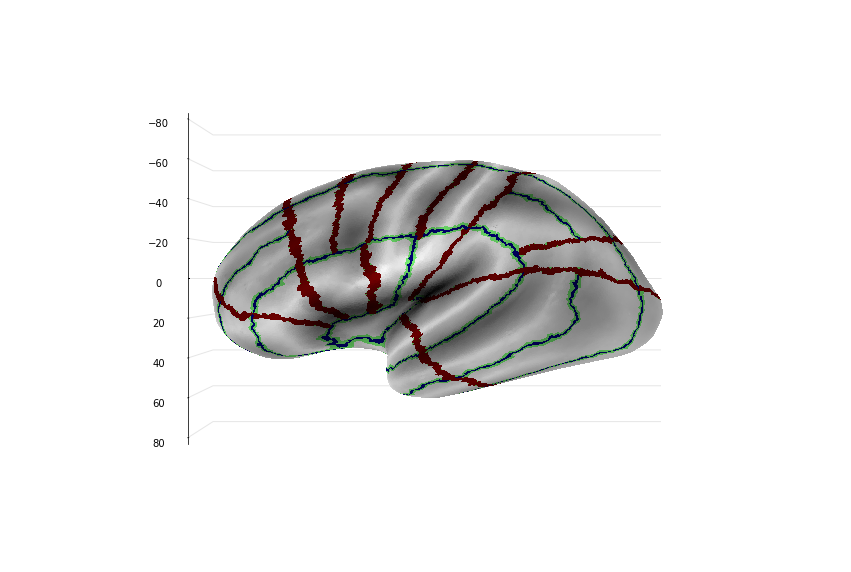

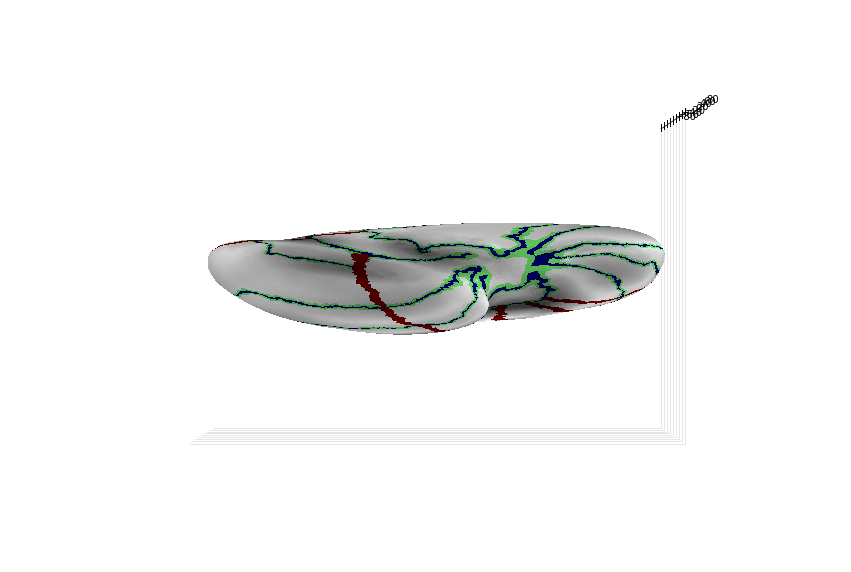

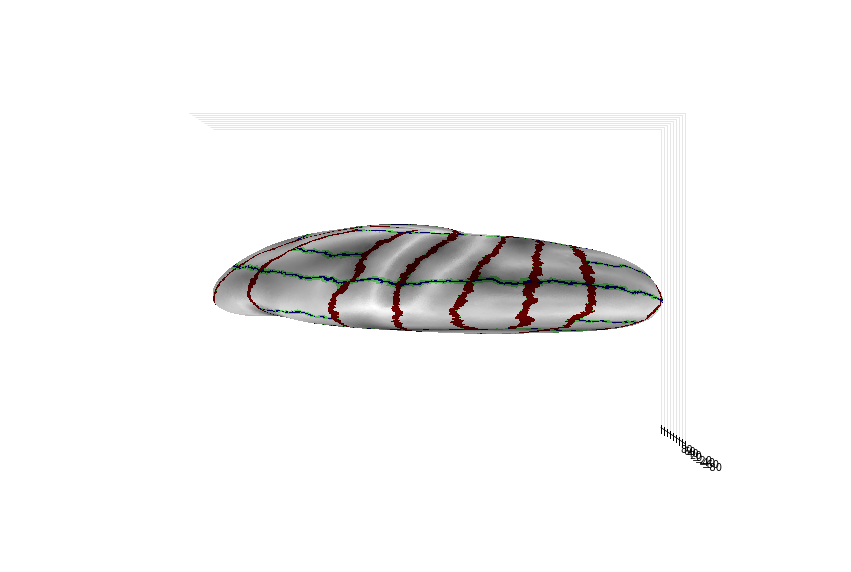

In [19]:
resL, maskNewL = loadstats(sulcOrientL, pathsL, verticesL, trianglesL)
vizstats(verticesL, trianglesL, sulcL, maskNewL, resL)

resR, maskNewR = loadstats(sulcOrientR, pathsR, verticesR, trianglesR) 
vizstats(verticesR, trianglesR, sulcR, maskNewR, resR)

0


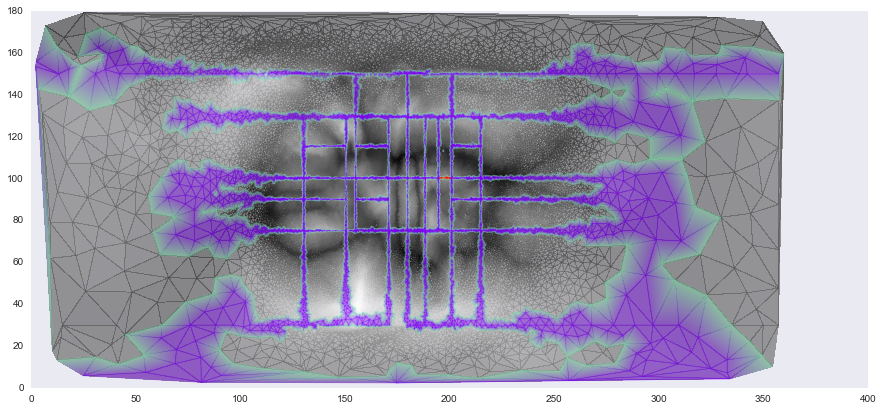

1


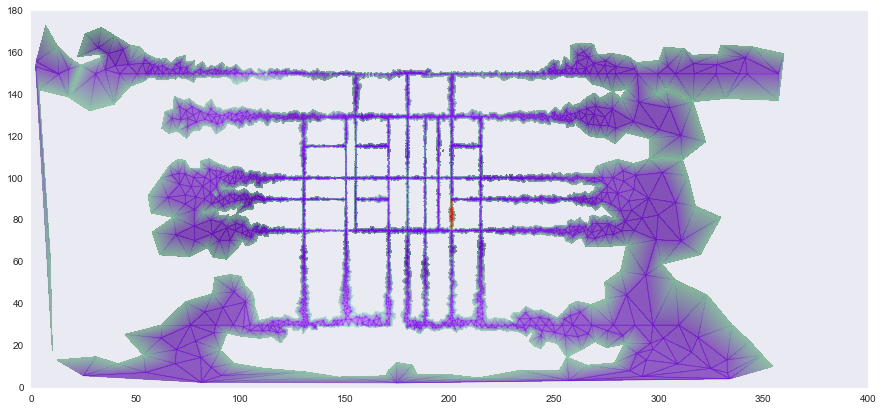

2


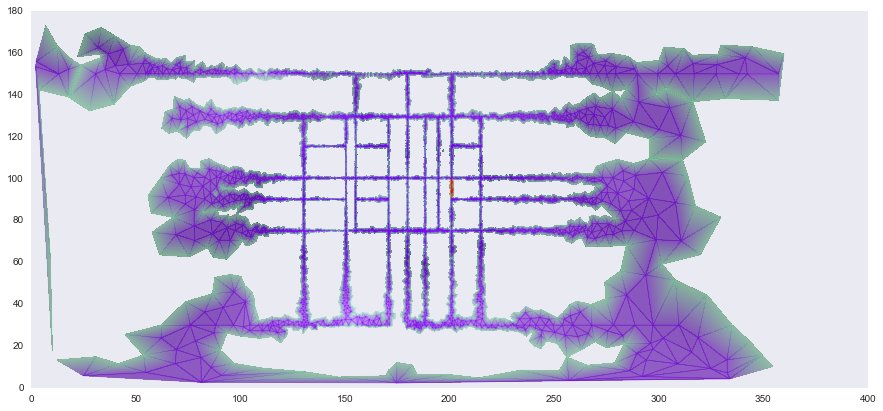

3


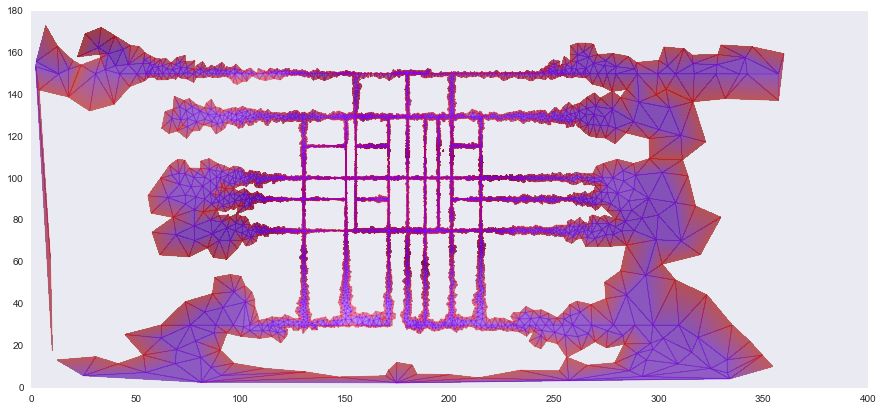

4


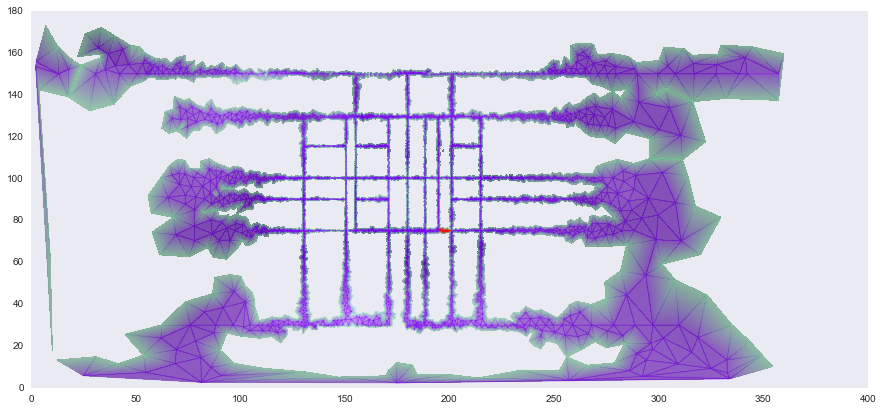

5


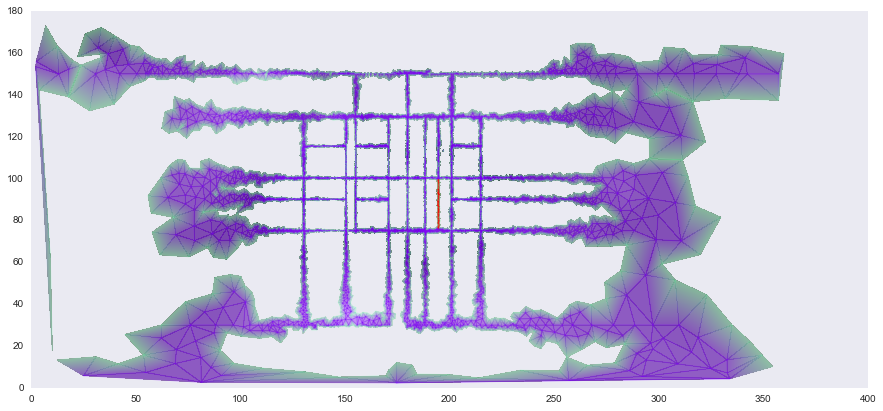

6


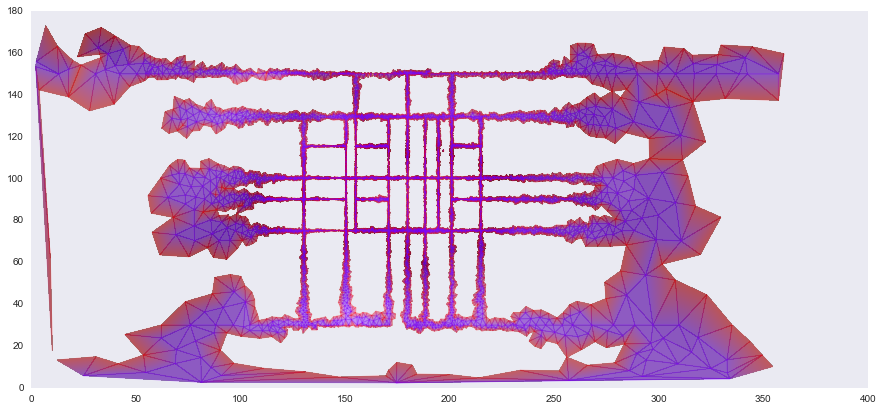

7


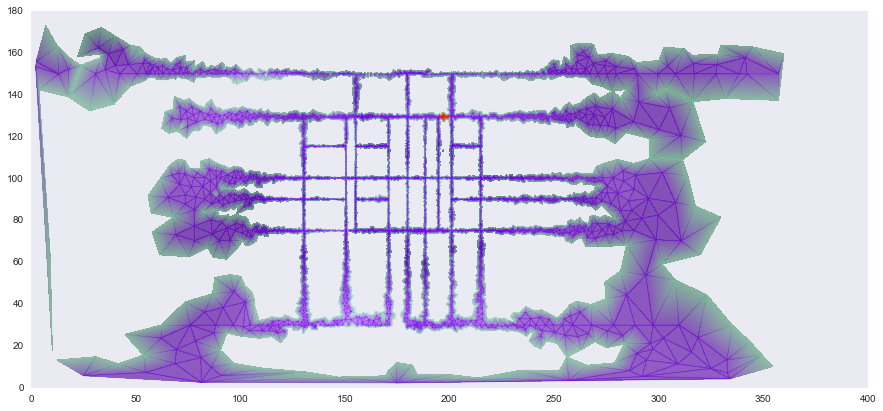

8


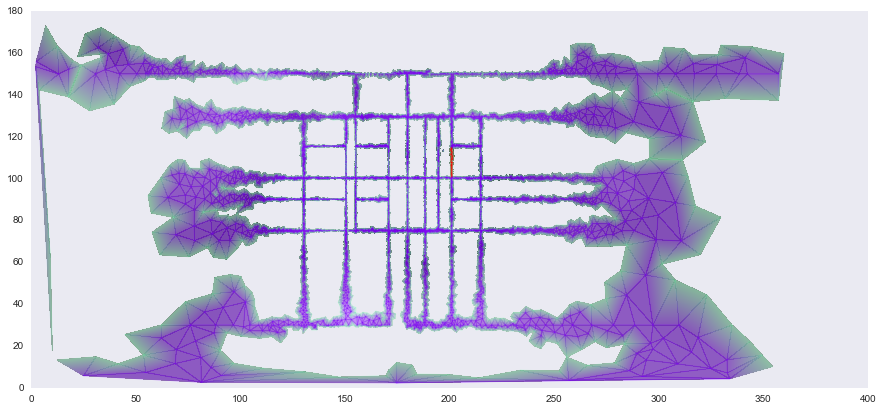

9


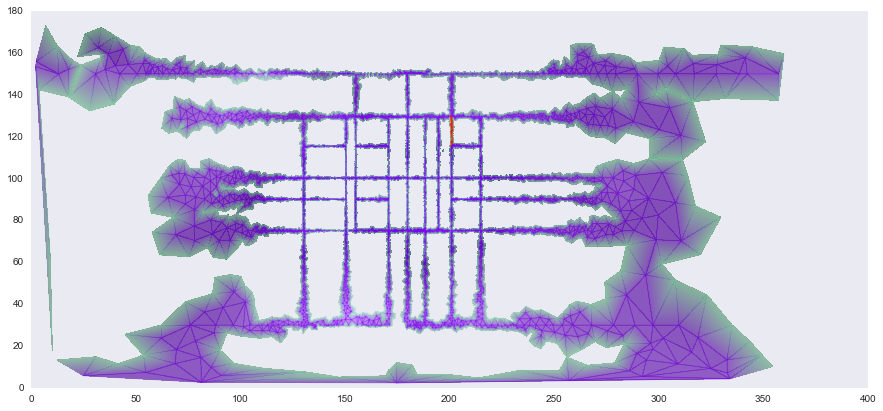

10


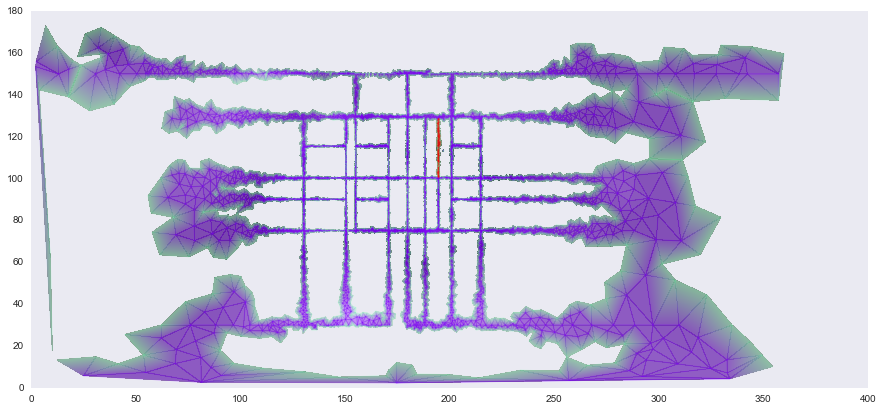

11


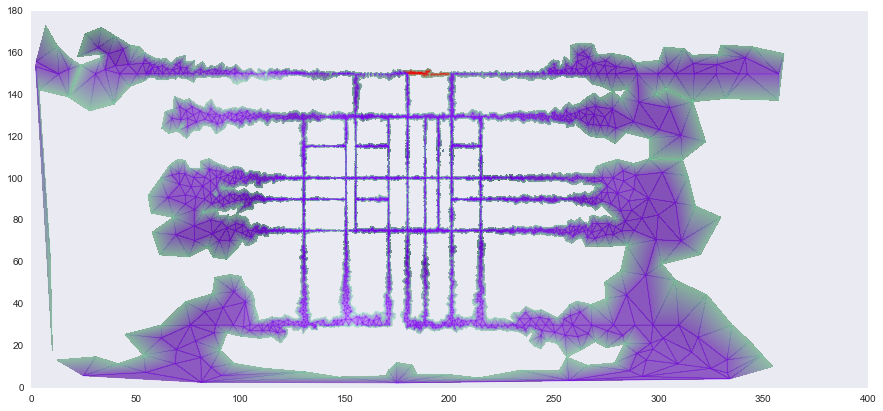

12


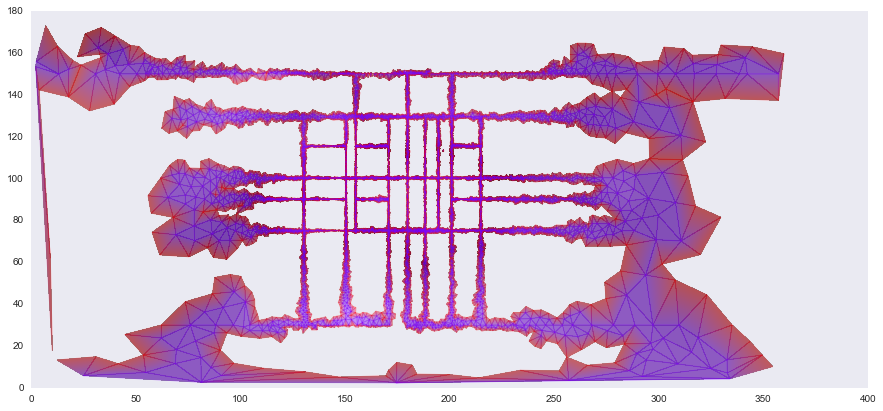

13


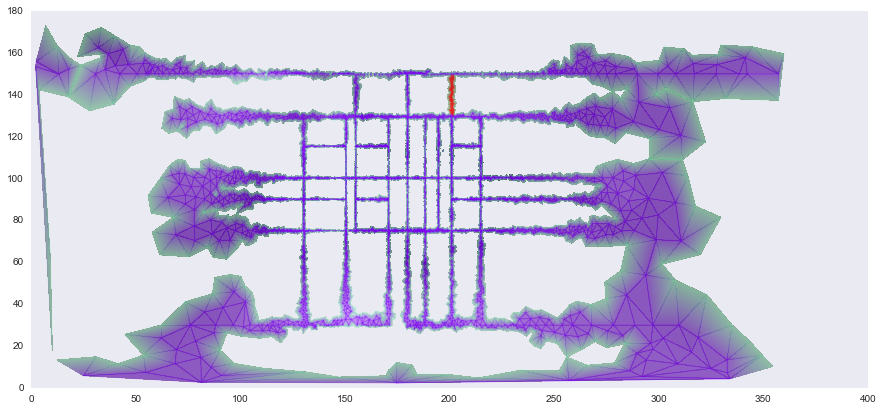

14


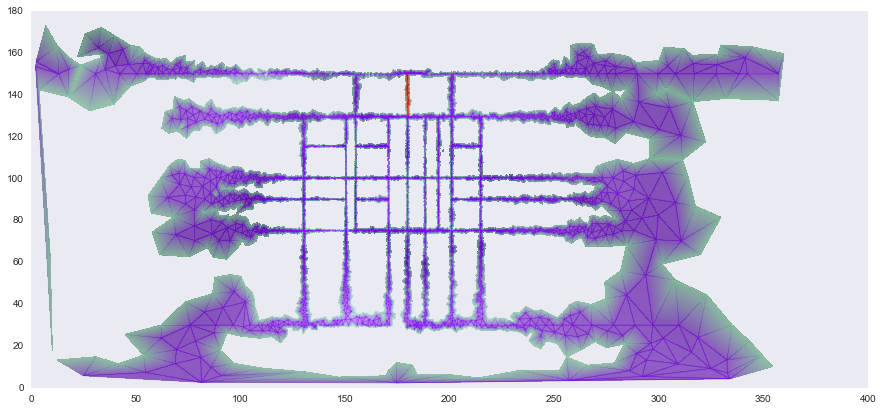

15


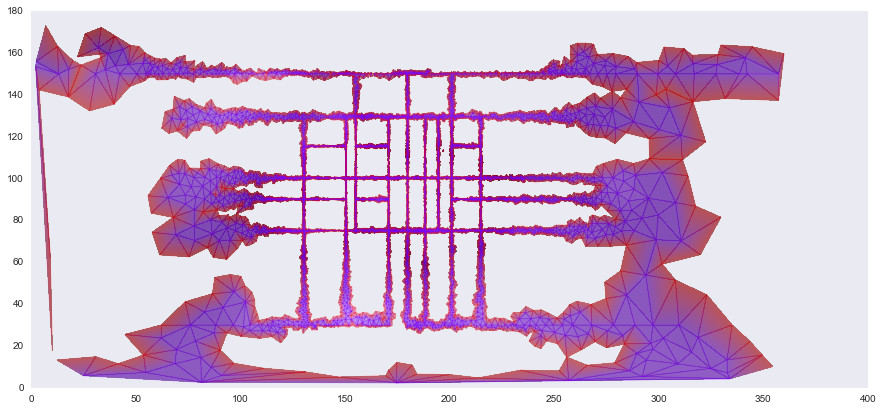

16


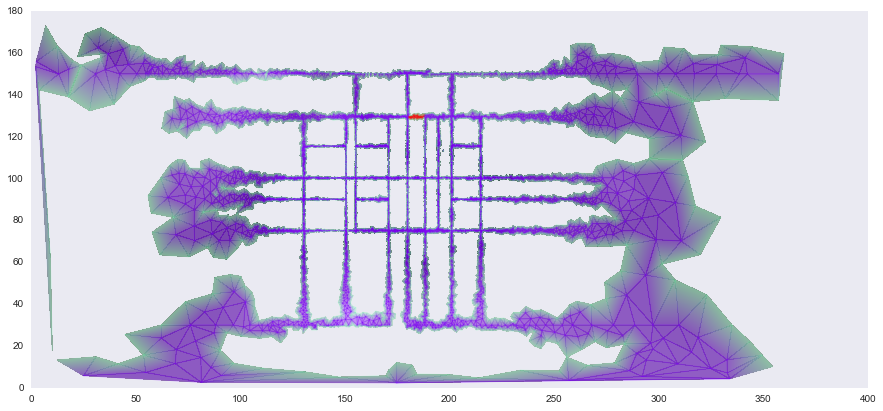

17


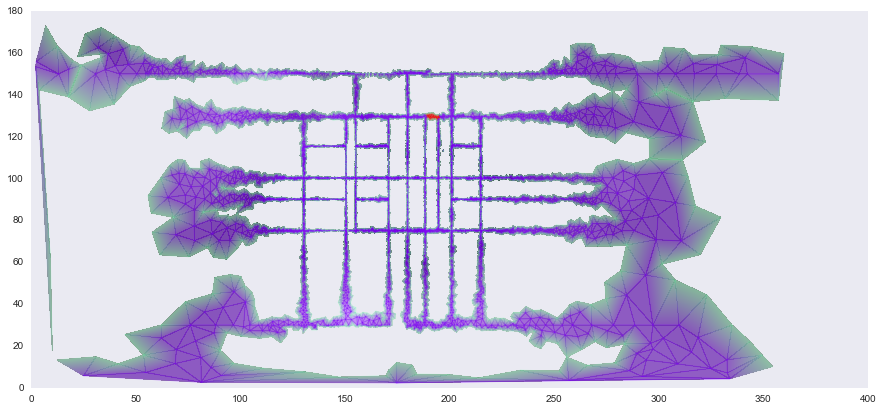

18


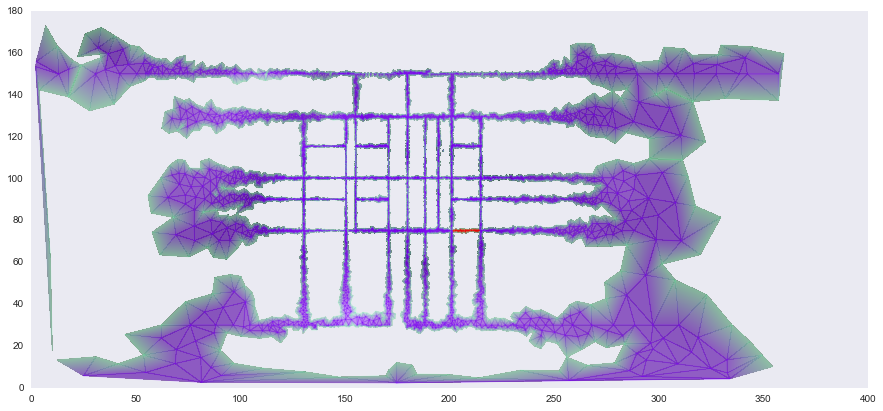

19


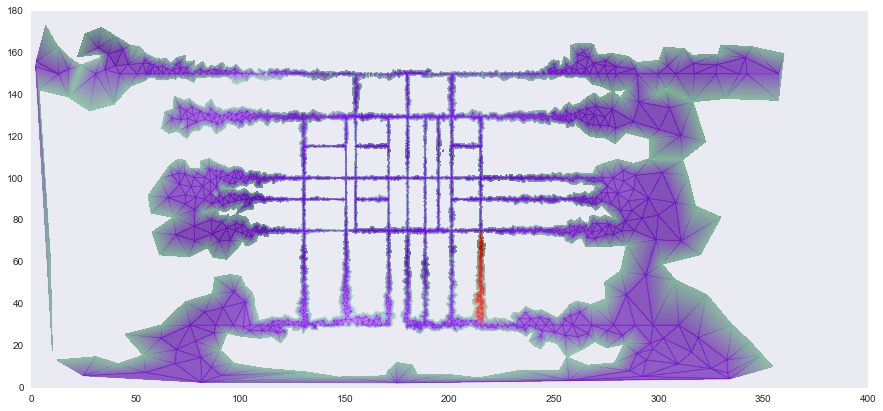

20


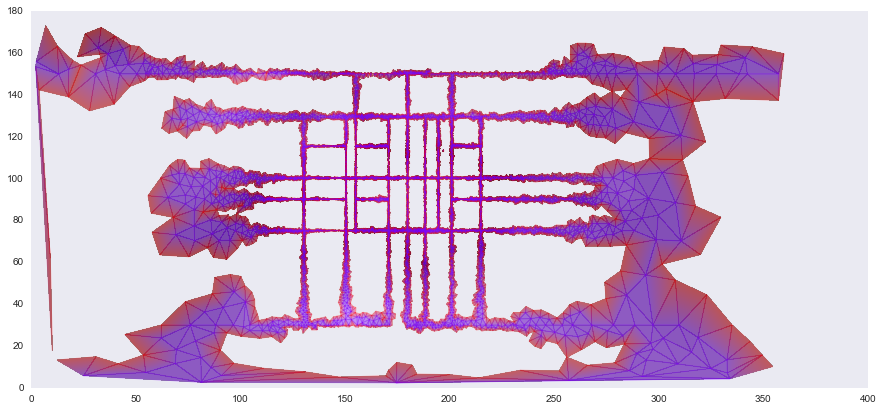

21


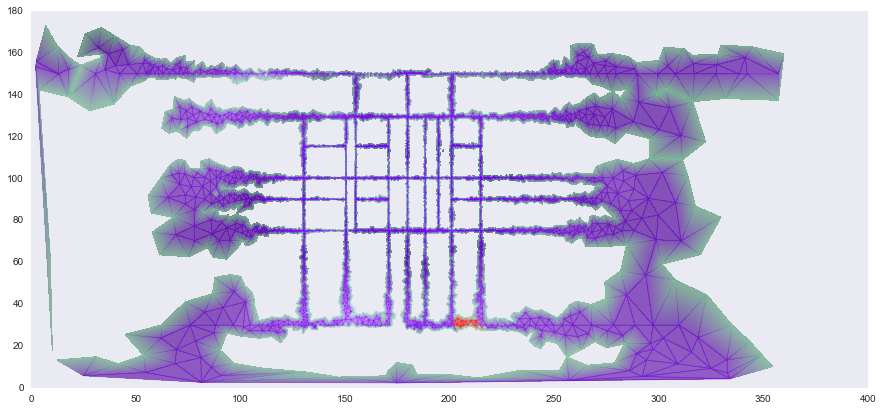

22


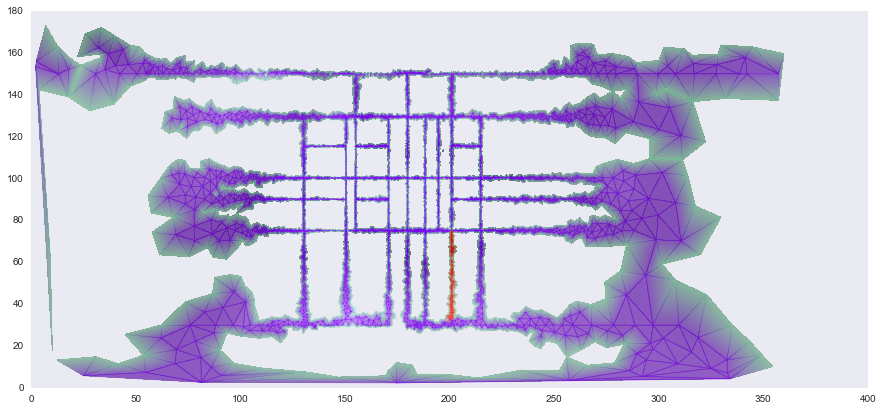

23


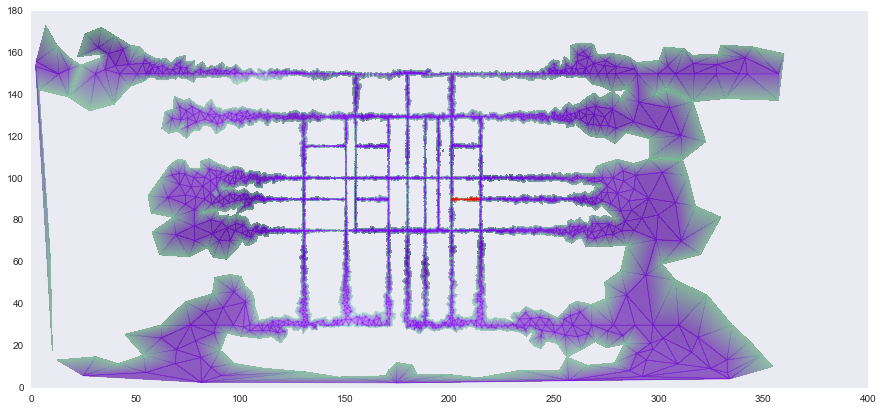

24


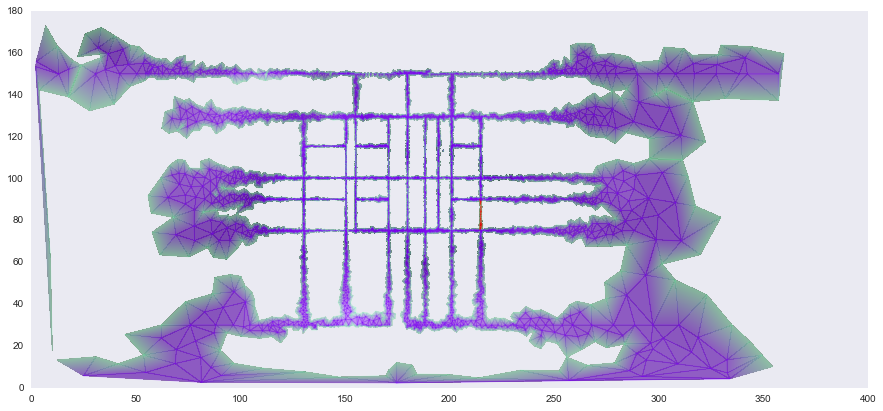

25


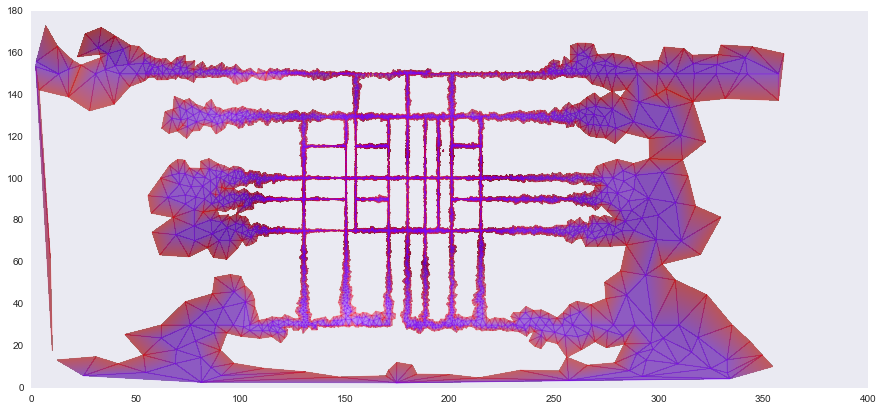

26


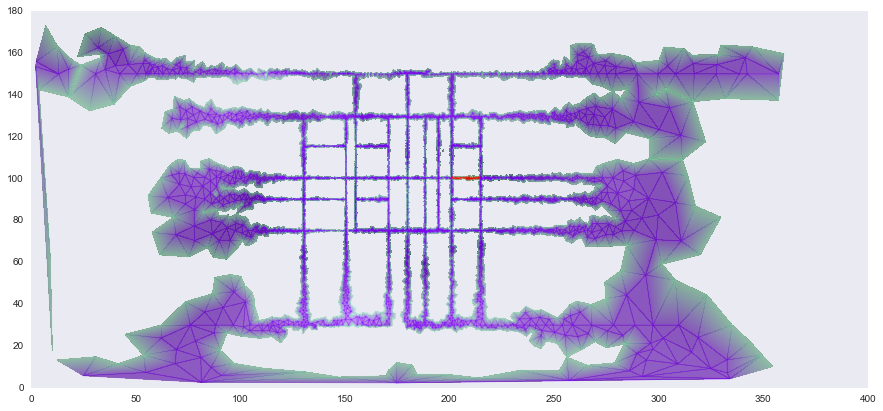

27


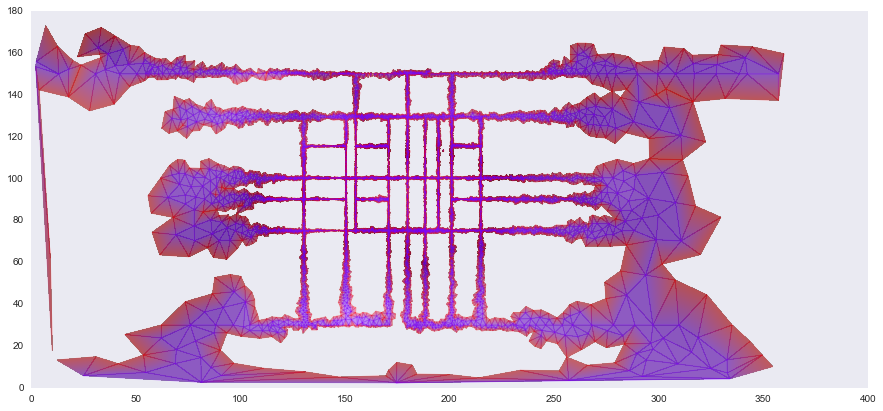

28


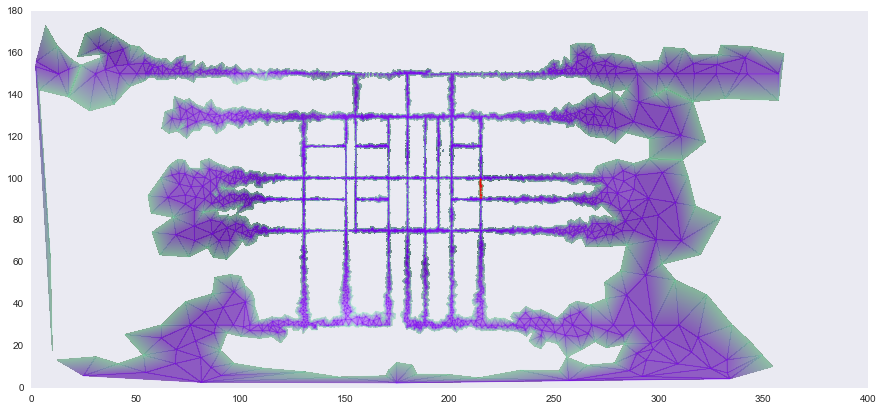

29


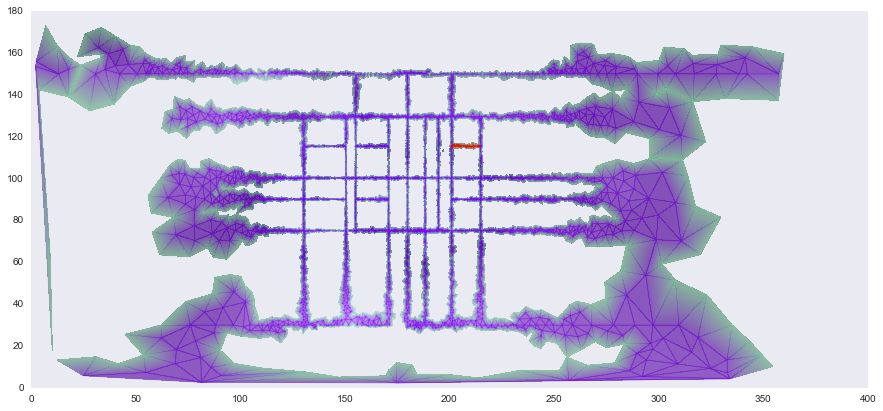

30


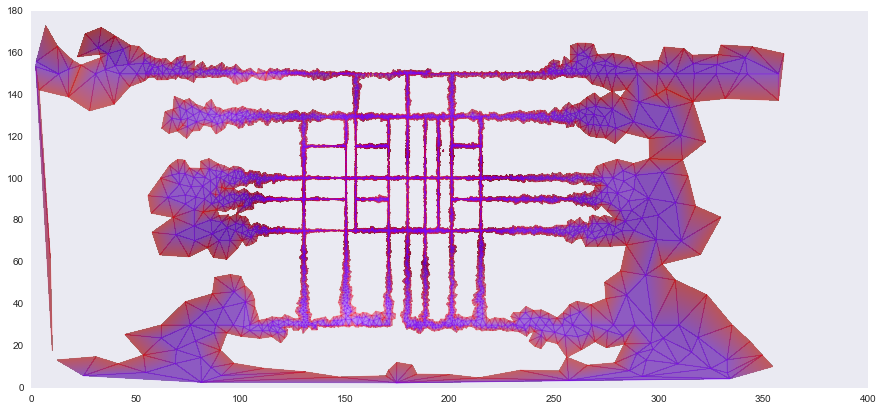

31


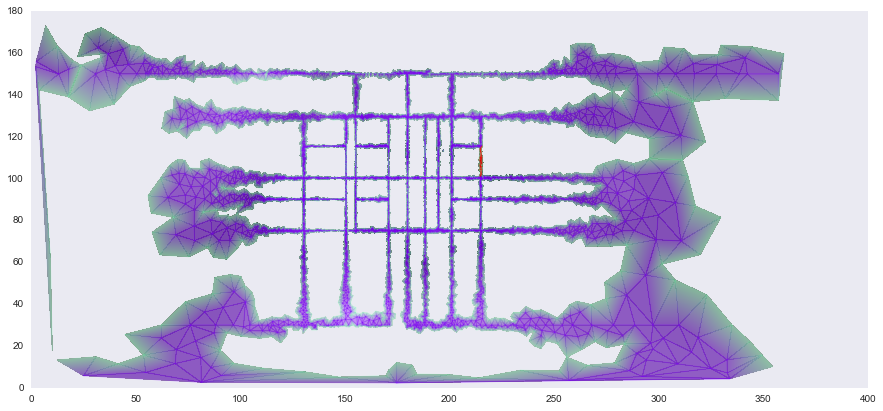

32


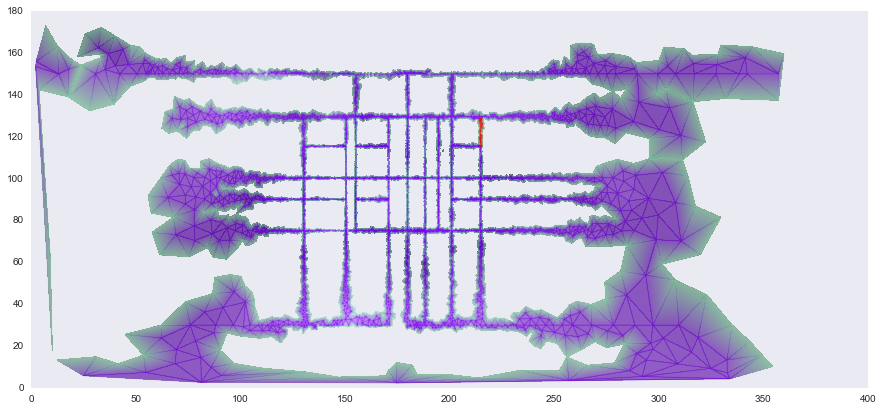

33


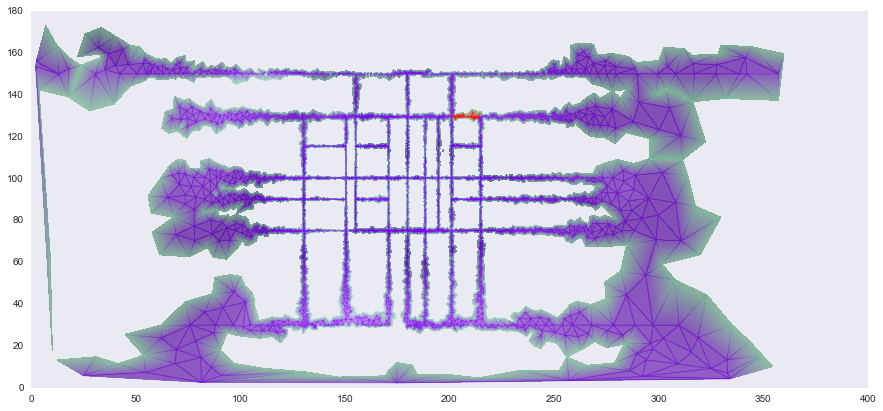

34


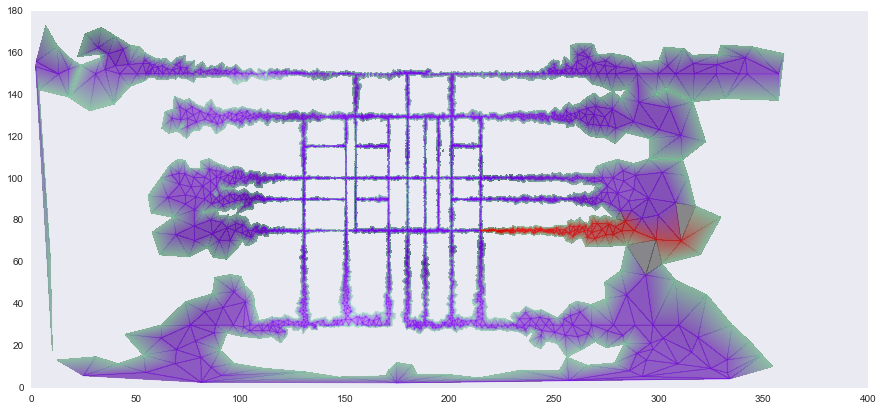

35


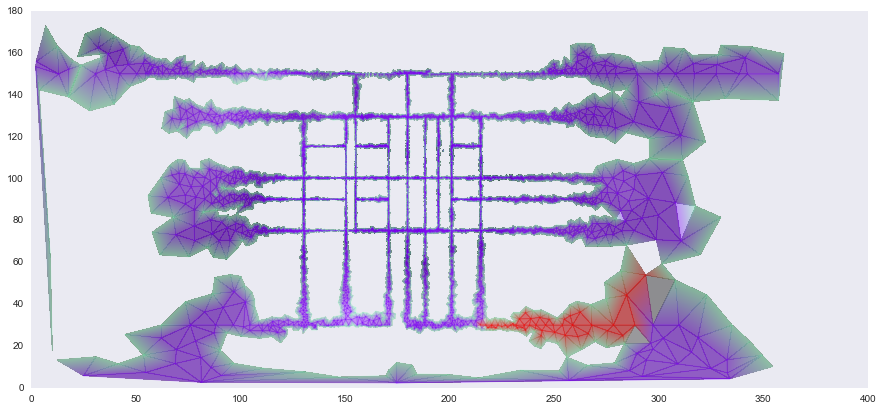

36


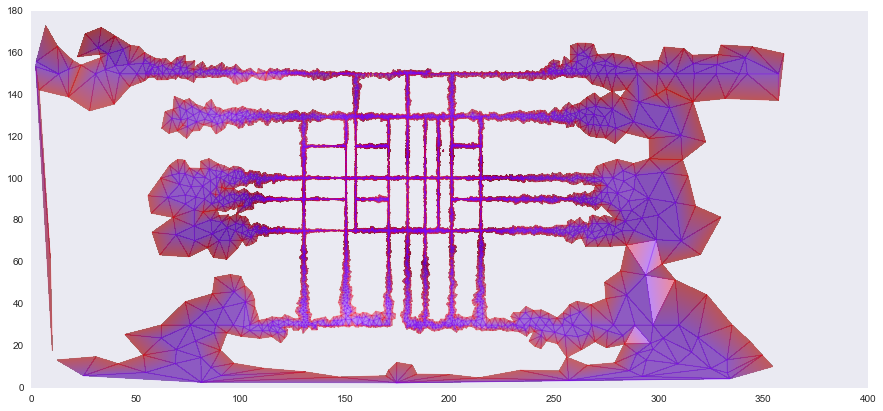

37


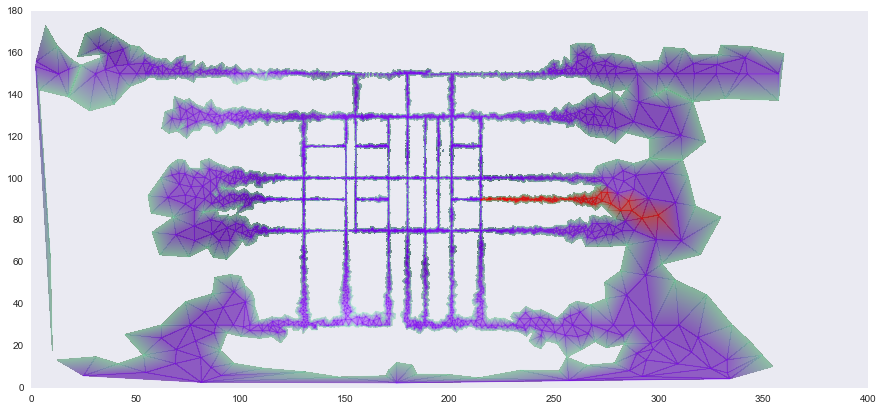

38


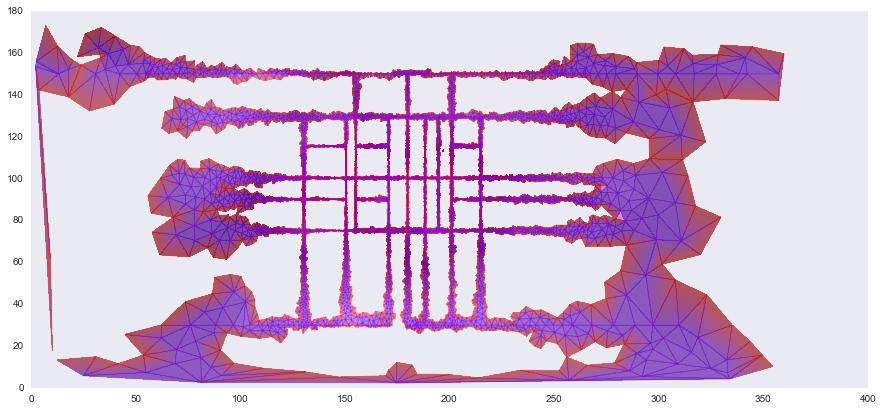

39


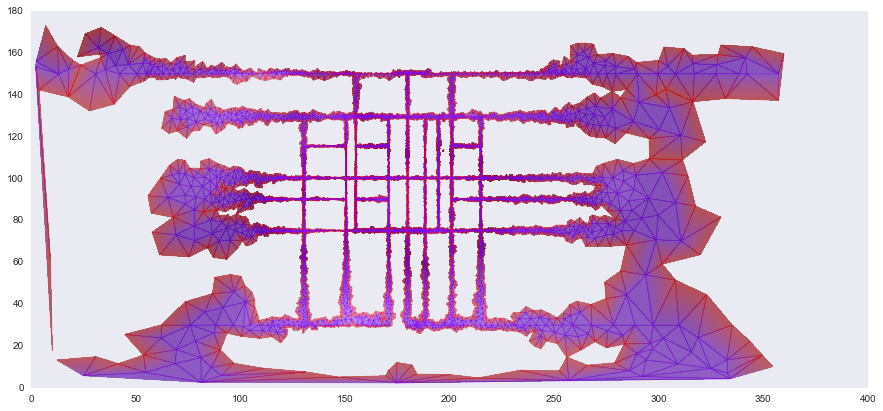

40


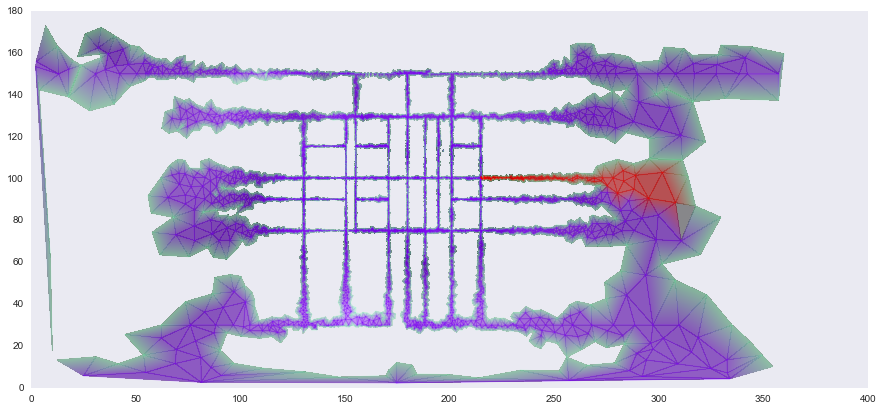

41


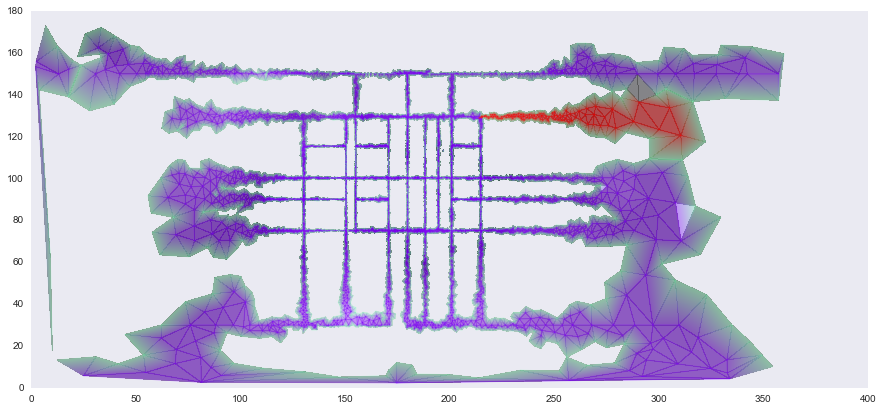

42


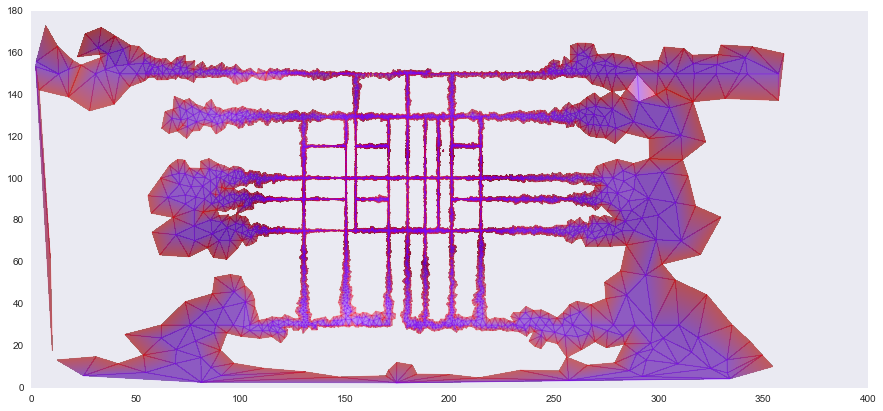

43


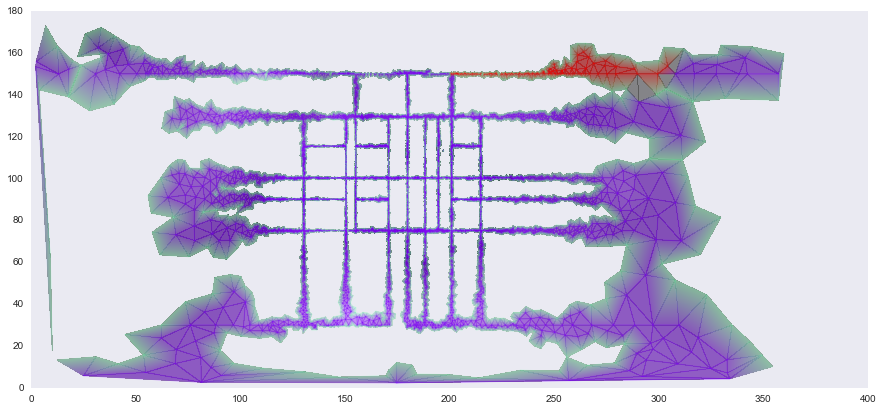

44


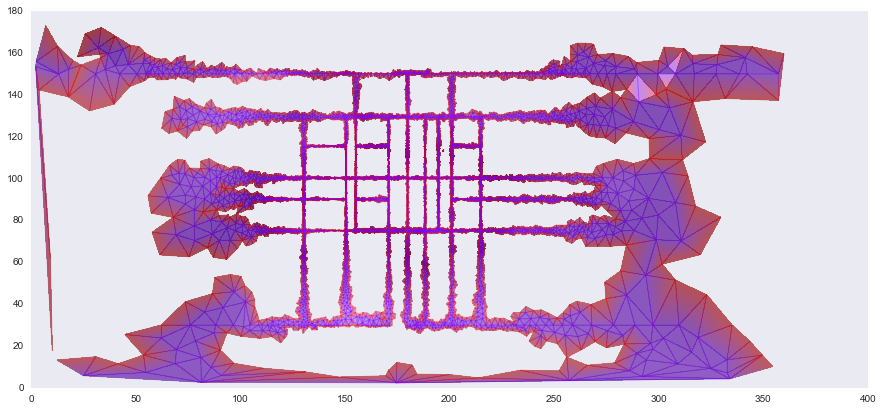

45


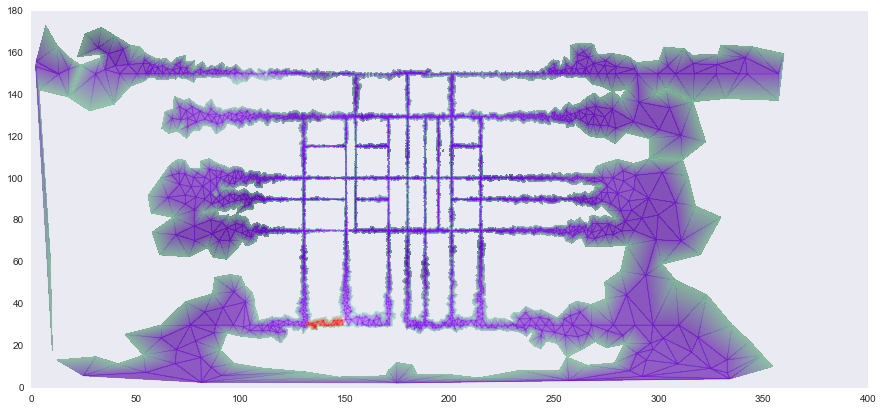

46


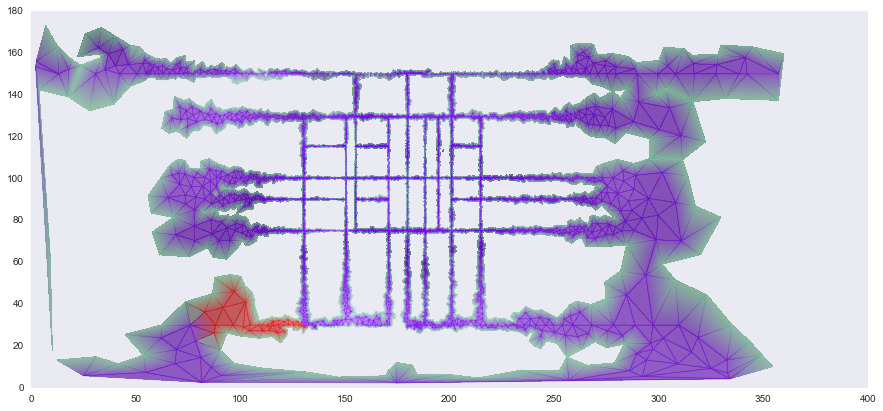

47


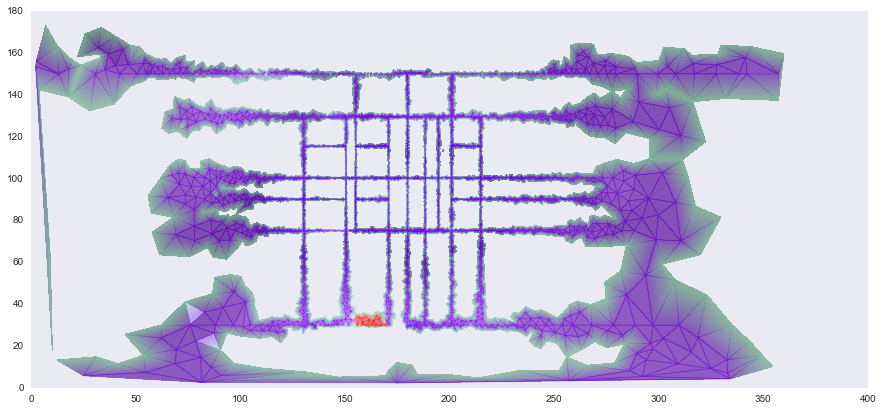

48


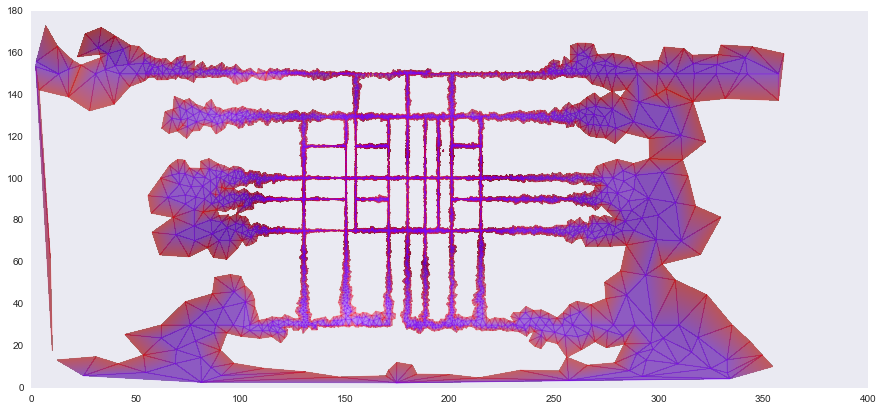

49


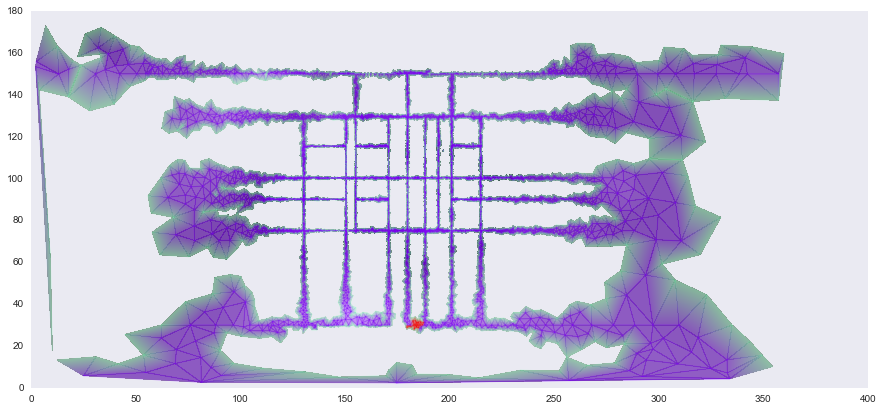

50


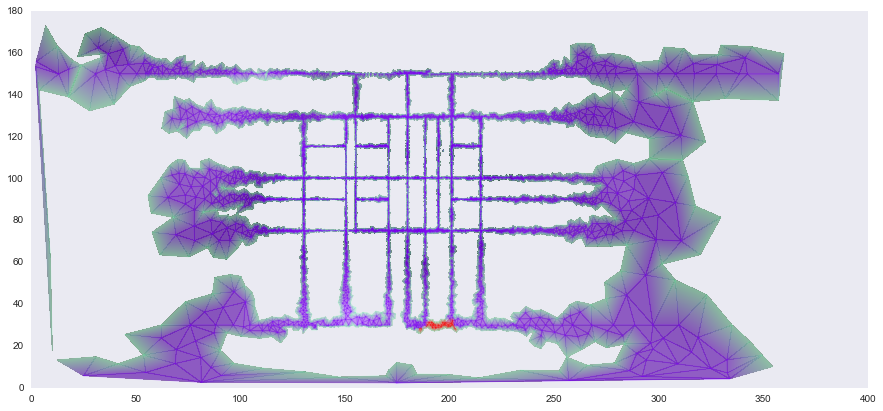

51


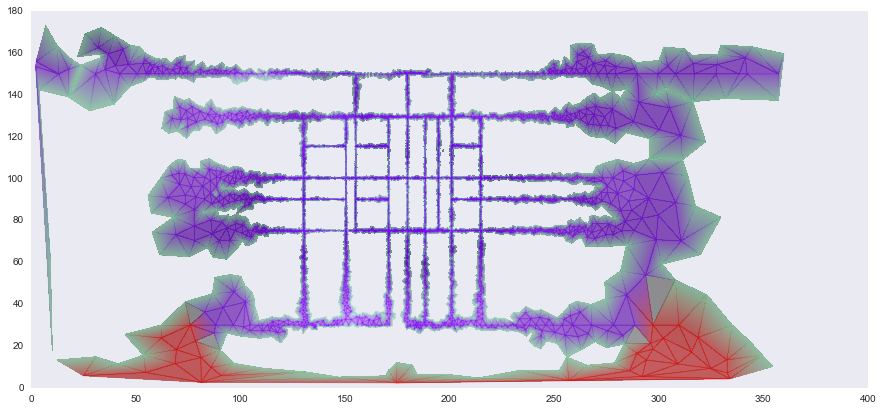

52


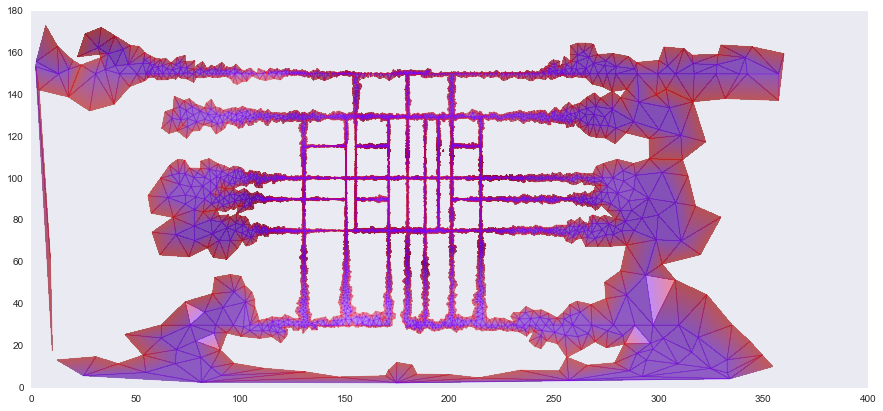

53


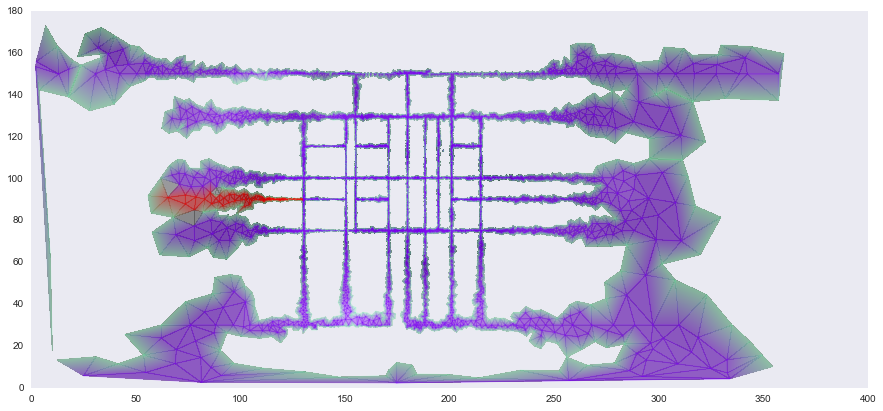

54


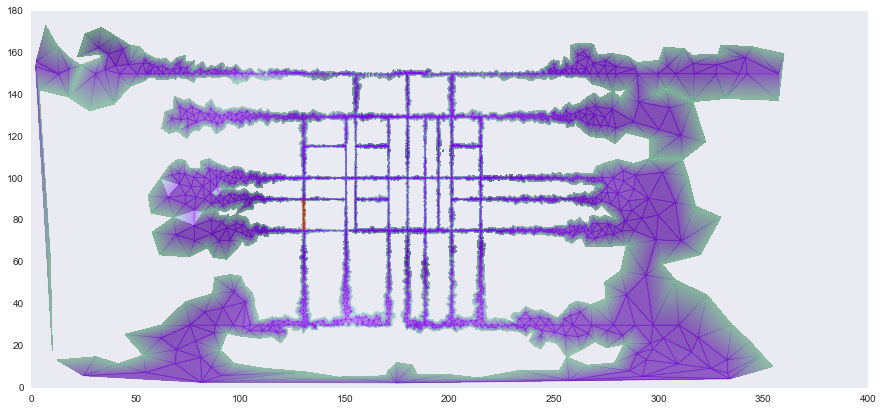

55


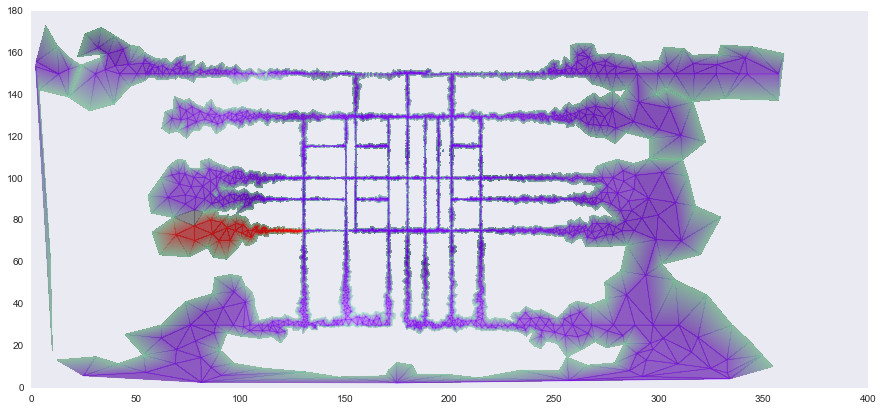

56


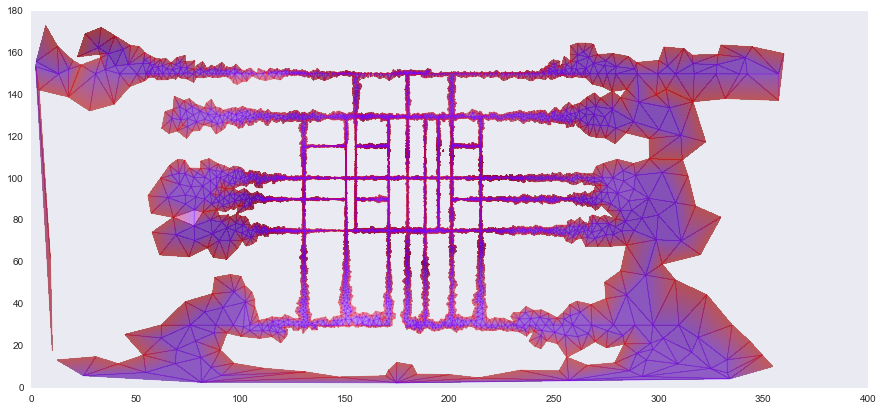

57


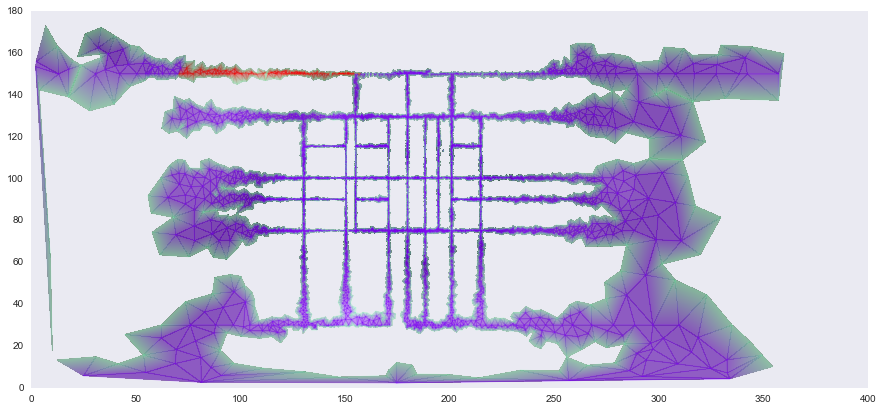

58


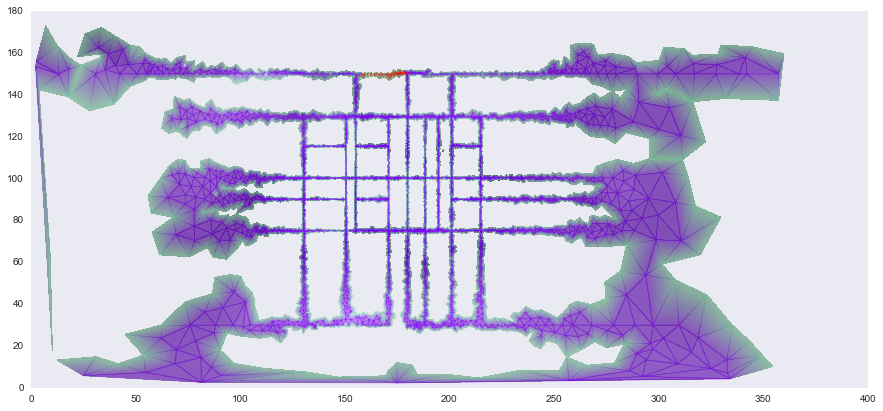

59


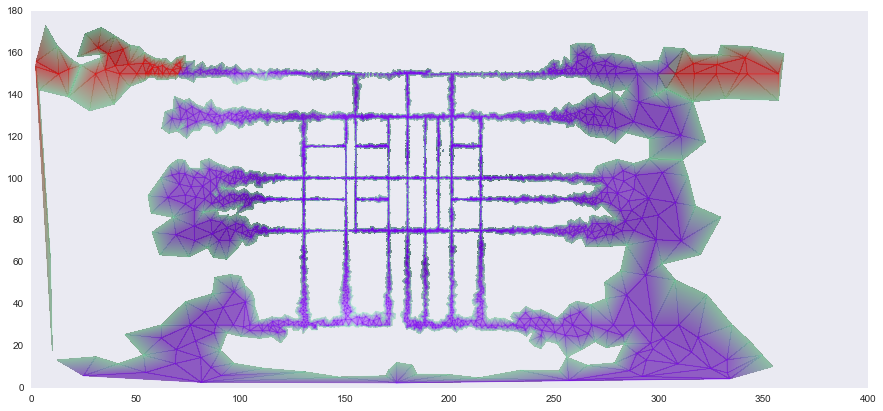

60


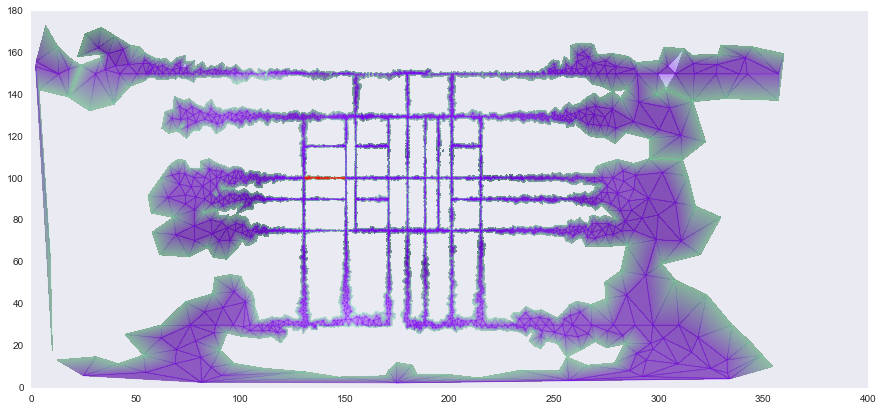

61


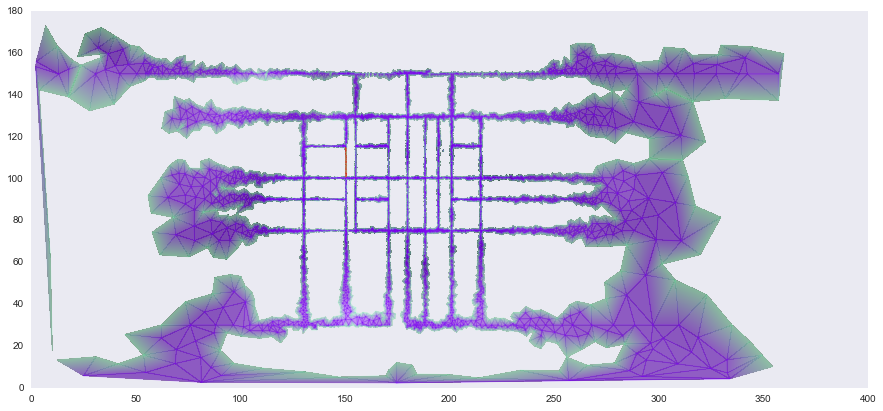

62


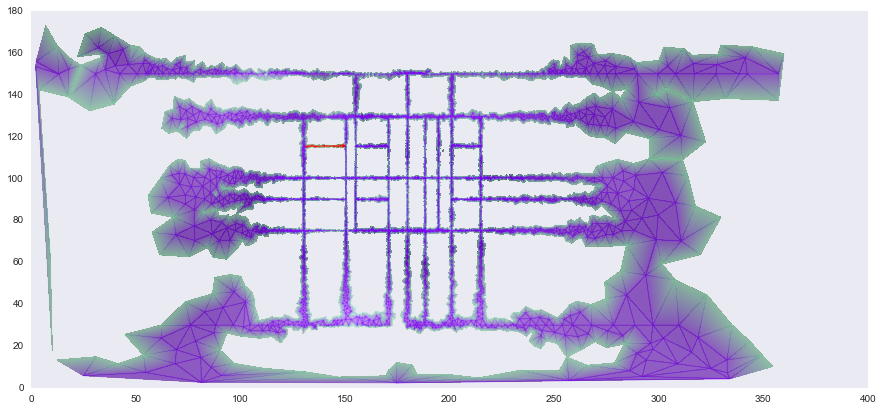

63


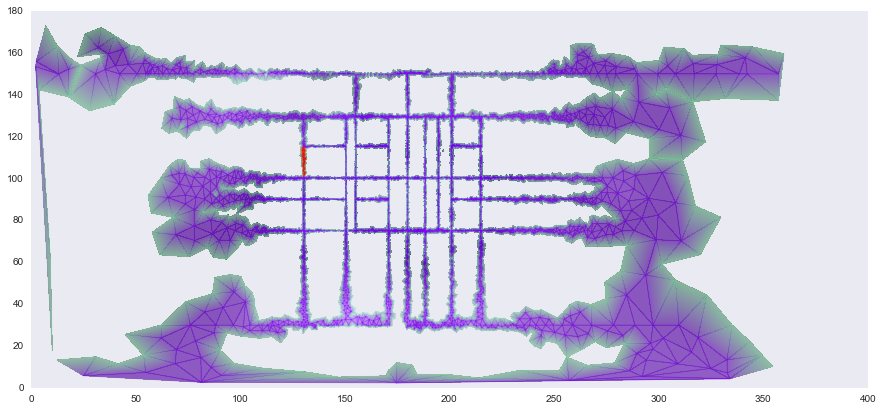

64


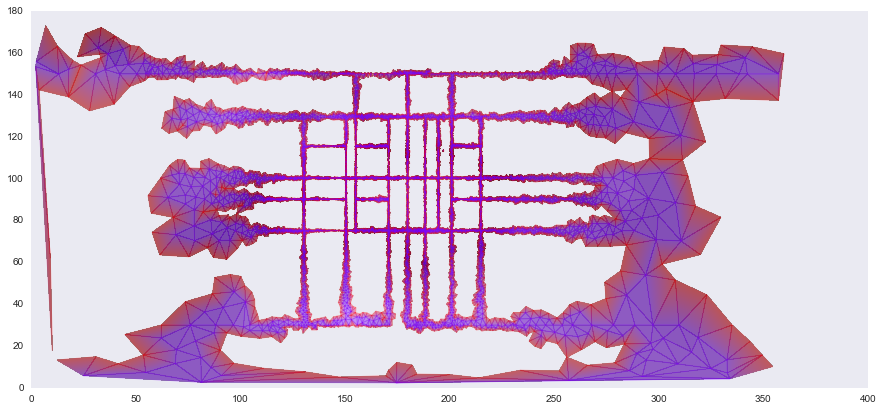

65


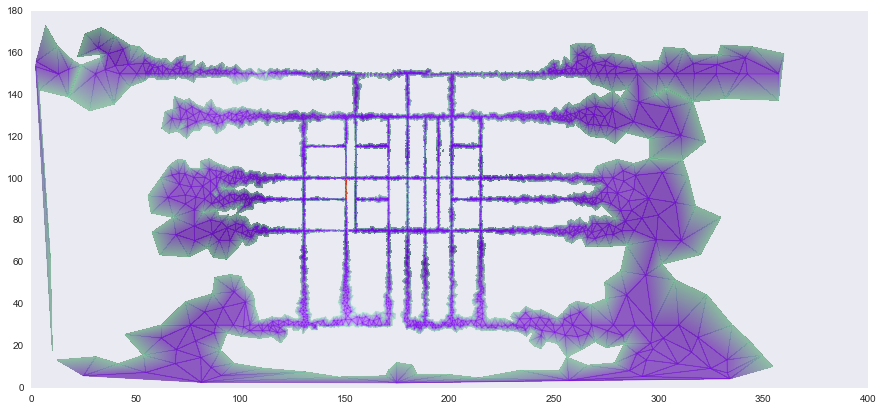

66


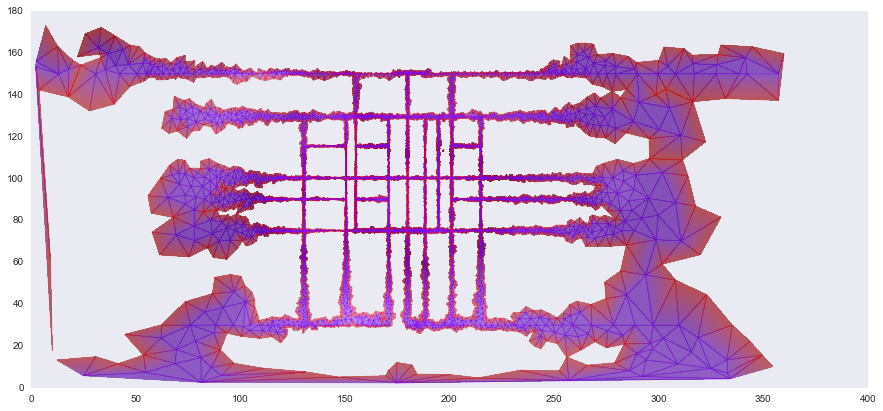

67


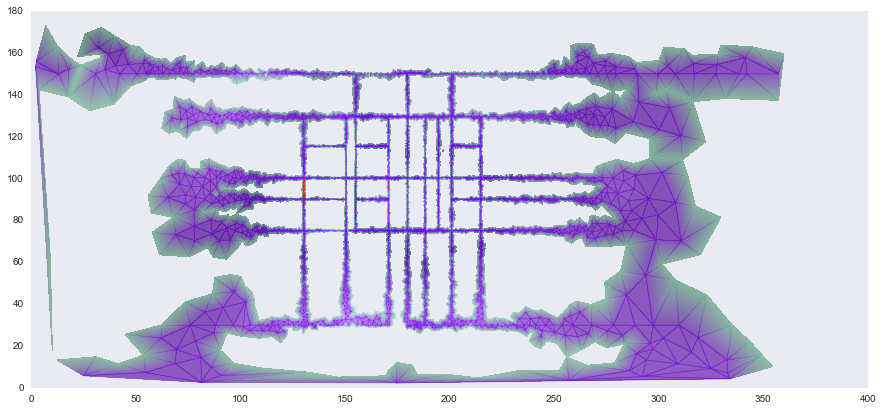

68


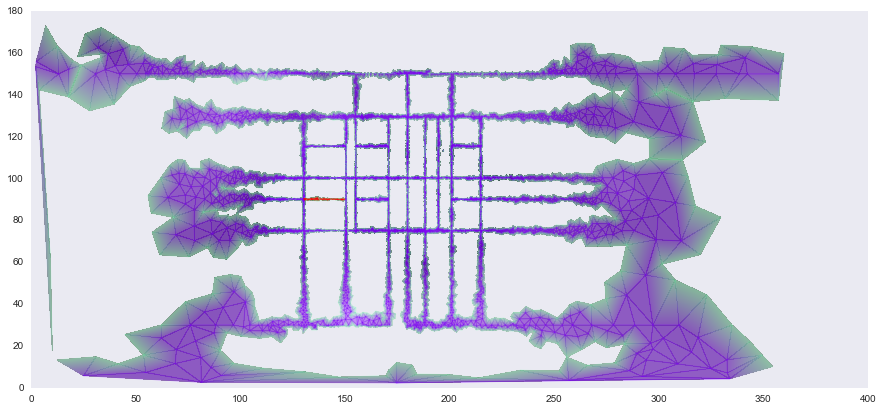

69


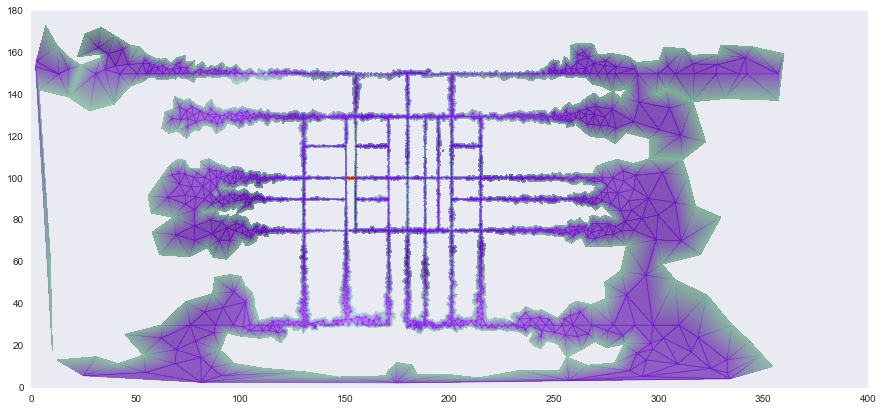

70


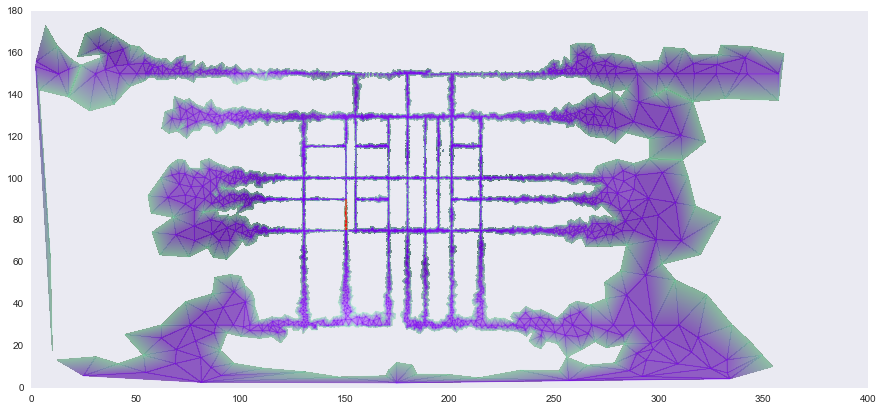

71


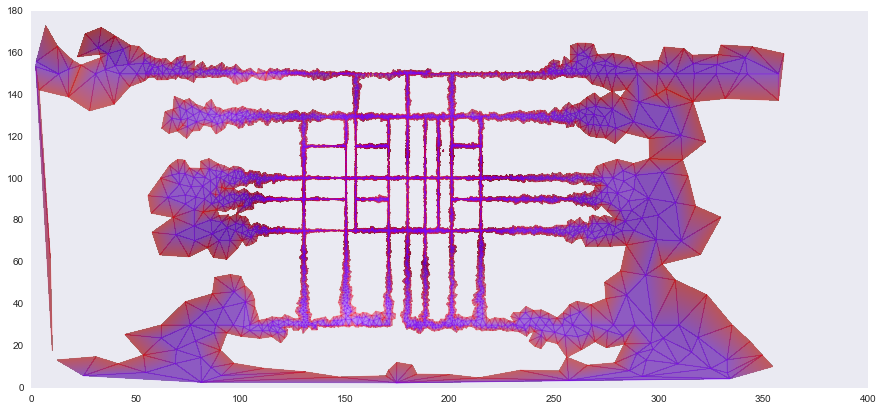

72


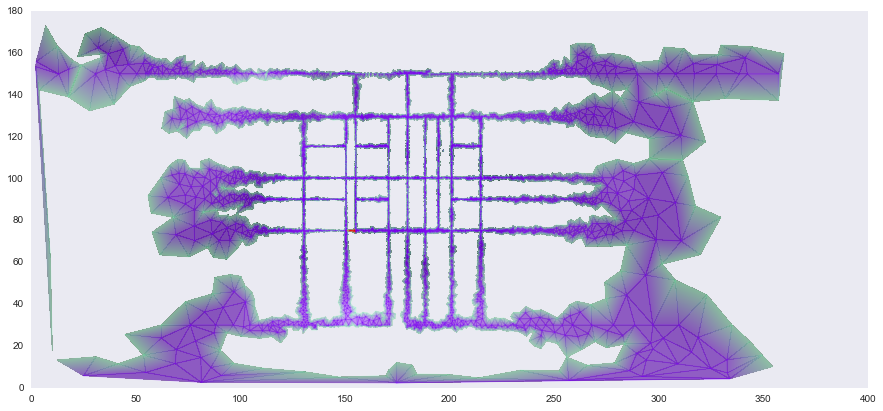

73


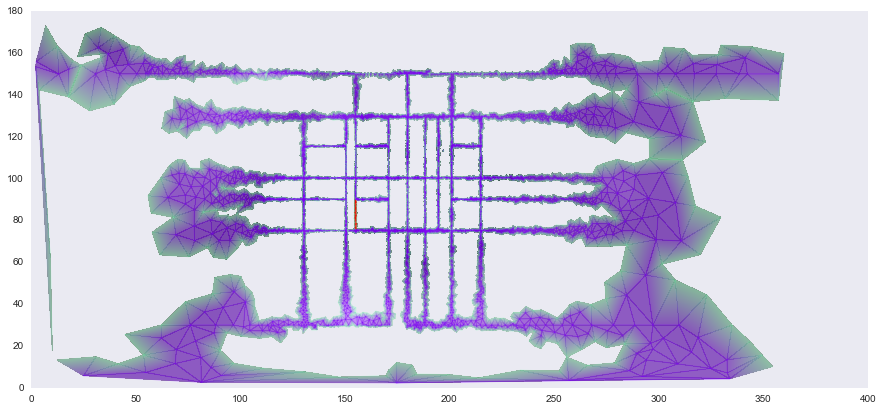

74


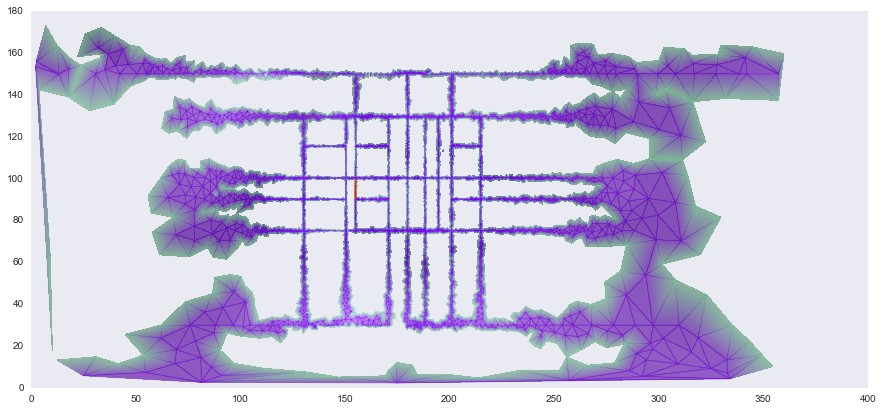

75


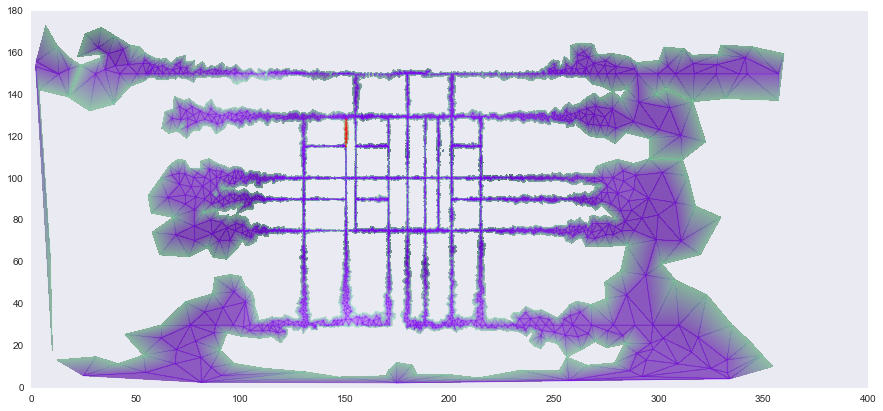

76


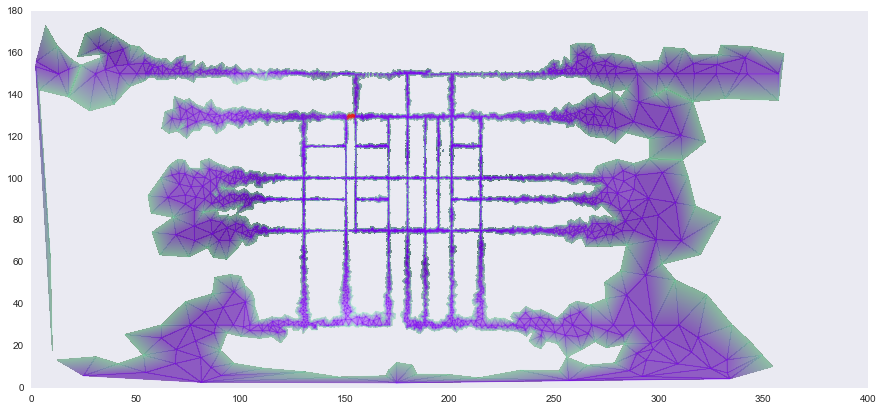

77


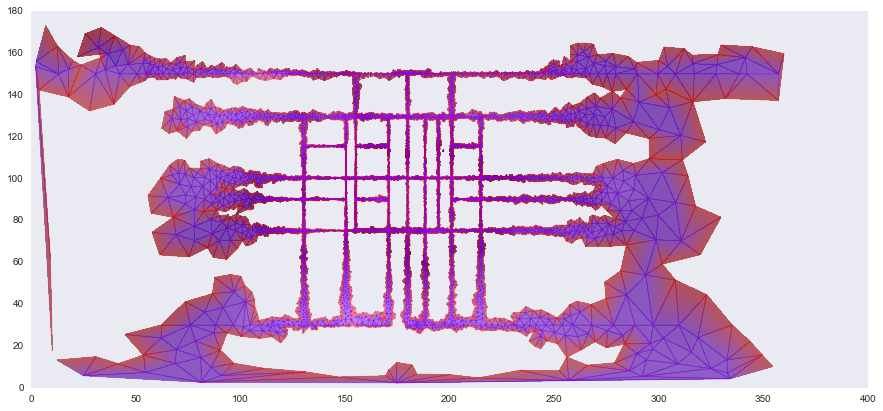

78


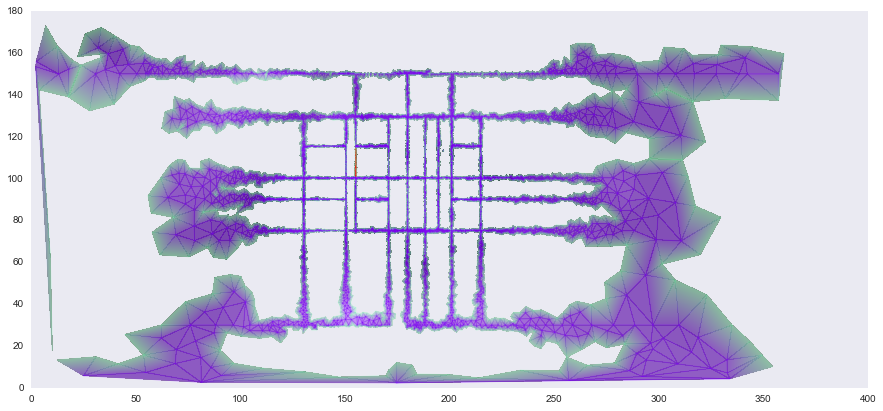

79


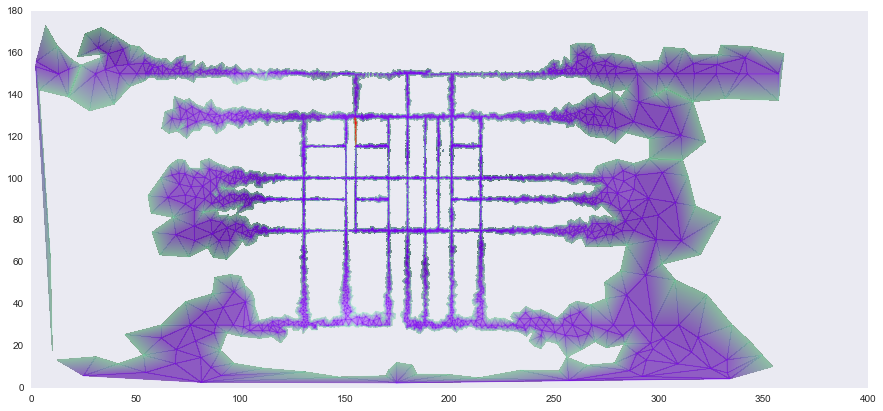

80


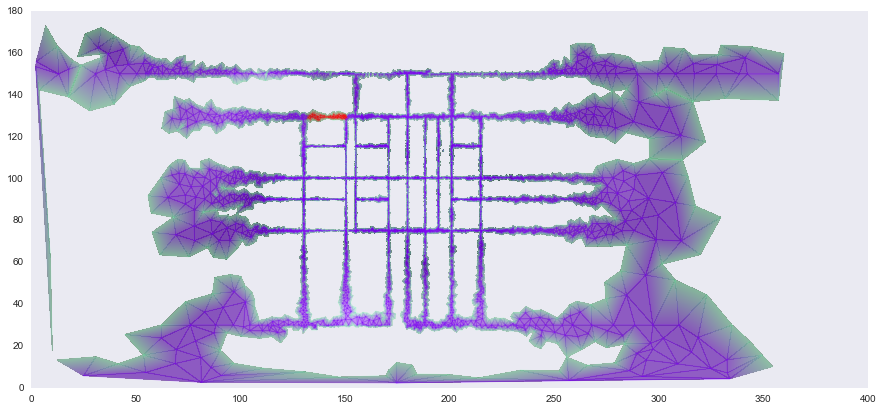

81


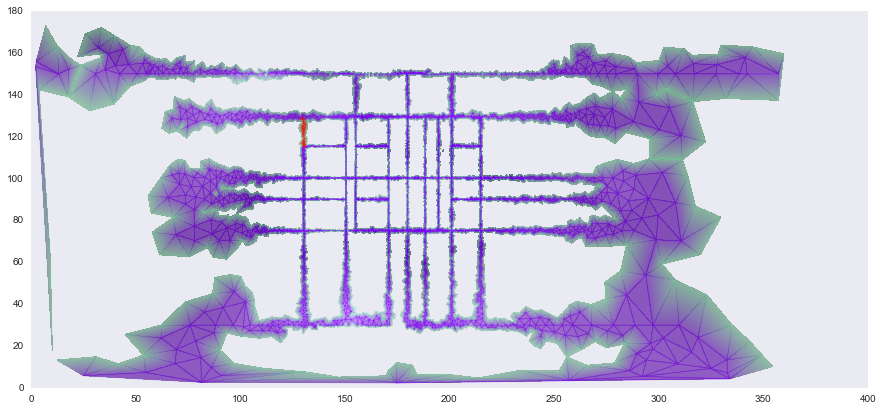

82


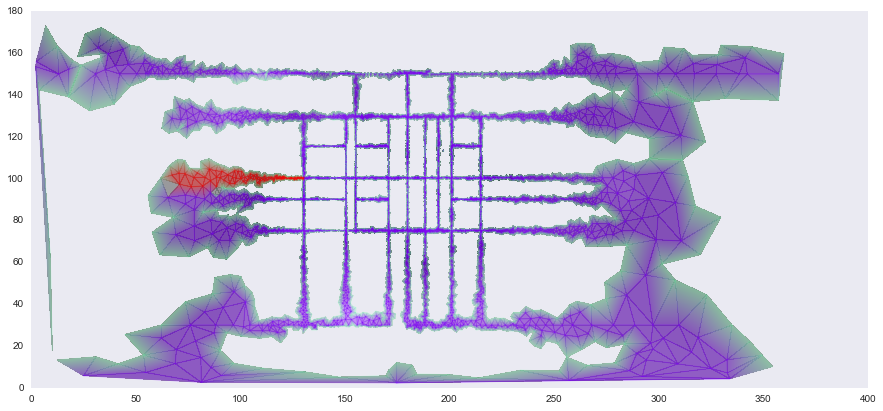

83


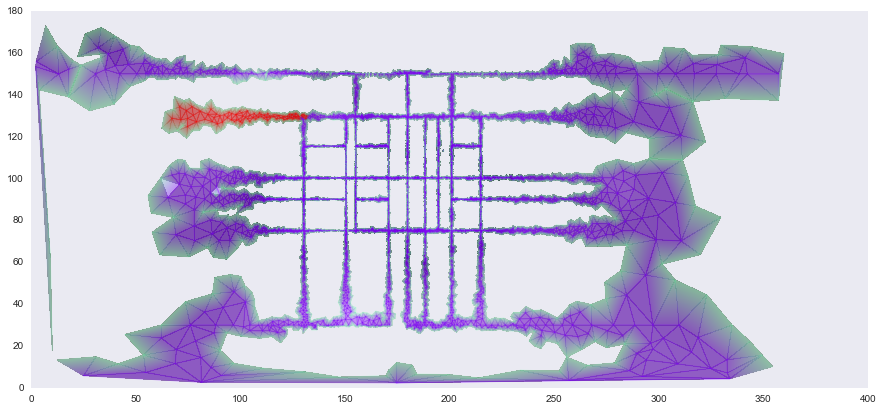

84


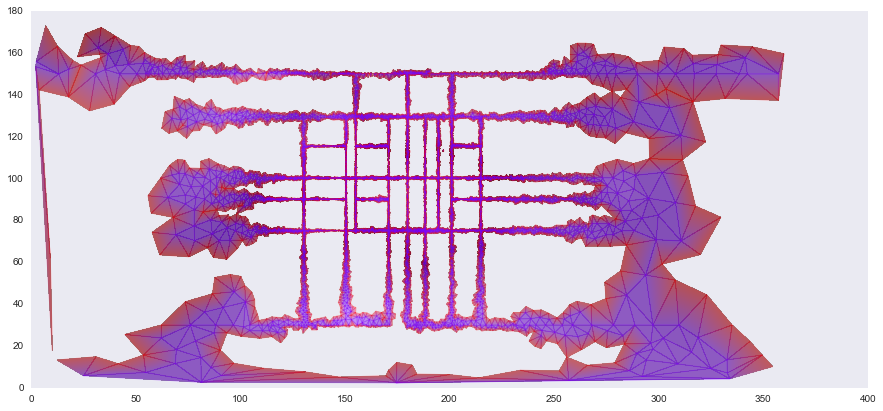

85


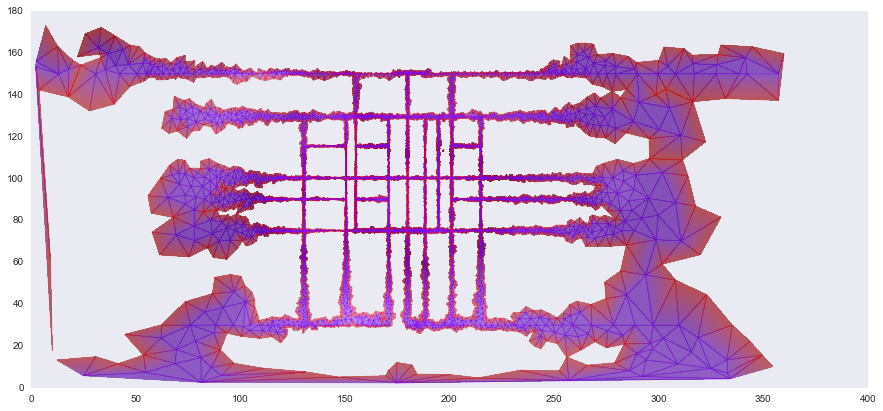

86


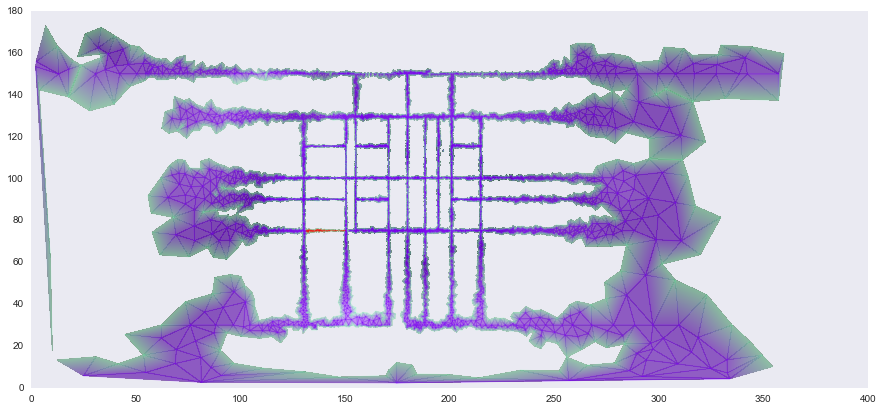

87


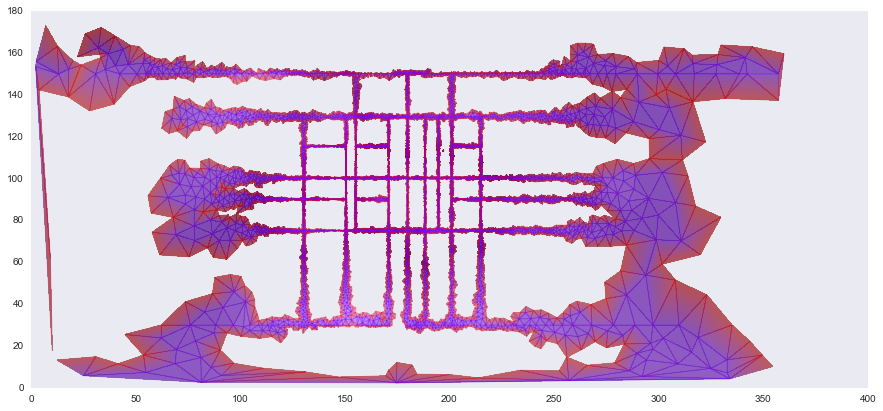

88


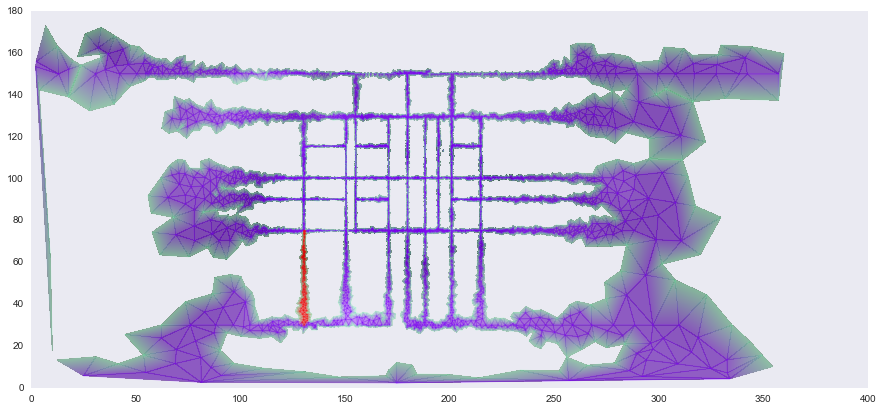

89


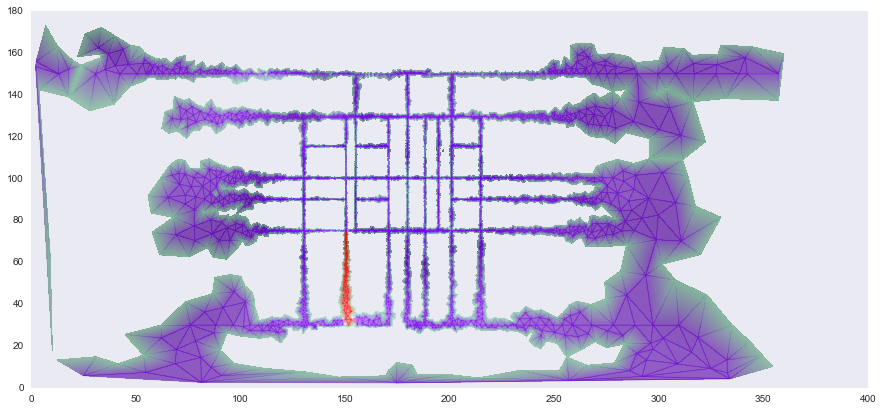

90


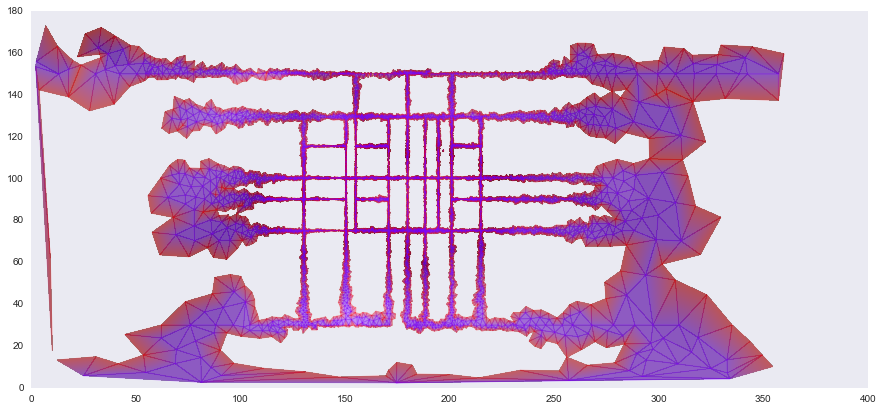

91


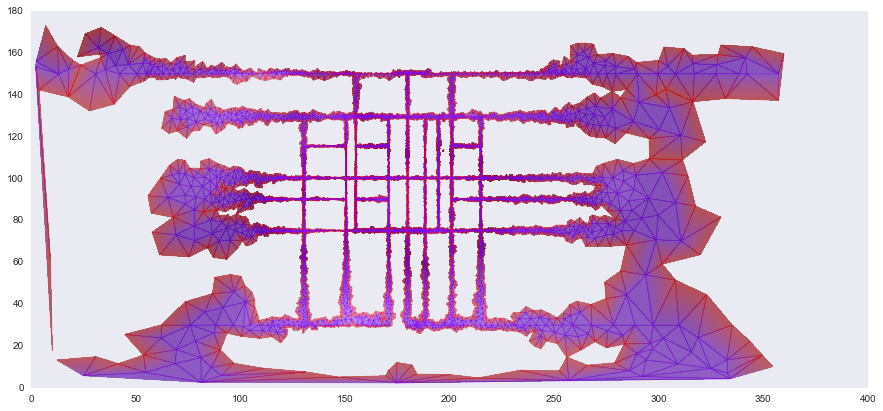

92


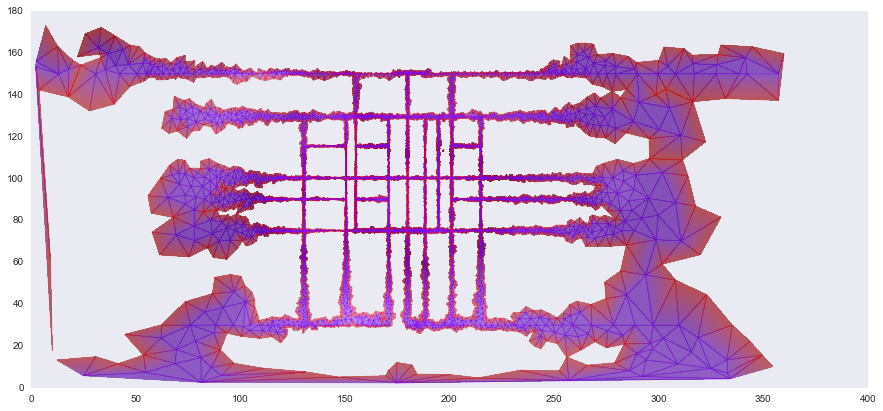

93


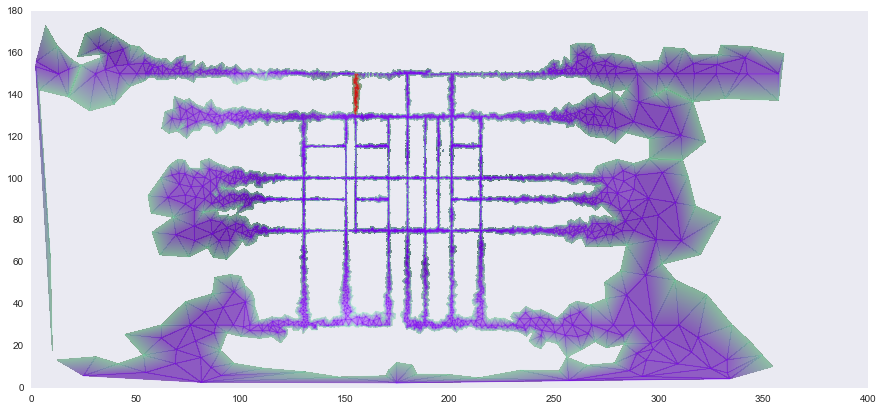

94


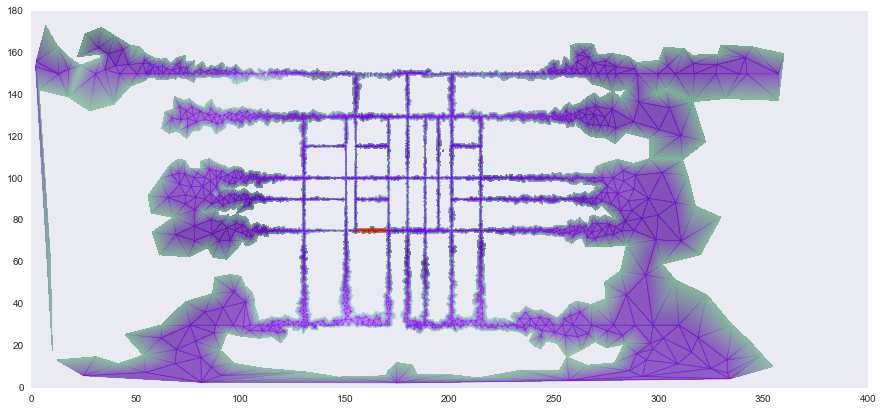

95


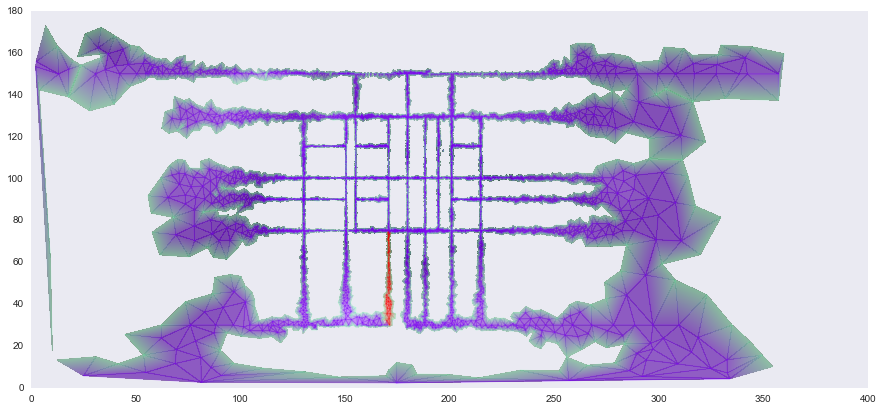

96


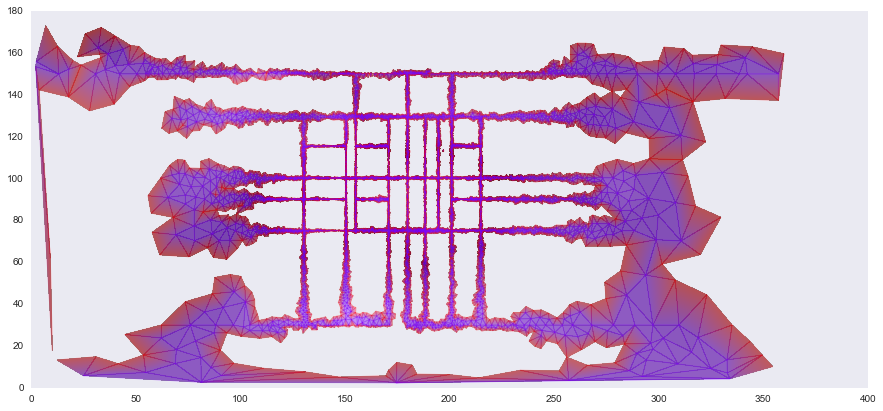

97


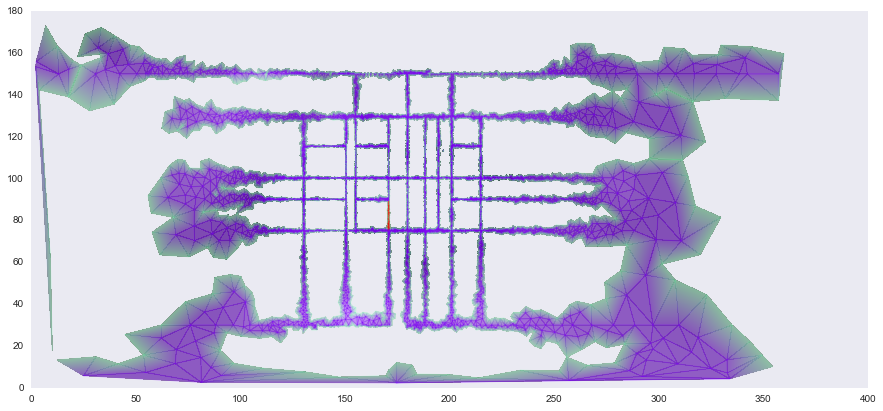

98


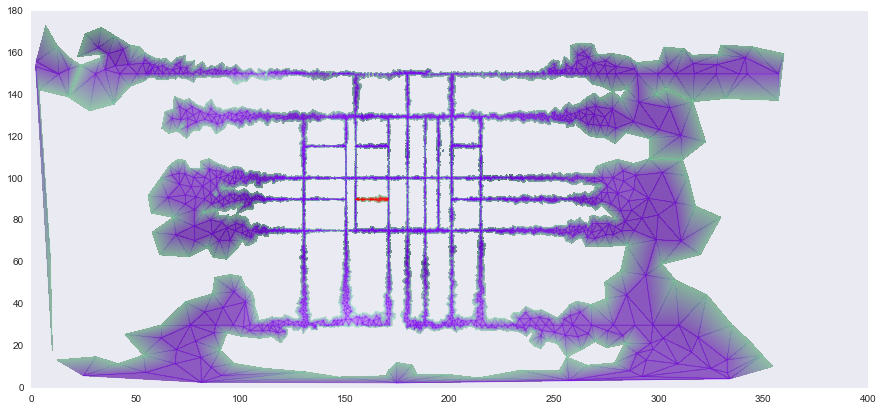

99


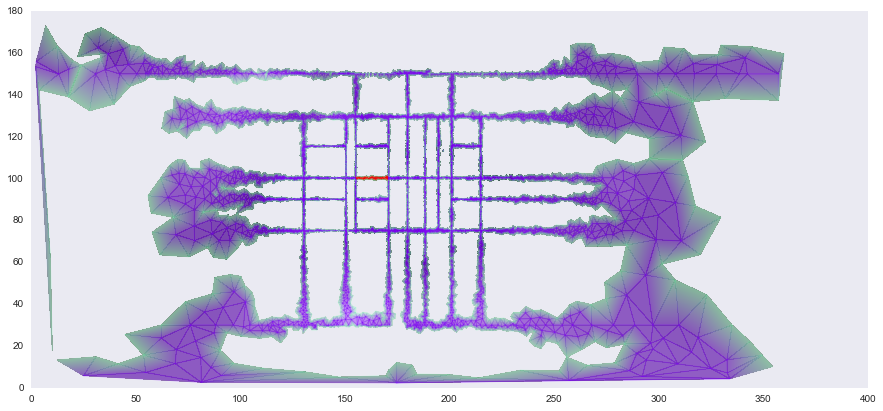

100


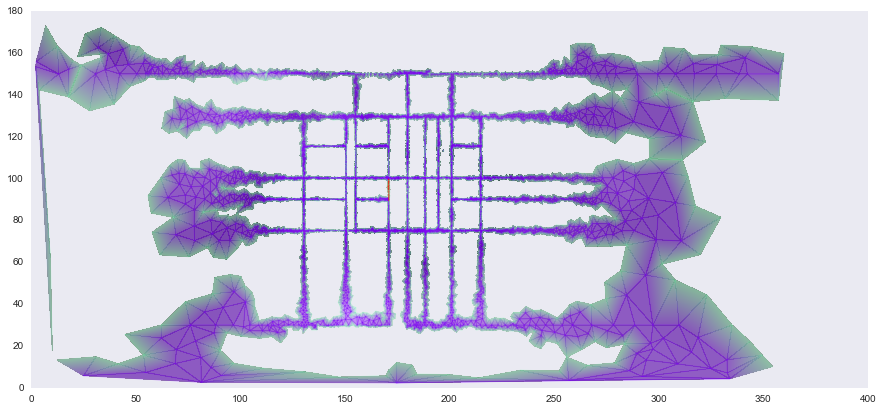

101


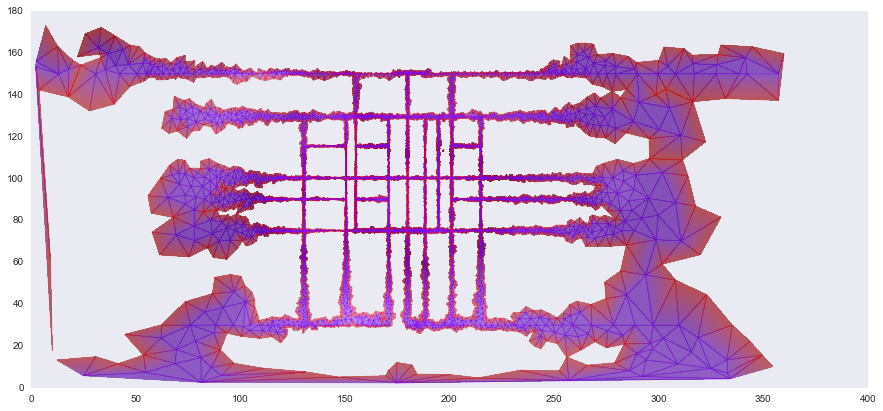

102


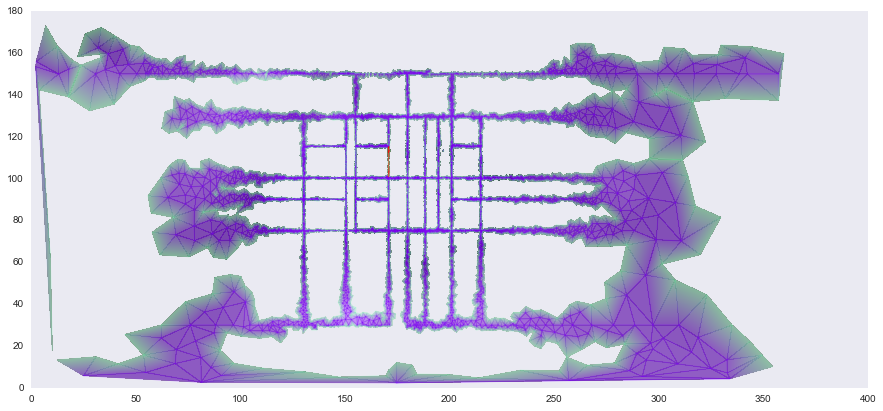

103


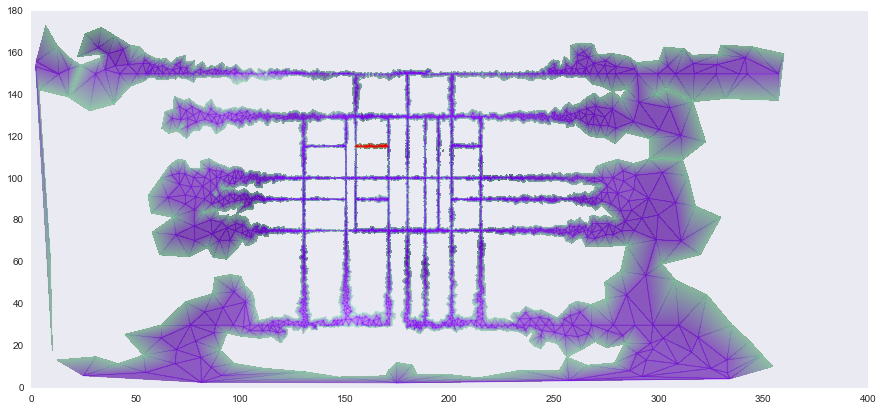

104


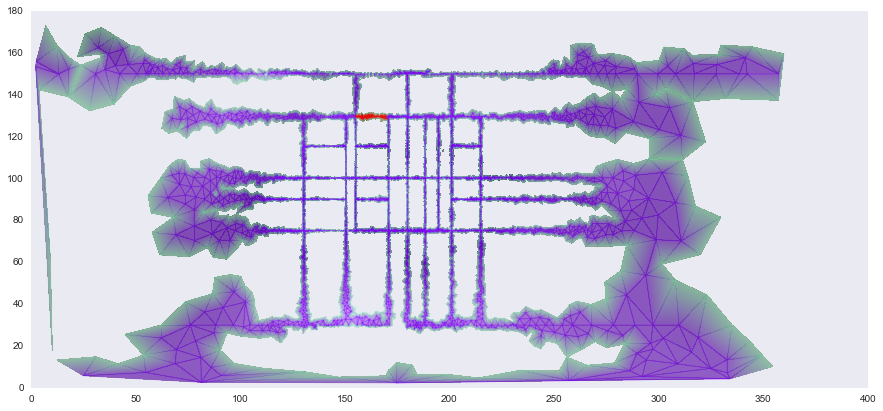

105


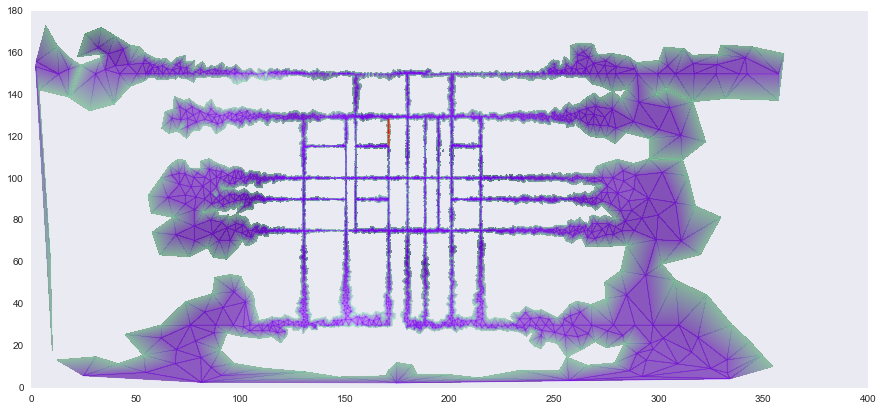

106


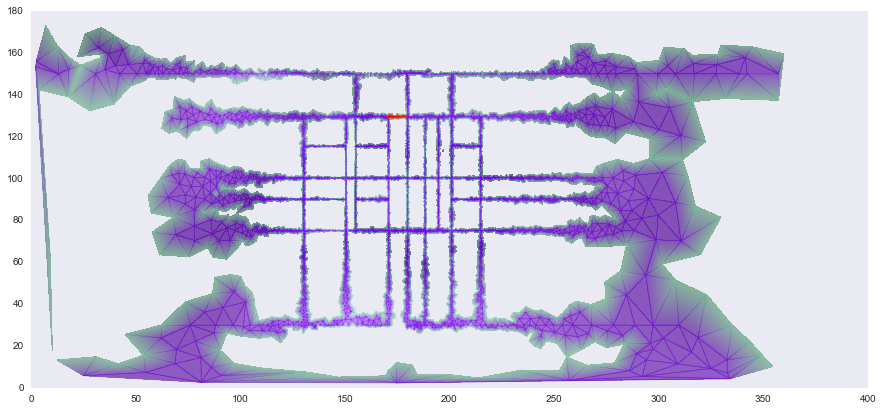

107


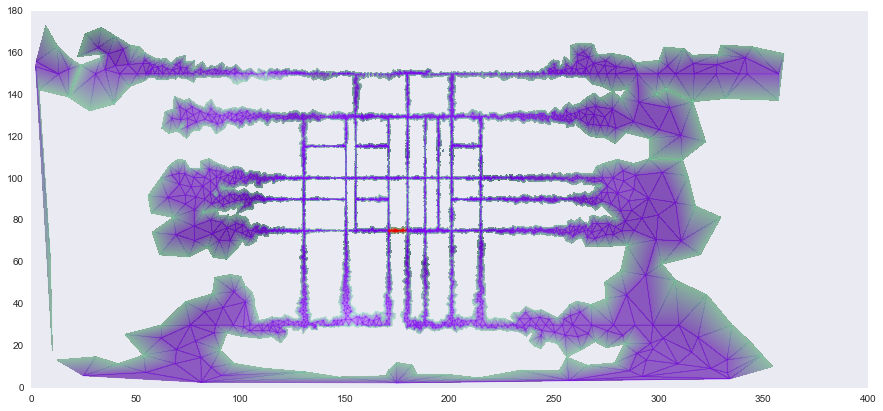

108


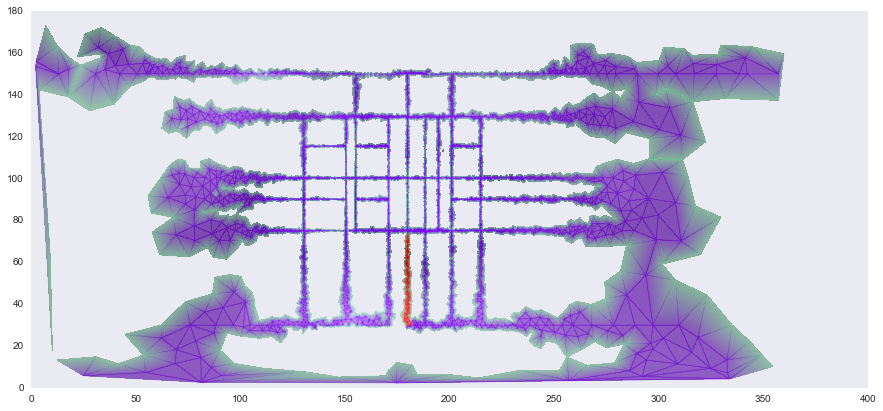

109


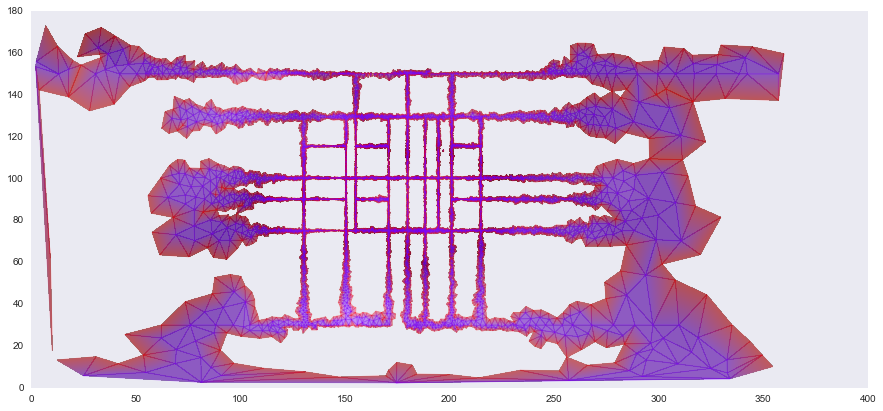

110


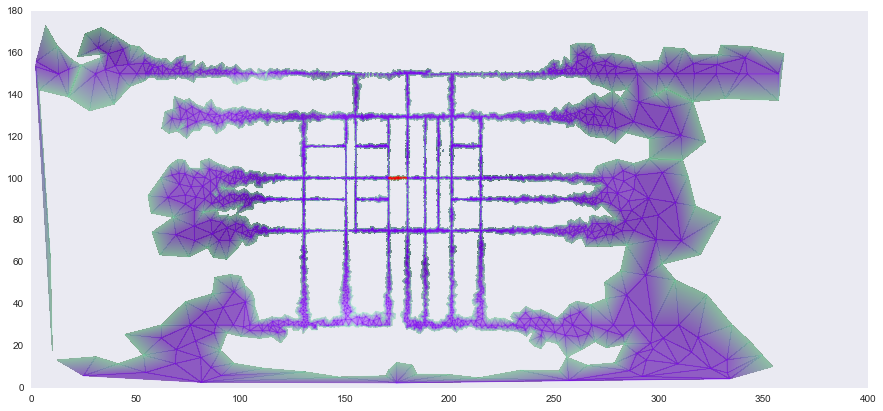

111


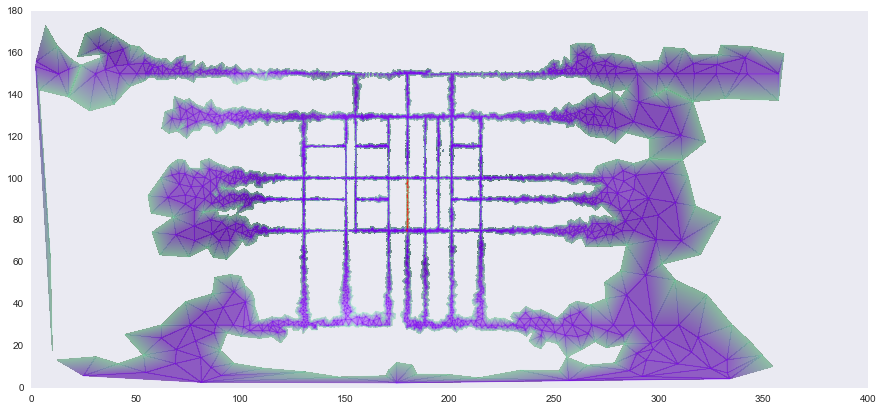

112


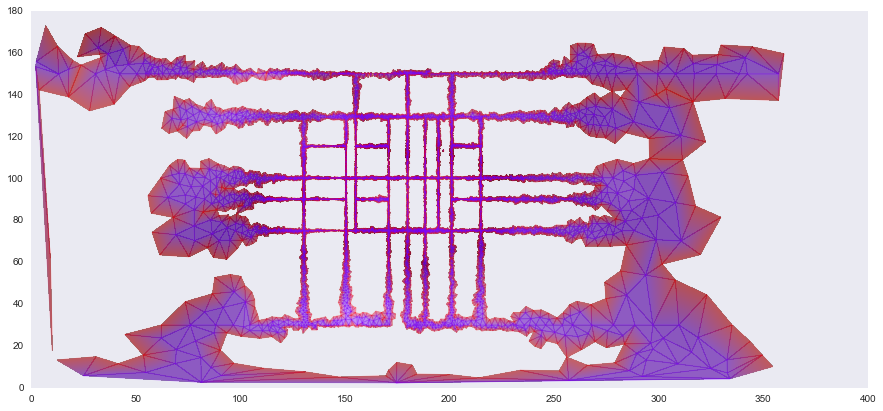

113


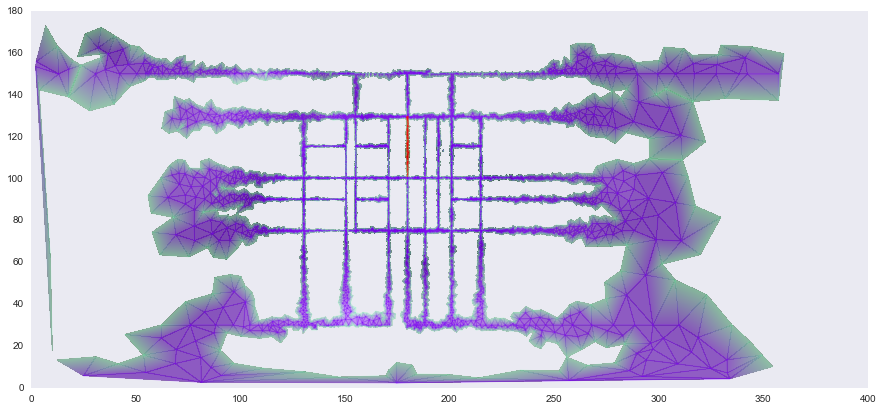

114


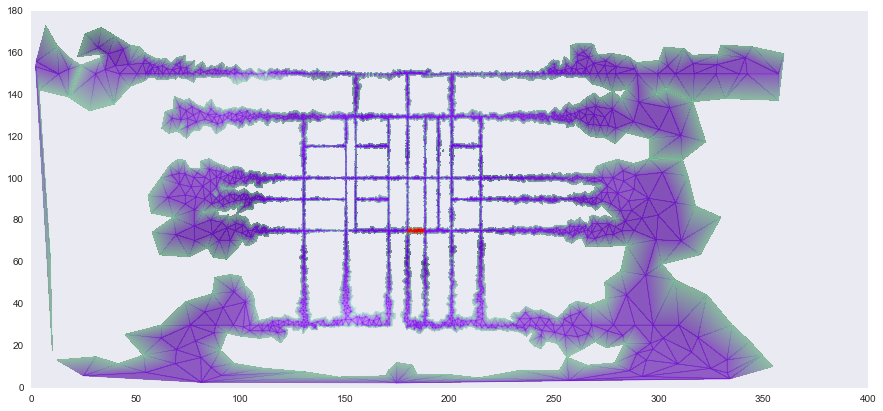

115


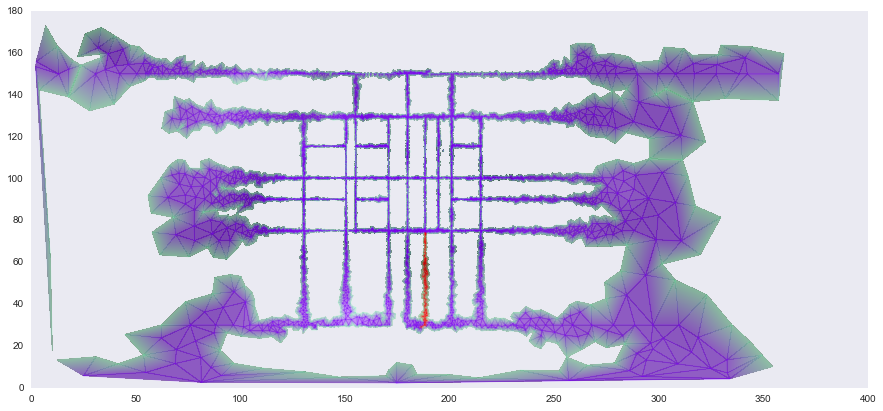

116


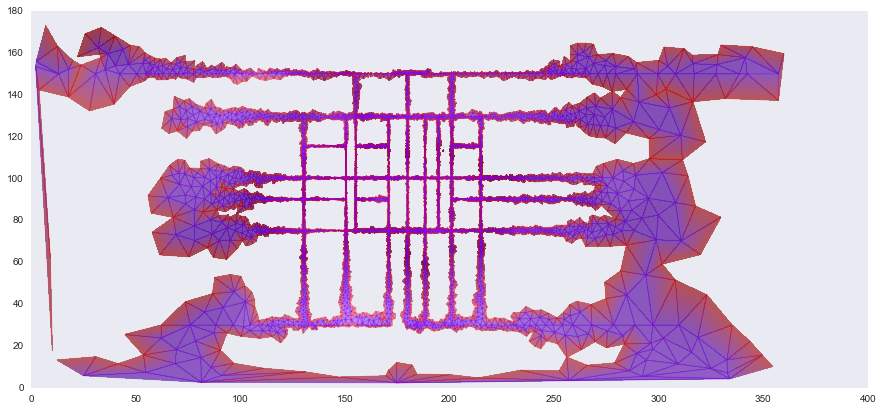

117


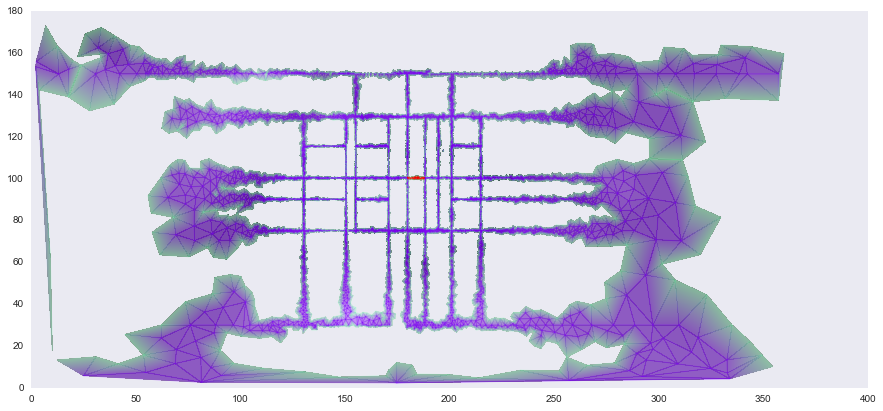

118


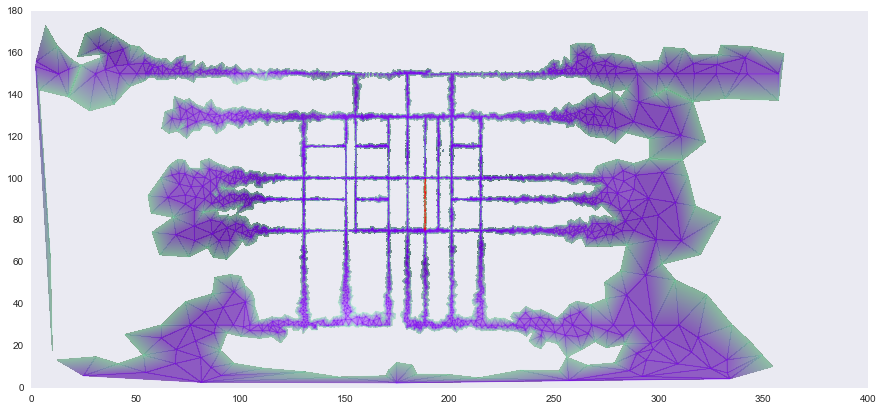

119


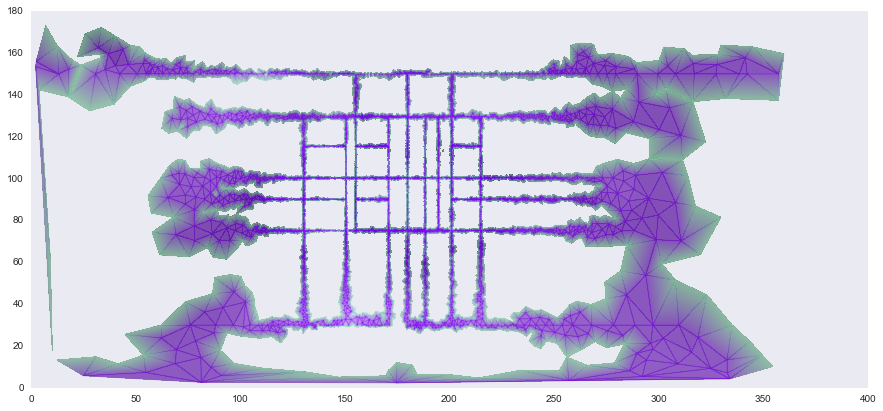

120


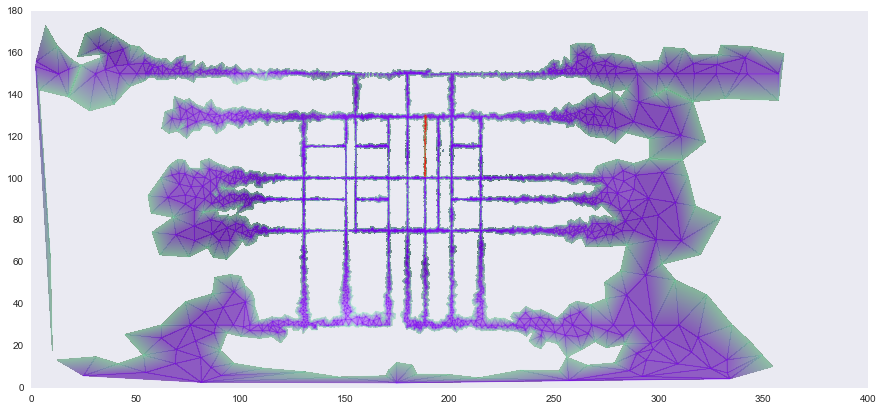

121


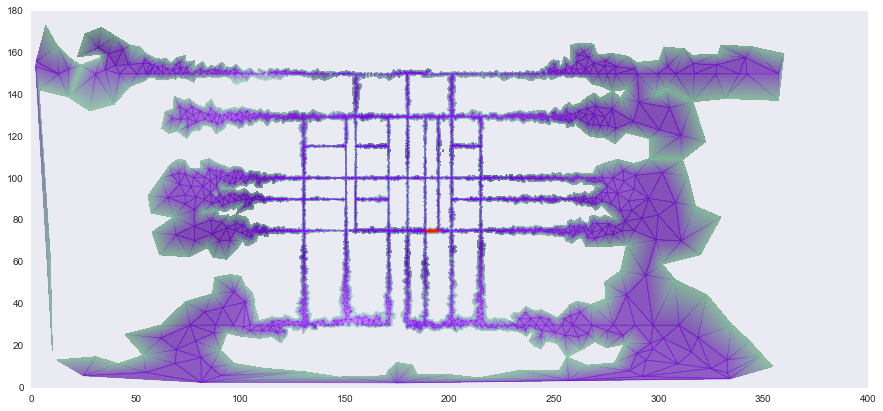

122


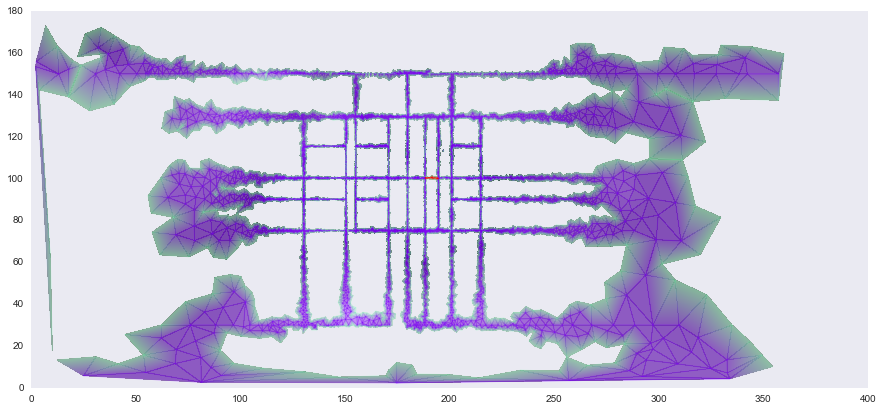

In [156]:
import matplotlib.tri as tri

lonRm = lonR-180
idx = np.where(lonRm < 0)[0]
lonRm[idx] = lonRm[idx] + 360

triang = tri.Triangulation(lonRm, latR)
min_radius = 0.25
xmid = lonRm[triang.triangles].mean(axis=1)
ymid = latR[triang.triangles].mean(axis=1)
mask = np.where(xmid*xmid + ymid*ymid < min_radius*min_radius, 1, 0)
triang.set_mask(mask)

for i in range(len(pathsR)):
    #i = 3
    print i
    cols = np.zeros(len(pathsR)) -1
    cols[i] = 1
    resR, maskNewR = loadstats(cols, pathsR, verticesR, trianglesR)
    #resL, maskNewL = loadstats(s_ratio_a_L, pathsL, verticesL, trianglesL)

    f = plt.figure(figsize=(15,10))
    f.gca().set_aspect('equal')

    plt.tripcolor(triang, sulcR,  cmap = plt.cm.gray, edgecolors='none', alpha = 0.6)

    mask = np.where(resR[triang.triangles].mean(axis=1) == 0, 1, 0)
    triang.set_mask(mask)
    plt.tripcolor(triang, resR, shading='gouraud', cmap = plt.cm.rainbow, edgecolors='none', alpha = 0.4)

    plt.show()
    f.savefig('fig_flat_%s.png' % str(i))

In [89]:
# categorize segments by whether they are along sulci or across gyri

In [88]:
# Try to superimpose embedding under the significant results here. 